<a href="https://colab.research.google.com/github/tomorrownow/FCMAnalysis/blob/master/analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import matplotlib.pyplot as plt; plt.rcdefaults()
import matplotlib.pyplot as plt
import seaborn as sns

import xlrd
import numpy as np
import networkx as nx
import pandas as pd

In [ ]:
!mkdir ./FCMs
!mkdir ./data

In [ ]:
data_location ="./drive/Shared drives/TomorrowNow/Workshop #2 - April 2019/Results/FCM/con_agg"
save_location = "/content/drive/Shared drives/TomorrowNow/Workshop #2 - April 2019/Results/FCM/figures"

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from google.colab import auth
auth.authenticate_user()

In [ ]:
allConcepts = []
for root, dirs, files in os.walk(data_location, topdown=False):
    for name in files:
        if "allFCMs" not in name and name != ".DS_Store":
            fileLocation = os.path.join(root, name)
            df = pd.read_excel(fileLocation)
            concepts = np.delete(df.columns.values, 0)
            group = name.split("_")[1].split(".")[0]
            groupedConcepts = [group].append(concepts)
#             print(list(concepts))
            dic = dict(key=group, value=concepts)
#             print(dic)
            allConcepts.append(dic)
print(len(allConcepts))
print(allConcepts)       

21
[{'key': 'ngo', 'value': array(['rainfall', 'impervious surfaces', 'riparian buffer',
       'land conservation areas', 'flooding',
       'dispersed stormwater practices', 'nutrient loads',
       'population growth', 'urban development', 'water quality',
       'runoff', 'property damage'], dtype=object)}, {'key': 'government', 'value': array(['impervious surfaces', 'weather events', 'traffic',
       'urban development', 'economic development', 'open space',
       'property damage', 'flooding', 'climate change',
       'stormwater infrastructure', 'citizen satisfaction', 'tax base',
       'green infrastructure', 'political climate'], dtype=object)}, {'key': 'government', 'value': array(['flooding', 'rainfall', 'ground water recharge',
       'impervious surfaces', 'canopy', 'floodplain disconnection',
       'water quality', 'runoff', 'macroinvertebrates', 'erosion',
       'stream flow', 'SCMs', 'water temperature'], dtype=object)}, {'key': 'government', 'value': array(['topog

In [ ]:
conceptTable = []
id = 0
for concepts in allConcepts:
    # print("Concepts: {}".format(concepts))   
    groupName = concepts["key"]
    model = concepts["value"]
    for concept in model:
        # print("Concept: {}".format(concept))
        conceptTable.append([id, groupName, concept])
    id+=1

df_concepts = pd.DataFrame(data=conceptTable, columns=["model_id","group","concept"]) 
df_concepts.describe()

,model_id
count,278.000000
mean,10.017986
std,6.073232
min,0.000000
25%,4.000000
50%,10.000000
75%,15.000000
max,20.000000


In [ ]:
# Import Variables from Inductive coding
import gspread
from oauth2client.client import GoogleCredentials
gc = gspread.authorize(GoogleCredentials.get_application_default())
wb = gc.open_by_url('https://docs.google.com/spreadsheets/d/1HBa4zdeW38044pTCgk7J9ix9ktvWlftyZ8dk4yHxFa8/edit#gid=1416274663')
sheet = wb.worksheet('Todd_CoreyMerge')
data = sheet.get_all_values()


In [ ]:
df_grouped_variables = pd.DataFrame(data)
df_grouped_variables.columns = df_grouped_variables.iloc[0]
df_grouped_variables = df_grouped_variables.iloc[1:]
df_grouped_variables.head()

,var,name,group_name,Todd group #,Todd group name,notes,Collab Group_num,Collab_Group_Name,,
1,125,agriculture,agriculture,,,,1,agriculture,,
2,77,algal blooms,algal blooms,,,,2,algal blooms,,
3,151,benthic habitat,stream health,,,,3,benthic habitat,,
4,13,canopy,canopy,,,,4,canopy,,
5,26,citizen satisfaction,citizen satisfaction,,,,5,citizen satisfaction,,


In [ ]:
df_grouped_variables.groupby('Collab_Group_Name')['name'].describe()



,count,unique,top,freq
Collab_Group_Name,,,,
Development Planning and Policies,1,1,development planning and policies,1
Highway commercial development,1,1,highway commercial development,1
Local economy,2,2,local economy,1
Open Space,5,5,open space,1
Open Space Quality,1,1,pervious area quality,1
...,...,...,...,...
water quality,1,1,water quality,1
water temperature,1,1,water temperature,1
water volume,1,1,water volume,1


In [ ]:
concept_map = dict(zip(df_grouped_variables['name'].values, df_grouped_variables['Collab_Group_Name'].values))
print(concept_map)

{'agriculture': 'agriculture', 'algal blooms': 'algal blooms', 'benthic habitat': 'benthic habitat', 'canopy': 'canopy', 'citizen satisfaction': 'citizen satisfaction', 'climate change': 'climate change', 'consistently flooded areas': 'consistently flooded areas', 'cost of private land storage services': 'cost of private land storage services', 'stopping dam release': 'stopping dam release', 'design to limit ecological impacts': 'design to limit ecological impacts', 'development in floodplain': 'development in floodplain', 'changing development ordianances to reduce street widths and otherwise decrease impervious area': 'development restrictions', 'floodplain development restrictions': 'development restrictions', 'SFR zoning': 'development restrictions', 'downcutting': 'downcutting', 'downspout disconnections': 'downspout disconnections', 'downstream impacts': 'downstream impacts', 'drainage infrastructure capacity': 'drainage infrastructure capacity', 'drinking water quality': 'drinki

In [ ]:
df_concepts['code'] = df_concepts['concept'].map(concept_map)

In [ ]:
df_concepts[df_concepts['code'] == 'flooding']

,model_id,group,concept,code
4,0,ngo,flooding,flooding
19,1,government,flooding,flooding
26,2,government,flooding,flooding
81,6,academic,flooding,flooding
92,7,academic,flooding,flooding
116,8,academic,flooding,flooding
127,9,academic,flooding,flooding
145,10,government,flooding,flooding
146,11,government,flooding,flooding
172,13,government,flooding,flooding


In [ ]:
df_concepts.groupby(by=['code', 'concept'])['concept'].count().to_latex(index=True, label="concept_map")

"\\begin{tabular}{llr}\n\\toprule\n                   &                    &  concept \\\\\ncode & concept &          \\\\\n\\midrule\nDevelopment Planning and Policies & development planning and policies &        1 \\\\\nHighway commercial development & highway commercial development &        3 \\\\\nLocal economy & economic development &        1 \\\\\n                   & local economy &        2 \\\\\nOpen Space & land conservation areas &        1 \\\\\n                   & land preservation &        1 \\\\\n                   & open space &        2 \\\\\n                   & pervious area &        1 \\\\\n                   & urban parks/greenspace &        1 \\\\\nOpen Space Quality & pervious area quality &        1 \\\\\nPolitical will & political climate &        1 \\\\\n                   & political will &        3 \\\\\n                   & state government and legislature policy preferences &        1 \\\\\nPrivate land & private land &        1 \\\\\nPublic land & publi

In [ ]:
pd.DataFrame(df_concepts['code'].unique()).to_csv("./data/variableList.csv")

126
flooding                                     16
impervious surfaces                          15
rainfall                                     15
runoff                                       11
Urban development with specific land uses     9
water quality                                 8
retention/detention capacity                  6
climate change                                6
Open Space                                    6
property damage                               6
stream/ecosystem health                       5
erosion                                       5
streamflow                                    5
SCM                                           5
Political will                                5
natural areas                                 4
population                                    4
traffic                                       4
canopy                                        3
Highway commercial development                3
Stormwater Managment Regulations    

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  


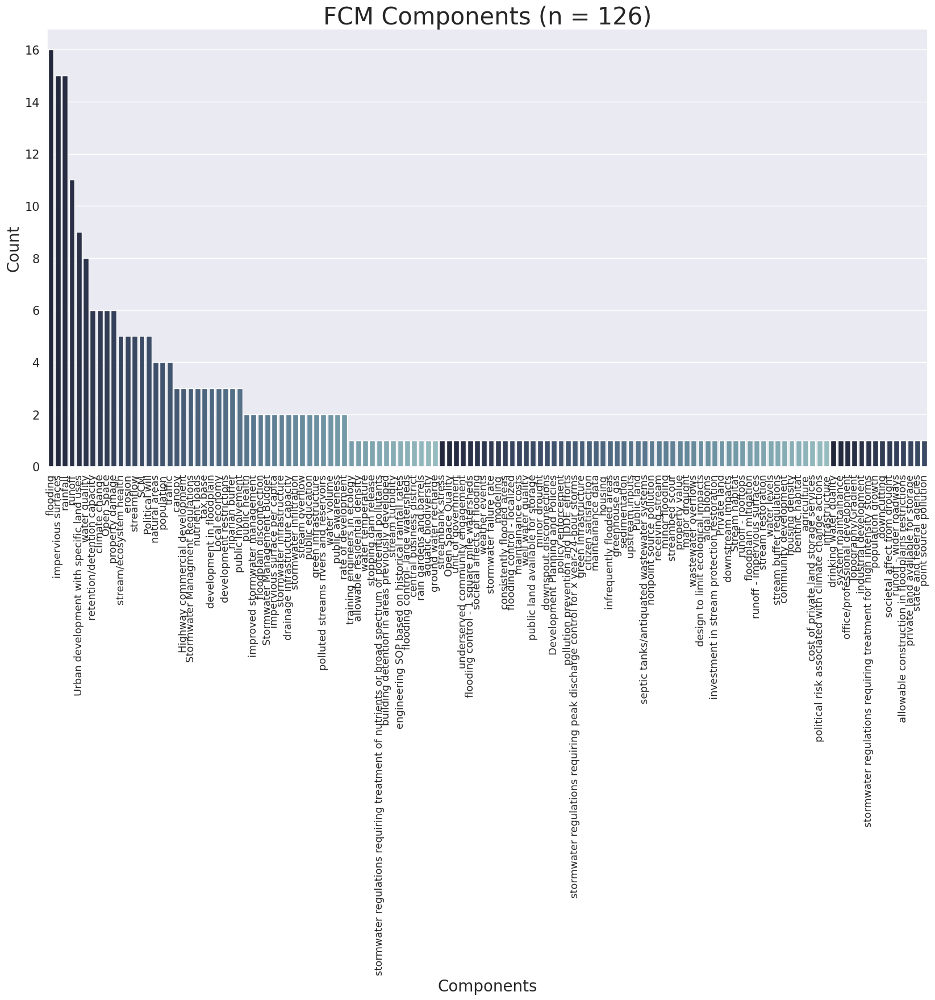

In [ ]:
components_count = len(df_concepts['code'].unique())
print(len(df_concepts['code'].unique()))
print(df_concepts["code"].value_counts().head(25))
fig,ax= plt.subplots(figsize=(20, 10))
# print(df_concepts['concept'].value_counts())
pal = sns.cubehelix_palette(56, rot=-.25, light=.7, reverse=True)
sns.countplot(x="code", data=df_concepts, ax=ax, order = df_concepts['code'].value_counts().index, dodge=False, palette=pal, orient='h')
plt.xticks(rotation=90)
plt.ylabel('Count', size = 20)
plt.xlabel('Components', size = 20)
plt.yticks(size = 15)
plt.xticks(size = 13)
ax.set_title(("FCM Components (n = %d)" % components_count), fontsize=30)
plt.tight_layout()
# sns.countplot(y="concept", col_wrap=5, data=df_concepts, kind="count",height=4, aspect=.7)
plt.savefig(os.path.join(save_location, "FCM Components"),dpi=300)

The mean number of variables in each participants FCM is 13 and follows a normal distribution.

model_id
0    12
1    14
2    13
3    14
4    20
Name: code, dtype: int64
count    21.000000
mean     13.238095
std       3.548306
min       7.000000
25%      11.000000
50%      13.000000
75%      16.000000
max      20.000000
Name: code, dtype: float64


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


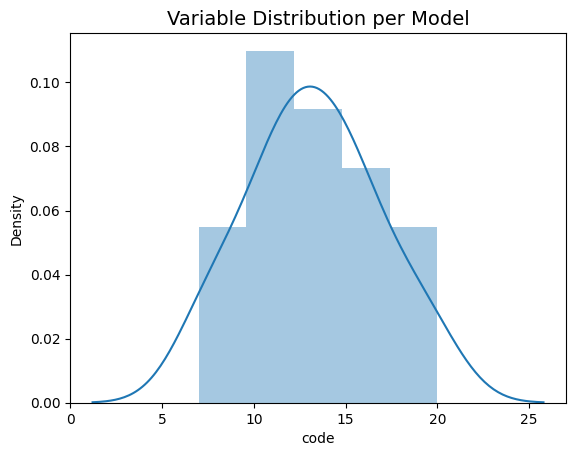

In [ ]:
df_model_counts = df_concepts.groupby('model_id')['code'].count()
print(df_model_counts.head())
print(df_model_counts.describe())
# df_model_counts.avg()
fig, ax = plt.subplots()
ax.set_title(("Variable Distribution per Model"), fontsize=14)
ax.set_xlabel("Number of Variables")
sns.distplot(df_model_counts, ax=ax, bins=5)
plt.savefig(os.path.join(save_location, "Variable Distribution per Model"))

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


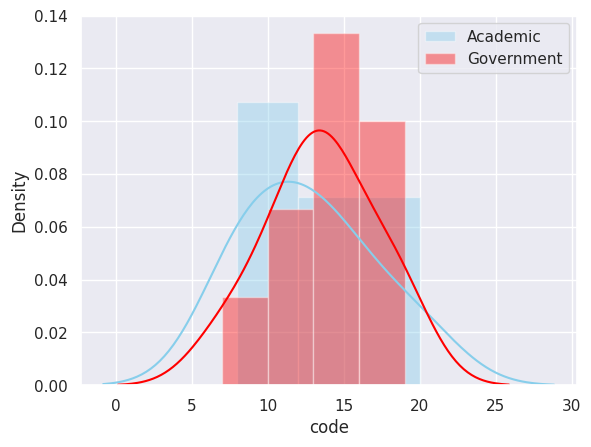

In [ ]:
# libraries & dataset
# import seaborn as sns
# import matplotlib.pyplot as plt
# set a grey background (use sns.set_theme() if seaborn version 0.11.0 or above) 
sns.set(style="darkgrid")

sns.distplot(df_concepts[df_concepts['group'] == "academic"].groupby('model_id')['code'].count(), color="skyblue", label="Academic", kde=True)
sns.distplot(df_concepts[df_concepts['group'] == "government"].groupby('model_id')['code'].count(), color="red", label="Government", kde=True)

plt.legend() 
plt.show()

         group model_id concept  code
                          count count
0     academic        4      20    20
1     academic        5       8     8
2     academic        6      11    11
3     academic        7      16    16
4     academic        8      14    14
5     academic        9       8     8
6     academic       17      12    12
7   government        1      14    14
8   government        2      13    13
9   government        3      14    14
10  government       10      16    16
11  government       11       7     7
12  government       12      10    10
13  government       13      18    18
14  government       15      13    13
15  government       16      19    19
16  government       19      11    11
17    industry       14      15    15
18    industry       20      11    11
19         ngo        0      12    12
20         ngo       18      16    16
        model_id    concept       code
                      count      count
count  21.000000  21.000000  21.000000
mean   10

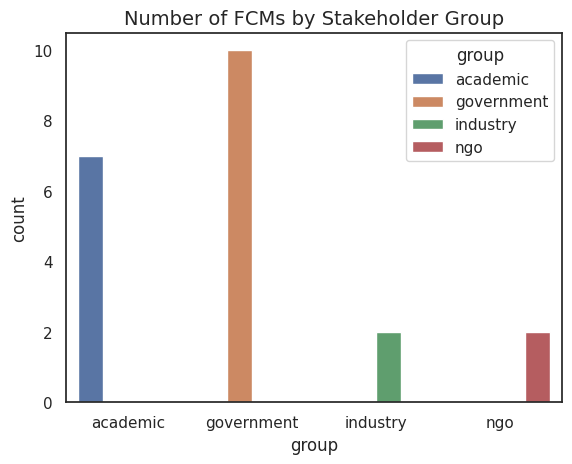

In [ ]:
df_model_counts = df_concepts.groupby(['group', 'model_id']).agg(['count']).reset_index()
# df_model_counts['count'] = df_model_counts['concept'].value_counts()

print(df_model_counts.head(25))
print(df_model_counts.describe())
sns.set(style="white")
fig, ax = plt.subplots()
ax.set_title(("Number of FCMs by Stakeholder Group"), fontsize=14)
ax.set_xlabel("Stakeholder Group")
ax.set_ylabel("Number of FCMs")
# sns.distplot(df_model_counts, ax=ax, bins=5)
sns.countplot(hue="group", x="group", data=df_model_counts,ax=ax)
plt.savefig(os.path.join(save_location, "Number of FCMs by Stakeholder Group"))


An accumlation curve was generated using Monte Carlo techniques to generate 500 possible accumulations of variables to determine if the sample size of maps is large enough to capture the complexity of the model (Özesmi and Özesmi, 2004). The accumulation curve of total variables (Figure 1) shows that the number of new variables added by each map has not yet reached a stable state, and the accumulation curve of new variable shows that the number of new variable captured with each new map is decreasing, but that stakeholders do not share a strong shared vocabulary.

## Function: Accumualtoin_curve

In [ ]:
from sklearn.utils import shuffle
from matplotlib.ticker import MaxNLocator

def fcm_accumualtion_curve(df,ax=None, new_variables=False, n=500):
    """Generate accumulation curve of the number of model variables by using
    a Monte Carlo technique to determine how the variables accumulate.
    
    :param df: DataFrame.
    :param ax: axes object from matplotlib.
    :param new_variables: Deterimes which accumulation curve to generate. False generates the total varibale accumulation curve and True generates the new variables accumulation curve.
    :param n: Number of time to run Monte Carlo simulation.
    :return: ax and plt
    """
    ax = ax or plt.gca()
    
    #Set random seed for shuffling dataframes
    np.random.seed(1)
    
    #DataFrame to store the results of each accumualtion curve
    allDataFrames = pd.DataFrame()
    

    df_models = df.groupby('model_id')['concept'].apply(list).reset_index()
    
    for x in range(n+1):
        #empty set that is used to keep track of which concepts are already counted. It is reset to empty during each iteration
        used_concepts = set()

        def _accumulate(concepts):
            """Determines new concepts and adds them to used_concepts set to keep track
            
            :param concepts: List of model concepts (variables).
            :return: Count of new concepts add from each model.
            """
            new_concepts = 0
            for concept in concepts:
                if concept not in used_concepts:
                    used_concepts.add(concept)
                    new_concepts+=1
            return new_concepts
        
        df_shuffled = shuffle(df_models)
        df_accumulate = df_shuffled['concept'].apply(_accumulate)
        if new_variables:
            df_concept_cum_sum = df_accumulate.reset_index()
        else:
            df_concept_cum_sum = df_accumulate.cumsum(0).reset_index()
            
        #Concat all accumulation curves into a single dataframe to generate the average, min, and max.
        allDataFrames = pd.concat((allDataFrames, df_concept_cum_sum))
    
   
    
    df_mean = allDataFrames.groupby(level=0).mean()
    df_mean['name'] = "Mean"
    df_mean['index_col'] = df_mean.index
    
    df_min=allDataFrames.groupby(level=0).min()
    df_min['name'] = "Envelope"
    df_min['index_col'] = df_min.index
    
    df_max = allDataFrames.groupby(level=0).max()
    df_max['name'] = "Envelope"
    df_max['index_col'] = df_max.index

    
    df_final = pd.concat([df_mean, df_min, df_max])
    
    #Plot the mean and the envelope
    palette = sns.color_palette("mako_r", 2)
    sns.lineplot(
        x="index_col",
        y="concept",
        hue="name",
        style="name",
        markers=True,
        dashes=True, 
        data=df_final,
        palette=palette,
        legend="brief",
        ax=ax)
    
    #Configure plot labels
    plt.suptitle('Accumulation Curves', fontsize=20)
    plt.yticks(size = 14)
    plt.xticks(size = 14) 
    ax.set_xlabel("Number of FCMs", fontsize=14)
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))
    if new_variables:
        ax.set_title(("Number of Unique Components added Per FCM" ), fontsize=16)
        ax.set_ylabel("Unique Components")
    else:
        ax.set_title(("Total Number of Unique Components" ), fontsize=16)
        ax.set_ylabel("Unique Components") 
        
    return ax, plt


## All Stakeholders

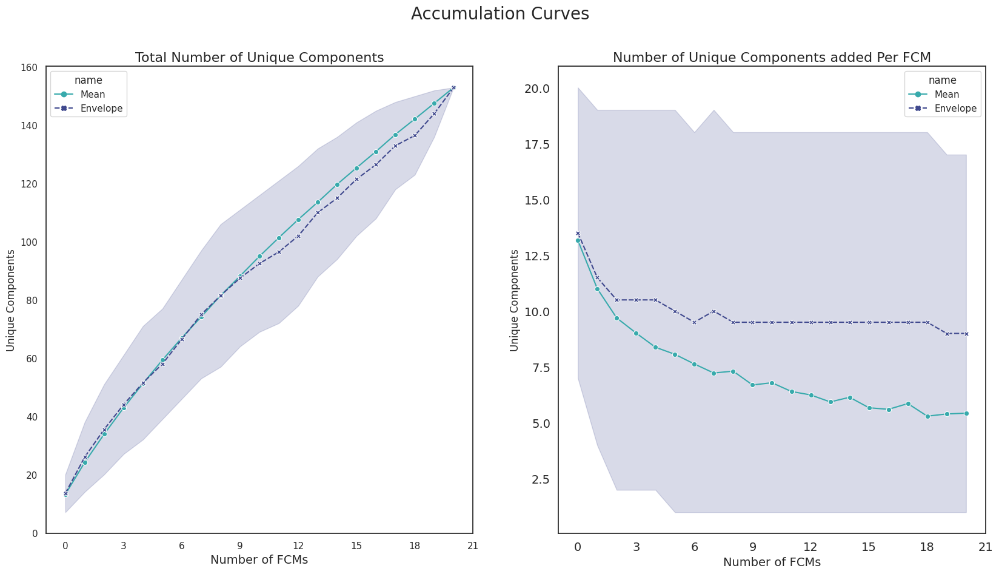

In [ ]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20, 10))
# plt.title('Combined Stakeholders', fontsize=14)
fcm_accumualtion_curve(df_concepts,ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts,ax2,new_variables=True, n= 500)

plt.savefig(os.path.join(save_location, "Accumulation_Curves"), dpi=300)

## Government Stakeholders

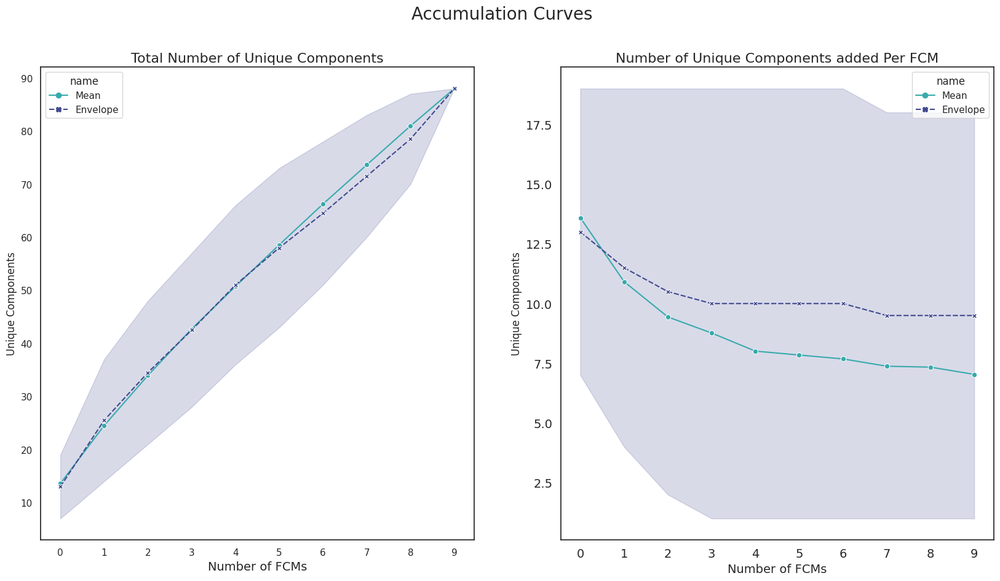

In [ ]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20, 10))
plt.title('Government Stakeholders', fontsize=14)
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "government"],ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "government"],ax2,new_variables=True, n= 500)
plt.savefig(os.path.join(save_location, "Accumulation_Curves_Government"))

## Academic Stakeholders

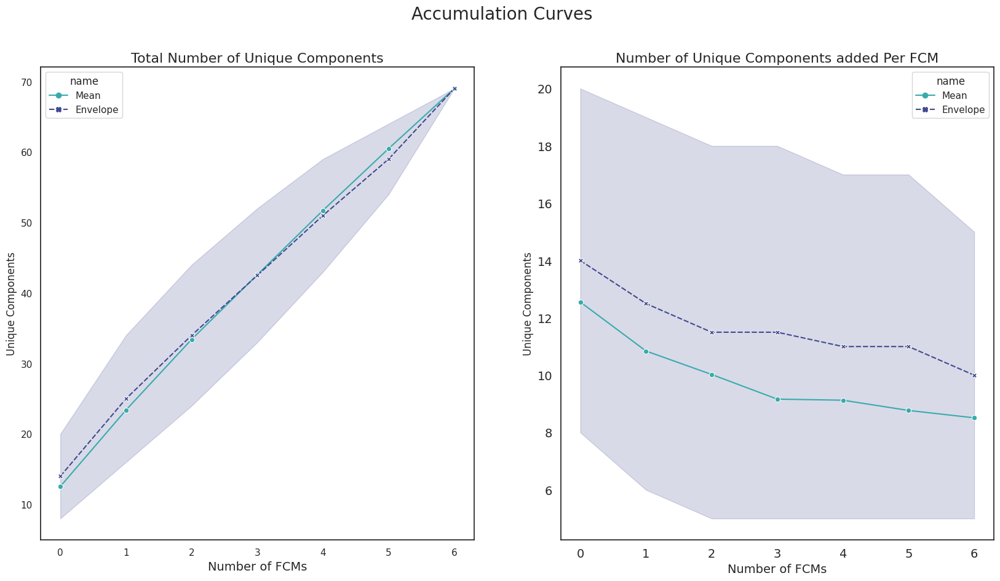

In [ ]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(20, 10))
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "academic"],ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "academic"],ax2,new_variables=True, n= 500)
plt.savefig(os.path.join(save_location, "Accumulation_Curves_Academic"))

## NGO Stakeholders

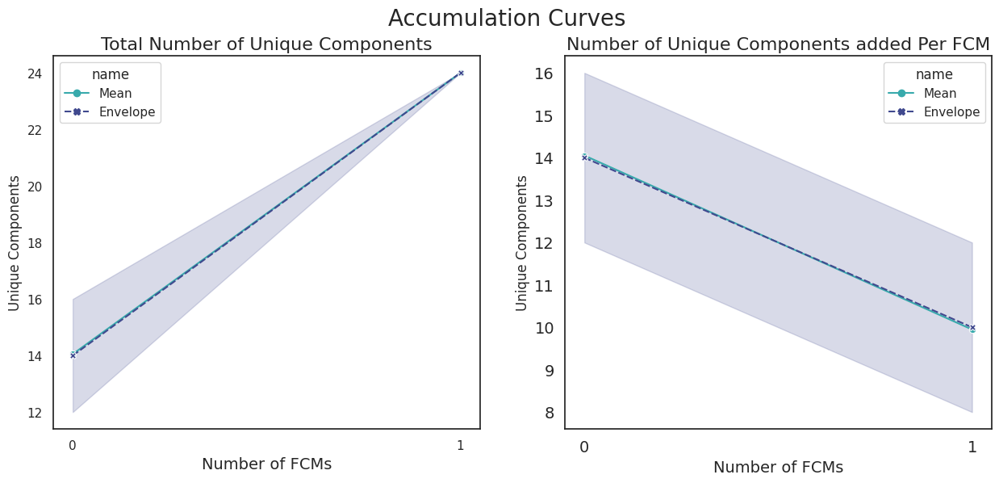

In [ ]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(15, 6))
plt.title('NGO Stakeholders', fontsize=14)
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "ngo"],ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "ngo"],ax2,new_variables=True, n= 500)
plt.savefig(os.path.join(save_location, "Accumulation_Curves_NGO"))

## Industry Stakeholders

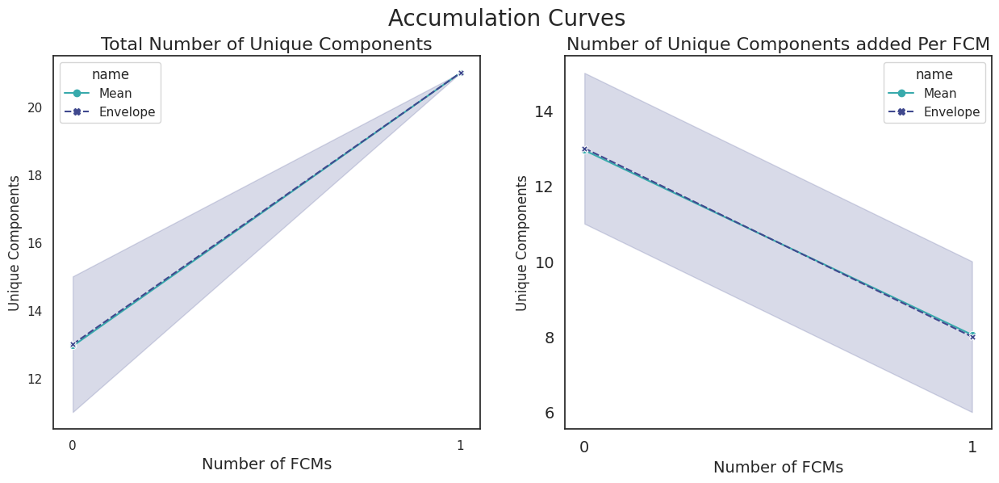

In [ ]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(15, 6))
plt.title('Industry Stakeholders', fontsize=14)
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "industry"],ax1,new_variables=False, n= 500)   
fcm_accumualtion_curve(df_concepts[df_concepts["group"] == "industry"],ax2,new_variables=True, n= 500)
plt.savefig(os.path.join(save_location, "Accumulation_Curves_Industry"))

# Function: Graph_Complexity

In [ ]:
def graph_complexity(r,t):
    """Calculates grapth complexity by returning the ratio of receivers to transmitters. Complex maps have a higher ratio
    define more outcomes and have less forces that contorl the system.
    
    :param r: Receiver.
    :param t: Transmitter.
    :return: Graph complexity as a float.
    """
    complexity = float('NaN')
    try:
        complexity = float(r)/float(t)
    except ZeroDivisionError:
        print("Complexity can not be calculated because the graph has zero transmitters")
    return complexity

        
        
    

# Function: generate_map

In [121]:
total_recievers = []
total_transmitters = []
central_nodes = []
def generate_map(data, columns, ax=None, verbose=False):
    """Generates FMC graph and basic statistics
    
    :param data: np.matrix or numpy.ndarray of graph values
    :param columns: List of column names used to label graph nodes.
    :param ax: Axes object from matplotlib.
    
    :return: Dictionary of graph statistics.
    """
    ax = ax or plt.gca()
    G = nx.DiGraph(data)
    total_edges = G.number_of_edges()
    
    total_nodes = G.number_of_nodes()
  
    transmitters = 0
    receivers = 0
    ordinary = 0
    this_total_recievers = []
    this_total_transmitters = []
    this_central_nodes = []
    this_new_centrality = {"variable": [], "in-degree": [], "out-degree": []}

    for out_node, out_degree in G.out_degree():
        for in_node, in_degree in G.in_degree():
            
            if (in_node == out_node):
                
                #Receiver Varibale
                if (in_degree > 0 and out_degree == 0):
                    receivers+=1
                    total_recievers.append( columns[in_node])
                    this_total_recievers.append( columns[in_node])
                    # print("Node %s is a receiver variable" % columns[in_node])
                #Transmitter Varibale
                elif (out_degree > 0 and in_degree == 0):
                    transmitters+=1
                    total_transmitters.append(columns[in_node])
                    this_total_transmitters.append(columns[in_node])

                    # print("Node %s is a transmitter variable" % columns[in_node])
                else:
                    ordinary+=1

    from operator import add
    # 0 column id
    # 1 row od
    
    this_new_centrality['variable'] = columns
    this_new_centrality['in-degree'] = np.sum(np.abs(data), axis = 0) #.append(in_degree)
    this_new_centrality['out-degree'] = np.sum(np.abs(data), axis=1) #.append(out_degree)
    this_new_centrality['centrality'] = list(map(add, this_new_centrality['in-degree'], this_new_centrality['out-degree']))
    print(G.edges(data=True))
    poseverylarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=0.75]
    poselarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >0.5 and d['weight'] <0.75]
    posesmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <=0.5 and d['weight'] >0.25]
    poseverysmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <=0.25 and d['weight'] > 0]
    
    everyzero=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] == 0]

    negeverylarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <= -0.75]
    negelarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <-0.5 and d['weight'] >-0.75]
    negesmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=-0.5 and d['weight'] <-0.25]
    negeverysmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=-0.25 and d['weight'] < 0]

    #################Centrality#####################################################################
    label= {}
    for nod in G.nodes():
        label[nod] = columns[nod]

    # pos = nx.random_layout(G, dim=2)
    pos=nx.spring_layout(G,dim=2, k=0.5)
    # pos = nx.circular_layout(G)
   


    #########################Visualization##############################################################
    
    nx.draw_networkx(G,pos,labels=label,font_size=24, node_size= 200 ,node_color='lightgrey' ,alpha=0.6)
    nx.draw_networkx_edges(G,pos,edgelist=poseverylarge, width=2,alpha=0.5,edge_color='#6a51a3')
    nx.draw_networkx_edges(G,pos,edgelist=poselarge, width=1.5,alpha=0.5,edge_color='#9e9ac8',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=posesmall, width=1,alpha=0.5,edge_color='#cbc9e2',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=poseverysmall, width=0.25,alpha=0.5,edge_color='#f2f0f7',style='dashed')

    #['#edf8e9','#bae4b3','#74c476','#238b45']
  
    nx.draw_networkx_edges(G,pos,edgelist=negeverylarge, width=2,alpha=0.5,edge_color='#238b45')
    nx.draw_networkx_edges(G,pos,edgelist=negelarge, width=1.5,alpha=0.5,edge_color='#74c476',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=negesmall, width=1,alpha=0.5,edge_color='#bae4b3',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=negeverysmall, width=0.25,alpha=0.5,edge_color='#edf8e9',style='dashed')



#     nx.write_edgelist(G, "aggregated_edg.csv")
    print(pd.DataFrame(np.sum(data, axis = 0) + np.sum(data, axis=1), columns=["centrality"], index=columns).sort_values(by=['centrality'], ascending=False).head(25))
    most_central_node = pd.DataFrame(np.sum(data, axis = 0) + np.sum(data, axis=1), columns=["centrality"], index=columns).sort_values(by=['centrality'], ascending=False).index.tolist()[0]
    central_nodes.append(most_central_node)
    this_central_nodes.append(most_central_node)
    if verbose:
        print("Total Nodes: {}".format(total_nodes))
        print("Total Edges: {}".format(total_edges))
        print("Distance: {}".format(total_edges / total_nodes))
        print("Central Node: {}".format(this_central_nodes))
        print("Transmitter Nodes: {}".format(this_total_transmitters))
        print("Receiver Nodes: {}".format(this_total_recievers))
        print("Clusters: {}".format(nx.clustering(G)))
        print("Degree: {}".format(nx.degree(G)))
        print("Density {}".format(nx.density(G)))

    map_stats = {
        "total_nodes": total_nodes, # Variables (N)
        "total_edges": total_edges, # Connections (C)
        "distance": total_edges / total_nodes, # distance = C/N
        "ordinary": ordinary,
        "receivers": receivers,
        "transmitters":transmitters,
        "total variables": transmitters + receivers + ordinary,
        "receiver_components": this_total_recievers,
        "transmitters_components": this_total_transmitters,
        "central_components": this_central_nodes,
        "weights": [d['weight'] for (u,v,d) in G.edges(data=True)],
        "density": nx.density(G),
        "new_centrality": this_new_centrality
    }
    
        
    if transmitters != 0:
        map_stats["complexity"] = graph_complexity(receivers, transmitters)

        
        map_stats["hierarchy"] = nx.flow_hierarchy(G)

        if verbose:
          print("Complexity {}".format(map_stats["complexity"]))
          print("Hierarchy {}".format(map_stats["hierarchy"]))
    else:
        print("Zero transmitters identified")
    nx.write_gexf(G, "test.gexf")
    return map_stats


# Function: Generate Condensed Map

In [ ]:
total_recievers = []
total_transmitters = []
central_nodes = []
def generate_condensed_map(data, columns, ax=None):
    """Generates FMC graph and basic statistics
    
    :param data: np.matrix or numpy.ndarray of graph values
    :param columns: List of column names used to label graph nodes.
    :param ax: Axes object from matplotlib.
    
    :return: Dictionary of graph statistics.
    """
    ax = ax or plt.gca()
    G = nx.DiGraph(data)
    
    scc = list(nx.strongly_connected_components(G))
    C = nx.condensation(G, scc=scc) 
     
    g_labels = {}
    
    for nod in G.nodes():
      g_labels[nod] = columns[nod]
    G = nx.relabel_nodes(G, g_labels)
    
    # print(G.nodes())
    label= {}
    # original = {}
    weak_nodes = []
    for source_nod, new_nod in C.graph['mapping'].items():
      print("key (source_nod): {}, value (new_nod): {}, label: {}, gLabel: {}".format(source_nod, new_nod, columns[source_nod], g_labels[source_nod]))
      # label[new_nod] = columns[source_nod]
      # original[source_nod] = columns[source_nod]
      if new_nod != 20:
        weak_nodes.append(source_nod)
      else:
        label[source_nod] = columns[source_nod]
    
    weak_nodes = [g_labels[wn] for wn in weak_nodes]
    # weak_nodes = [ for k, v in g_labels.items()]
    print("Weak Nodes: {}".format(weak_nodes))
    G.remove_nodes_from(weak_nodes)
    for (u,v,d) in G.edges(data=True):
      print("u: {}, v: {}, d: {}".format(u,v,d))
      if u in weak_nodes or v in weak_nodes:
        G.remove_edge(u,v)


    # print(G.nodes())
    
    # for c in C.nodes():
    #   print(c)
    # # print(columns)
    print("g_labels: {}".format(g_labels))
    # print("orginal: {}".format(original))
    print("c_labels: {}".format(label))

    transmitters = 0
    receivers = 0
    ordinary = 0
    this_total_recievers = []
    this_total_transmitters = []
    this_central_nodes = []

    for out_node, out_degree in G.out_degree():
        for in_node, in_degree in G.in_degree():
            if (in_node == out_node):
                #Receiver Varibale
                if (in_degree > 0 and out_degree == 0):
                    receivers+=1
                    total_recievers.append( label[in_node])
                    this_total_recievers.append( label[in_node])
                    # print("Node %s is a receiver variable" % columns[in_node])
                #Transmitter Varibale
                elif (out_degree > 0 and in_degree == 0):
                    transmitters+=1
                    total_transmitters.append(label[in_node])
                    this_total_transmitters.append(label[in_node])

                    # print("Node %s is a transmitter variable" % columns[in_node])
                else:
                    ordinary+=1

  
    print(G.edges(data=True))
    poseverylarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=0.75]
    poselarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >0.5 and d['weight'] <0.75]
    posesmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <=0.5 and d['weight'] >0.25]
    poseverysmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <=0.25 and d['weight'] > 0]
    
    everyzero=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] == 0]

    negeverylarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <= -0.75]
    negelarge=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] <-0.5 and d['weight'] >-0.75]
    negesmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=-0.5 and d['weight'] <-0.25]
    negeverysmall=[(u,v) for (u,v,d) in G.edges(data=True) if d['weight'] >=-0.25 and d['weight'] < 0]

    #################Centrality#####################################################################
    
    print(C.graph['mapping'])
    
    
  
    
    # pos = nx.random_layout(G, dim=2)
    pos=nx.spring_layout(G,dim=2, k=0.75)
    # pos = nx.circular_layout(G)
   


    #########################Visualization##############################################################
    
    nx.draw_networkx(G,pos,with_labels=True,font_size=36, node_size= 200 ,node_color='lightgrey' ,alpha=0.6)
    nx.draw_networkx_edges(G,pos,edgelist=poseverylarge, width=2,alpha=0.5,edge_color='#6a51a3')
    nx.draw_networkx_edges(G,pos,edgelist=poselarge, width=1.5,alpha=0.5,edge_color='#9e9ac8',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=posesmall, width=1,alpha=0.5,edge_color='#cbc9e2',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=poseverysmall, width=0.25,alpha=0.5,edge_color='#f2f0f7',style='dashed')

  
    nx.draw_networkx_edges(G,pos,edgelist=negeverylarge, width=2,alpha=0.5,edge_color='#238b45')
    nx.draw_networkx_edges(G,pos,edgelist=negelarge, width=1.5,alpha=0.5,edge_color='#74c476',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=negesmall, width=1,alpha=0.5,edge_color='#bae4b3',style='dashed')
    nx.draw_networkx_edges(G,pos,edgelist=negeverysmall, width=0.25,alpha=0.5,edge_color='#edf8e9',style='dashed')



#     nx.write_edgelist(G, "aggregated_edg.csv")
    print(pd.DataFrame(np.sum(data, axis = 0) + np.sum(data, axis=1), columns=["centrality"], index=columns).sort_values(by=['centrality'], ascending=False).head(25))
    most_central_node = pd.DataFrame(np.sum(data, axis = 0) + np.sum(data, axis=1), columns=["centrality"], index=columns).sort_values(by=['centrality'], ascending=False).index.tolist()[0]
    central_nodes.append(most_central_node)
    this_central_nodes.append(most_central_node)
    print("Central Node: {}".format(this_central_nodes))
    print("Transmitter Nodes: {}".format(this_total_transmitters))
    print("Receiver Nodes: {}".format(this_total_recievers))
    print("Clusters: {}".format(nx.clustering(G)))
    print("Degree: {}".format(nx.degree(G)))
    map_stats = {
        "ordinary": ordinary,
        "receivers": receivers,
        "transmitters":transmitters,
        "total variables": transmitters + receivers + ordinary,
        "receiver_components": this_total_recievers,
        "transmitters_components": this_total_transmitters,
        "central_components": this_central_nodes
    }
    
    map_stats["density"] = nx.density(G)
    print("Density {}".format(map_stats["density"]))
    if transmitters != 0:
        map_stats["complexity"] = graph_complexity(receivers, transmitters)
        print("Complexity {}".format(map_stats["complexity"]))
        map_stats["hierarchy"] = nx.flow_hierarchy(G)
        print("Hierarchy {}".format(map_stats["hierarchy"]))
    else:
        print("Zero transmitters identified")
    # nx.write_gexf(C, "test.gexf")
    return map_stats

# Create Individual FCMS and Confusion Matrix

FCMs 06_ngo.xlsFCM - ngo - 0
(12, 12)
Index(['rainfall', 'impervious surfaces', 'riparian buffer', 'Open Space',
       'flooding', 'SCM', 'nutrient loads', 'population growth',
       'Urban development with specific land uses', 'water quality',
       ...
       'streambed scour', 'benthic habitat', 'downspout disconnections',
       'downcutting', 'green Infrastructure',
       'investment in stream protection restoration', 'property value',
       'stream turbidity', 'water levels', 'stopping dam release'],
      dtype='object', length=126)
[(0, 4, {'weight': 0.5}), (1, 4, {'weight': 0.5}), (1, 6, {'weight': 0.5}), (1, 10, {'weight': 0.55}), (2, 4, {'weight': 0.5}), (2, 6, {'weight': 0.5}), (2, 10, {'weight': 0.51}), (3, 4, {'weight': -0.5}), (4, 11, {'weight': 0.51}), (5, 4, {'weight': -0.5}), (5, 6, {'weight': -0.5}), (5, 10, {'weight': -0.53}), (6, 9, {'weight': -0.5}), (7, 1, {'weight': 0.5}), (8, 1, {'weight': -0.5}), (8, 3, {'weight': -0.5}), (10, 4, {'weight': 0.51}), (10, 6

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


[(0, 4, {'weight': 0.78}), (0, 5, {'weight': 0.76}), (2, 1, {'weight': 0.51}), (3, 4, {'weight': 0.4}), (4, 3, {'weight': 0.4}), (5, 2, {'weight': 0.49}), (5, 4, {'weight': 0.36}), (5, 7, {'weight': 0.71}), (6, 4, {'weight': 0.31}), (7, 6, {'weight': 0.49}), (7, 9, {'weight': 0.56}), (8, 2, {'weight': -0.16}), (8, 5, {'weight': 0.56}), (10, 7, {'weight': -0.71}), (10, 9, {'weight': 0.69})]
                                  centrality
runoff                                  2.88
flooding                                2.25
rainfall                                1.54
water levels                            1.25
streamflow                              1.05
erosion                                 0.84
drainage infrastructure capacity        0.80
stream overflow                         0.80
stream turbidity                        0.51
impervious surfaces                     0.40
stopping dam release                   -0.02


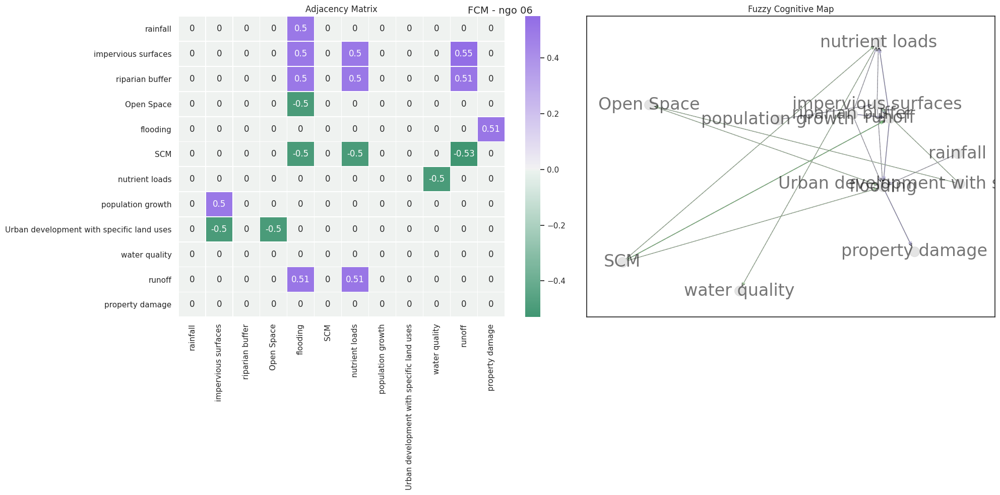

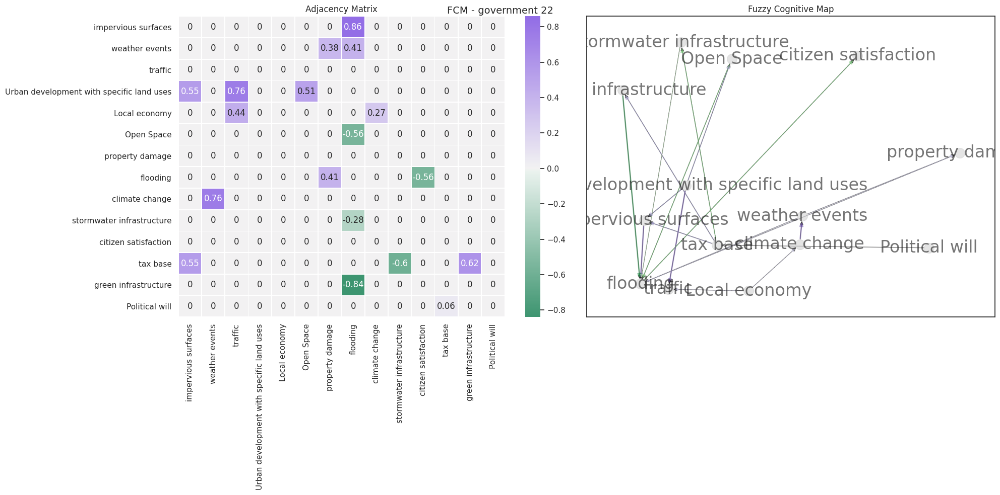

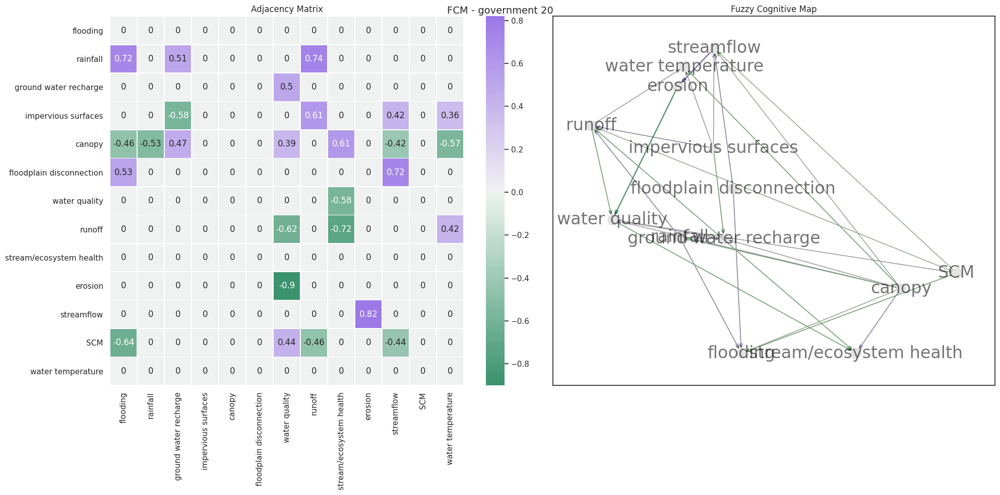

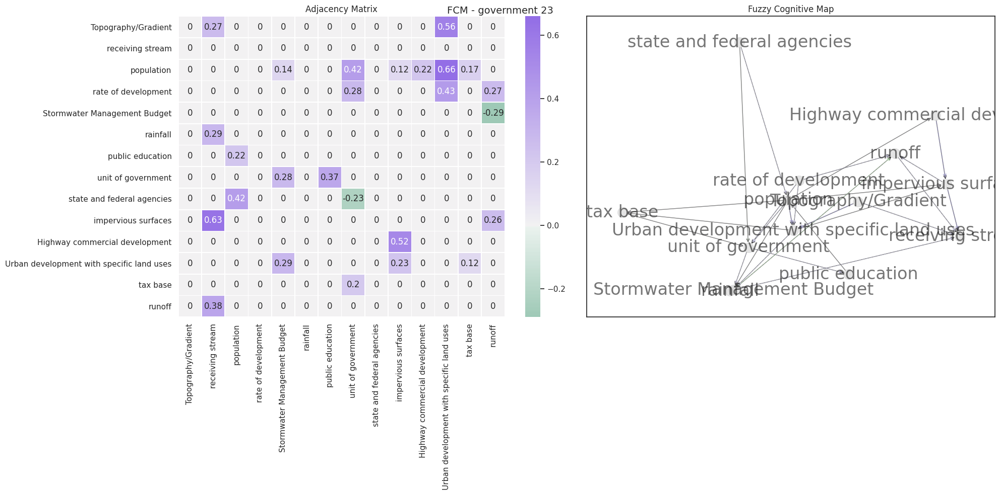

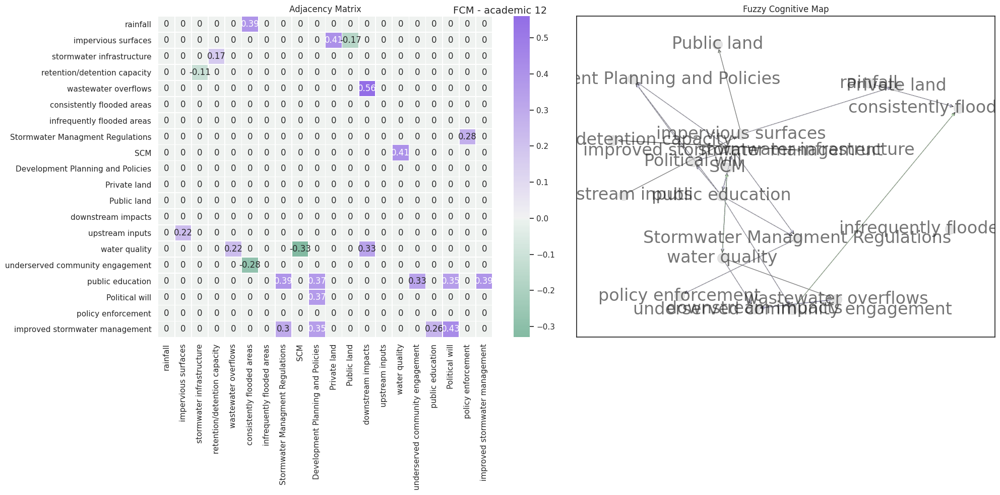

...

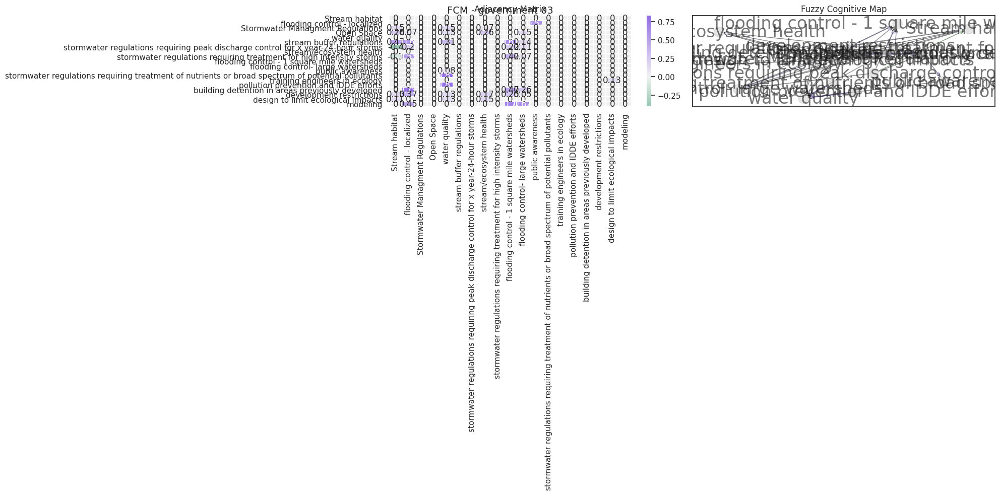

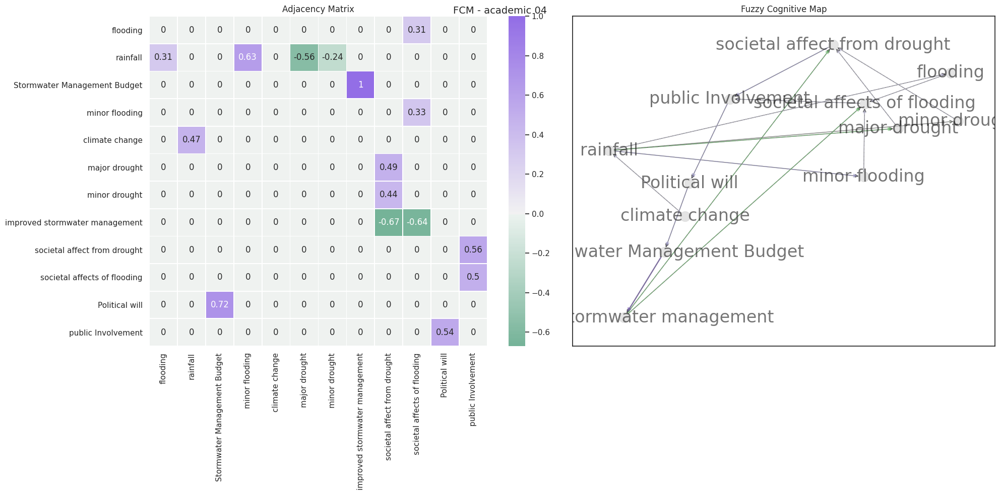

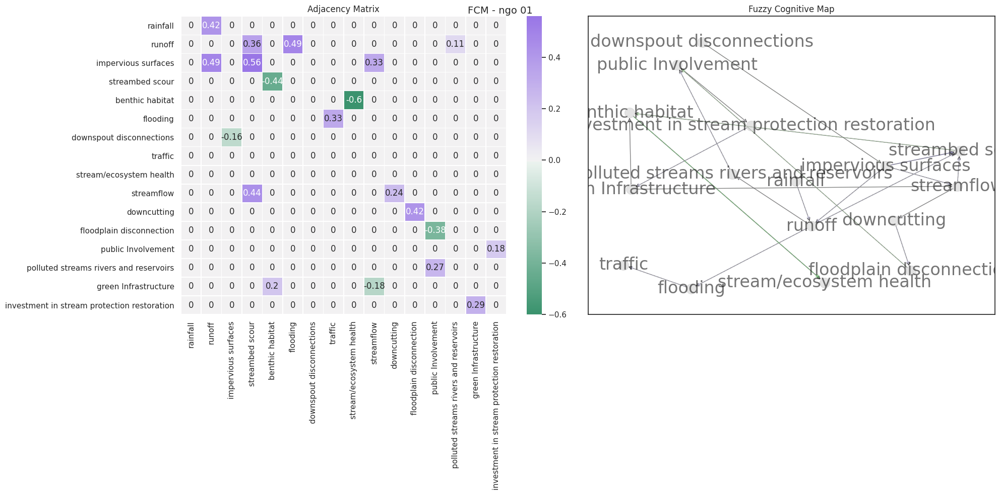

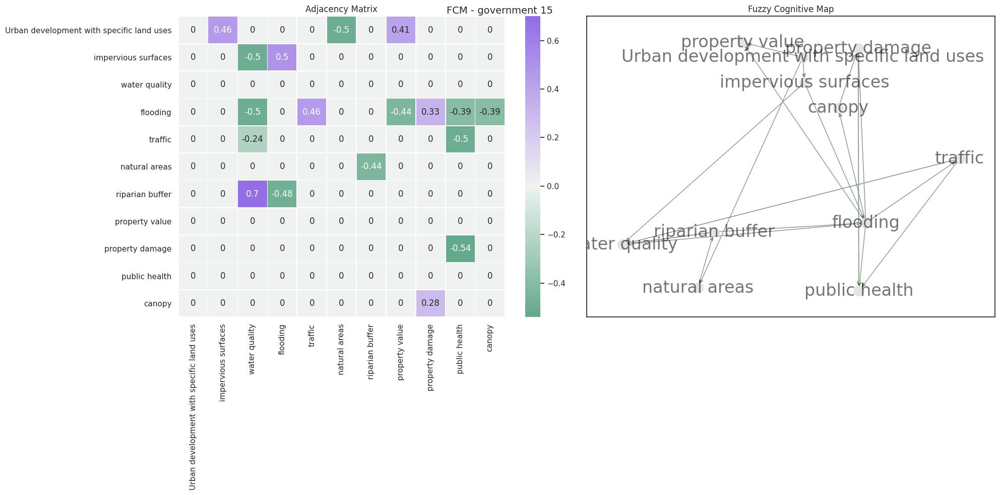

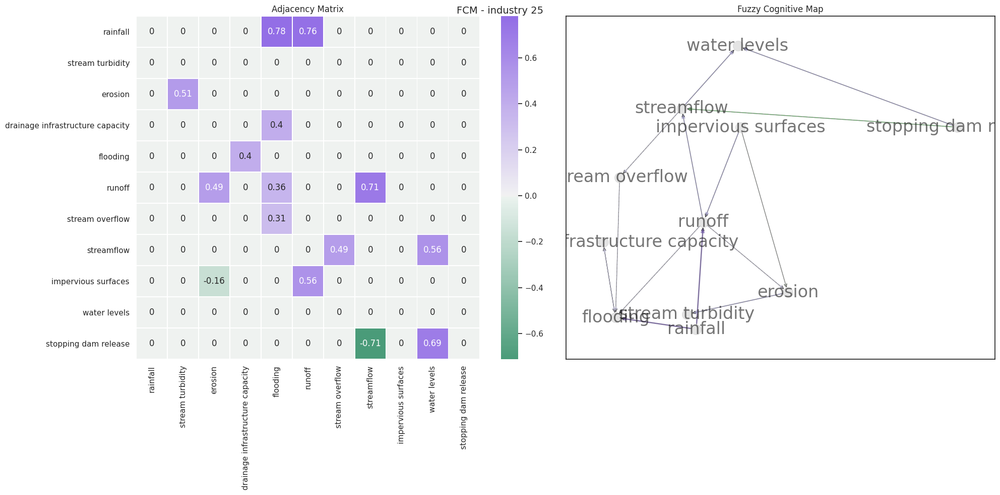

In [ ]:
df_graph_stats_data = []  
cmap = sns.diverging_palette(150, 275, s=80, l=55, n=9, as_cmap=True)
All_ADJs =[]
all_data_frames = pd.DataFrame(columns=df_concepts['code'].unique(), index=df_concepts['code'].unique()).fillna(0)
for root, dirs, files in os.walk(data_location, topdown=False):
    for name in files:
        if "allFCMs" not in name and name != ".DS_Store":
            file_location = os.path.join(root, name)
            participant_organization = name.split("_")[-1].split('.')[0]
            participant_number = name.split("_")[0]
            df = pd.read_excel(file_location,index_col=0).fillna(0)
            
            df.columns = df.columns.map(concept_map)
            df.index = df.index.map(concept_map)
            print("FCMs", "%sFCM - %s - %d" % (name, participant_organization, len(All_ADJs)))
            print(df.shape)
            # print(df.head())
            print(all_data_frames.columns)
            # Take the value if it's not zero
            take_not_zero = lambda s1, s2: s1 if s1.sum() != 0 else s2

            df_copy = all_data_frames.combine(df, take_not_zero, fill_value=0, overwrite=True)
            
            # print(all_data_frames.columns)
            # print(df_copy.columns)
            # Add matric to list
            # All_ADJs.append(df_copy.values)
            All_ADJs.append(df_copy.loc[all_data_frames.columns,all_data_frames.columns].values)


            fig, (ax, ax1) = plt.subplots(1,2,figsize=(20,10))
            plt.suptitle('FCM - %s %s' % (participant_organization, participant_number), fontsize=14)
            ax.set_title("Adjacency Matrix", fontsize=12)

            sns.heatmap(df, annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
            graph_stats = generate_map(df.values, df.columns, ax1)
            ax1.set_title("Fuzzy Cognitive Map", fontsize=12)
            graph_stats['type'] = participant_organization
            plt.tight_layout()
            save_path = os.path.join(save_location, "FCMs", "FCM - %s - %s" % (participant_organization, participant_number))
            plt.savefig(save_path)
            df_graph_stats_data.append(graph_stats)
            
df_graph_stats = pd.DataFrame(df_graph_stats_data)  



## Transmitter Components

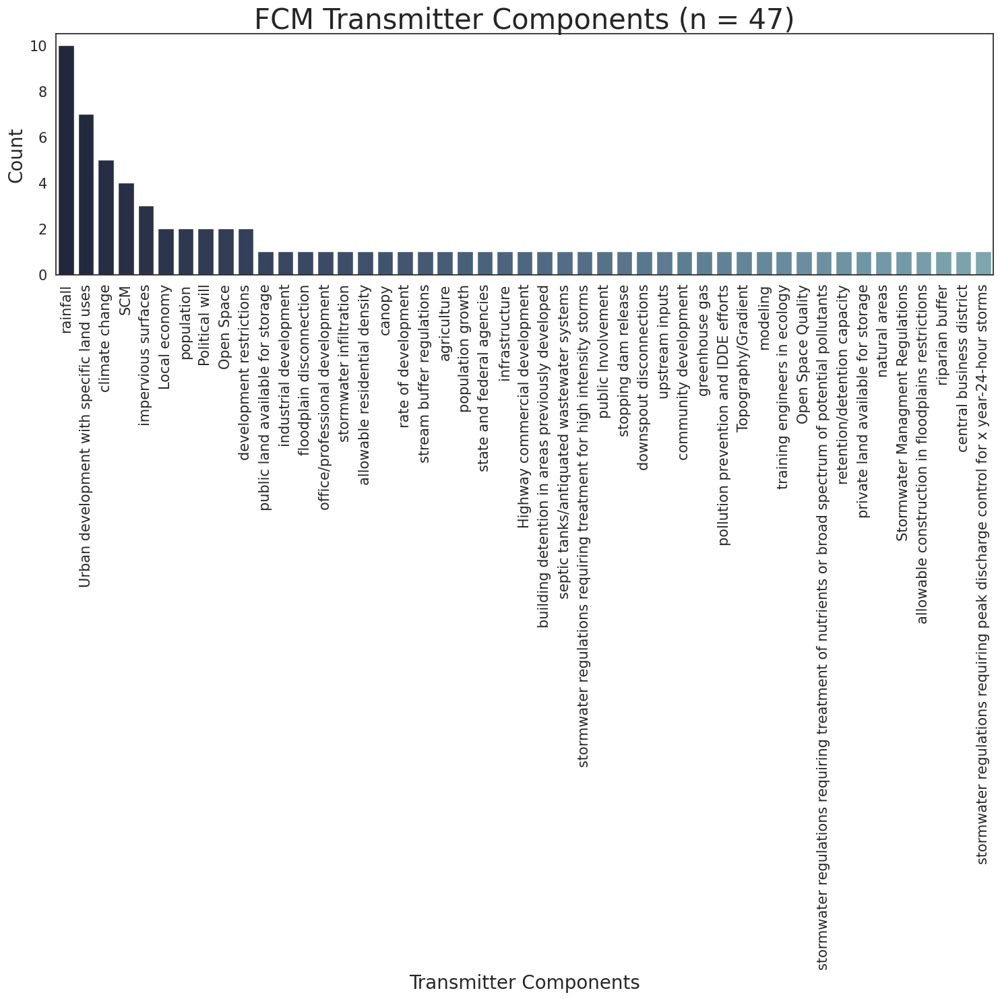

In [ ]:
df_total_transmitters = pd.DataFrame({"transmitters": total_transmitters})
df_total_transmitters['components'] = df_total_transmitters['transmitters'] #.map(concept_map)
components_count = len(df_total_transmitters['components'].unique())
# print(len(df_total_transmitters['components'].unique()))
fig,ax= plt.subplots(figsize=(15, 15))
# print(df_concepts['concept'].value_counts())
pal = sns.cubehelix_palette(56, rot=-.25, light=.7, reverse=True)
sns.countplot(x="components", data=df_total_transmitters, ax=ax, order = df_total_transmitters['components'].value_counts().index, dodge=False, palette=pal, orient='h')
# sns.countplot(x="transmitters", data=df_total_transmitters, ax=ax, order = df_total_transmitters['transmitters'].value_counts().index, dodge=False, palette=pal, orient='h')
plt.xticks(rotation=90)
plt.ylabel('Count', size = 20)
plt.xlabel('Transmitter Components', size = 20)
plt.yticks(size = 15)
plt.xticks(size = 15)
ax.set_title(("FCM Transmitter Components (n = %d)" % components_count), fontsize=30)
plt.tight_layout()

plt.savefig(os.path.join(save_location, "FCM Transmitter Components"))

## Reciever Components

31


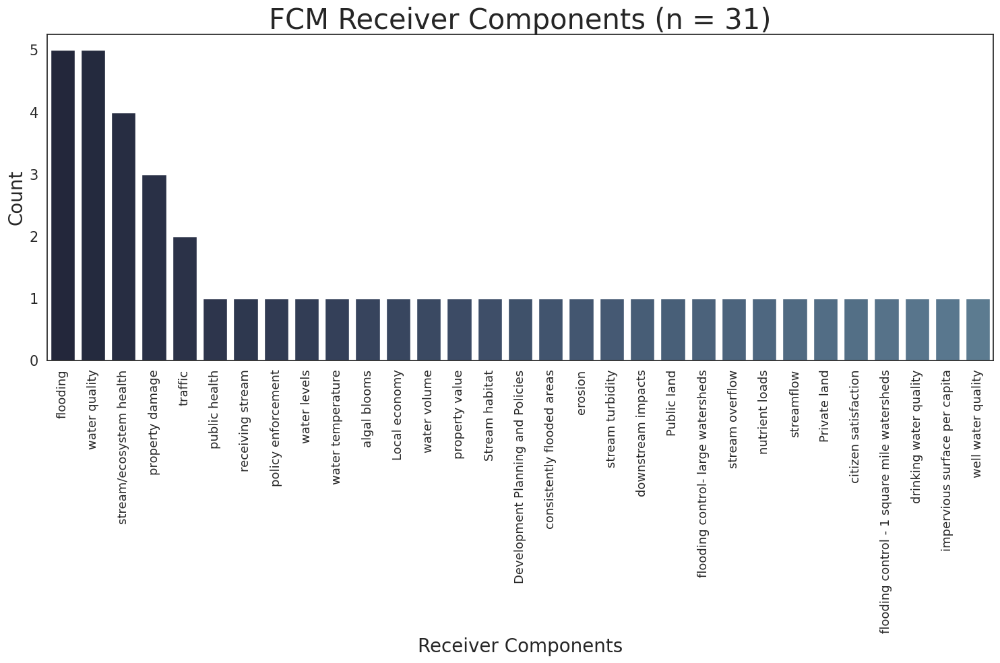

In [ ]:
df_total_receivers = pd.DataFrame({"receivers": total_recievers})
df_total_receivers['components'] = df_total_receivers['receivers'] #.map(concept_map)
components_count = len(df_total_receivers['components'].unique())
print(len(df_total_receivers['components'].unique()))
fig,ax= plt.subplots(figsize=(15, 10))
# print(df_concepts['concept'].value_counts())
pal = sns.cubehelix_palette(56, rot=-.25, light=.7, reverse=True)
sns.countplot(x="components", data=df_total_receivers, ax=ax, order = df_total_receivers['components'].value_counts().index, dodge=False, palette=pal, orient='h')
plt.xticks(rotation=90)
plt.ylabel('Count', size = 20)
plt.xlabel('Receiver Components', size = 20)
plt.yticks(size = 15)
plt.xticks(size = 13)
ax.set_title(("FCM Receiver Components (n = %d)" % components_count), fontsize=30)
plt.tight_layout()
# sns.countplot(y="concept", col_wrap=5, data=df_concepts, kind="count",height=4, aspect=.7)
plt.savefig(os.path.join(save_location, "FCM Receiver Components"))

## Central Components

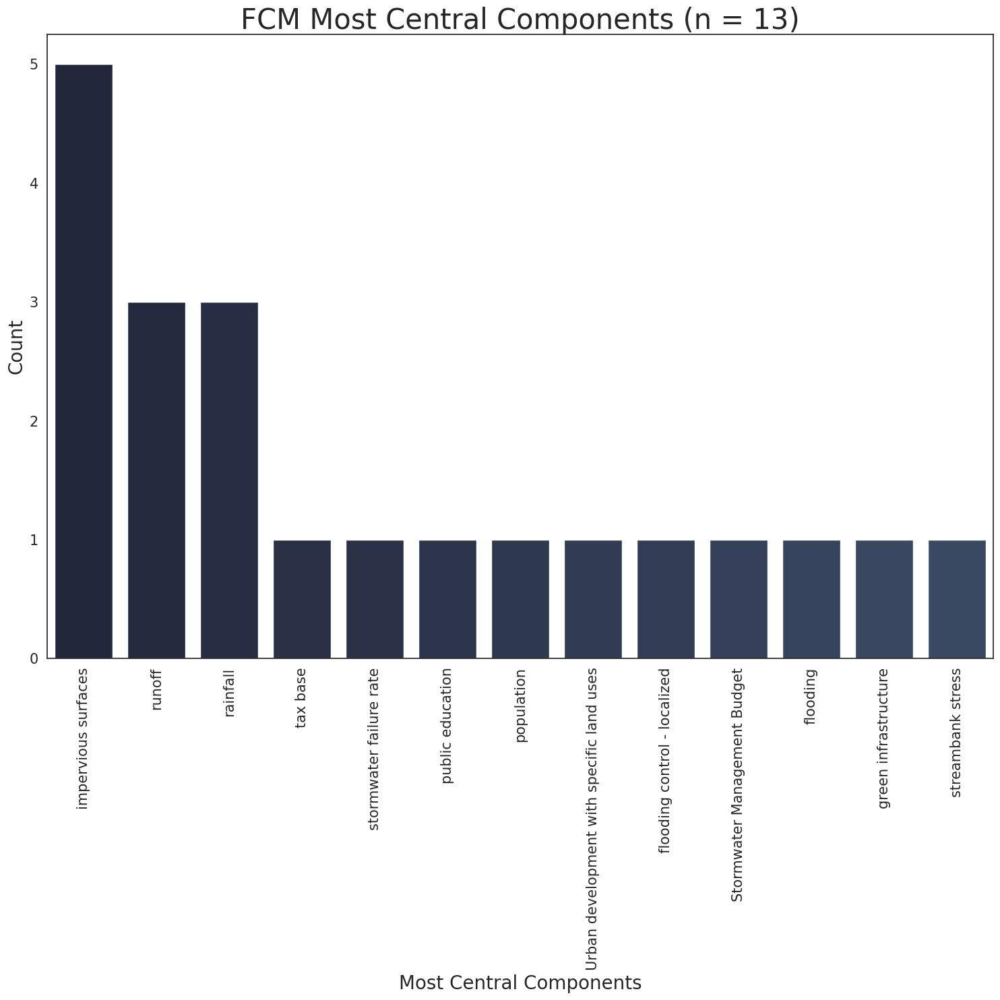

In [ ]:

df_most_central = pd.DataFrame({"components": central_nodes})
df_most_central.head(2000)
df_most_central['components'] = df_most_central['components'] #.map(concept_map)
components_count = len(df_most_central['components'].unique())
# print(len(df_total_transmitters['components'].unique()))
fig,ax= plt.subplots(figsize=(15, 15))
# print(df_concepts['concept'].value_counts())
pal = sns.cubehelix_palette(56, rot=-.25, light=.7, reverse=True)
sns.countplot(x="components", data=df_most_central, ax=ax, order = df_most_central['components'].value_counts().index, dodge=False, palette=pal, orient='h')
# sns.countplot(x="transmitters", data=df_total_transmitters, ax=ax, order = df_total_transmitters['transmitters'].value_counts().index, dodge=False, palette=pal, orient='h')
plt.xticks(rotation=90)
plt.ylabel('Count', size = 20)
plt.xlabel('Most Central Components', size = 20)
plt.yticks(size = 15)
plt.xticks(size = 15)
ax.set_title(("FCM Most Central Components (n = %d)" % components_count), fontsize=30)
plt.tight_layout()
# sns.countplot(y="concept", col_wrap=5, data=df_concepts, kind="count",height=4, aspect=.7)
plt.savefig(os.path.join(save_location, "FCM Central Components"))

## Pair Grid of Graph indices by Stakeholder Group

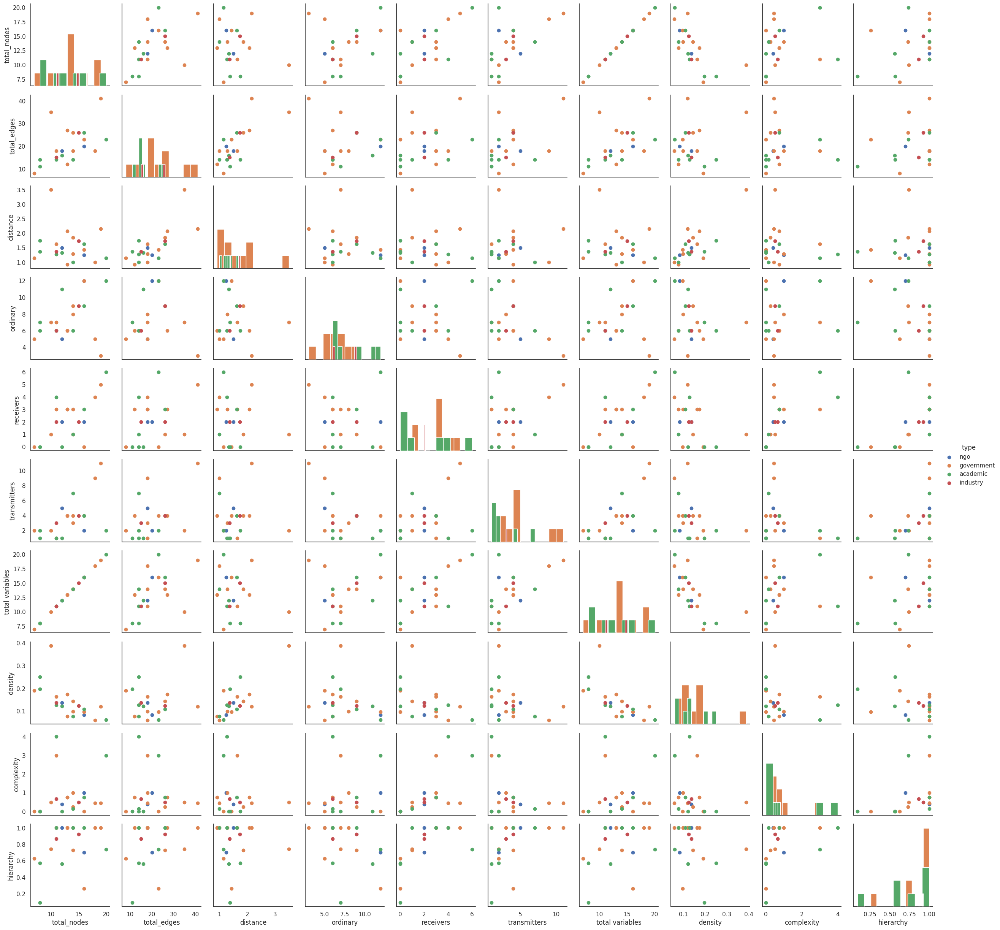

In [ ]:
g = sns.PairGrid(df_graph_stats, hue="type")
g = g.map_diag(plt.hist)
g = g.map_offdiag(plt.scatter)
# g = g.map_diag(sns.kdeplot, lw=3, legend=False)
g = g.add_legend()

### How do different stakeholder models compare to each other?

1. Total Variables

          type  variable  value
0          ngo  ordinary    5.0
1   government  ordinary    8.0
2   government  ordinary    6.0
3   government  ordinary    9.0
4     academic  ordinary   12.0
5     academic  ordinary    6.0
6     academic  ordinary    6.0
7     academic  ordinary    9.0
8     academic  ordinary    6.0
9     academic  ordinary    7.0
10  government  ordinary   12.0
11  government  ordinary    5.0
12  government  ordinary    7.0
13  government  ordinary    5.0
14    industry  ordinary    9.0
15  government  ordinary    6.0
16  government  ordinary    3.0
17    academic  ordinary   11.0
18         ngo  ordinary   12.0
19  government  ordinary    7.0


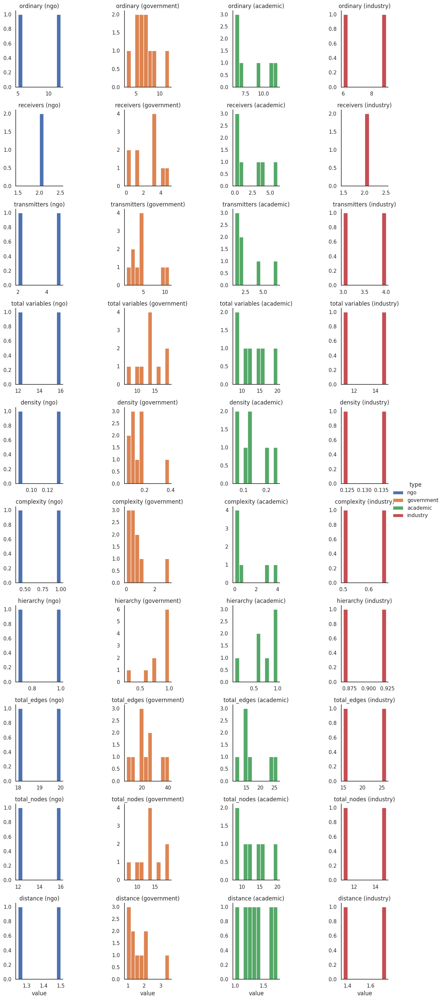

In [ ]:
df_graph_stats_tp = df_graph_stats.copy().melt(id_vars=['type'], value_vars=['ordinary', 'receivers', 'transmitters','total variables', 'density', 'complexity', 'hierarchy','total_edges', 'total_nodes', 'distance'])
print(df_graph_stats_tp.head(20))
df_graph_stats_tp['log'] = df_graph_stats_tp['value']
g= sns.FacetGrid(df_graph_stats_tp, col="type", row="variable",sharey=False, sharex=False, hue="type")
g = g.map(plt.hist, "value").set_titles("{row_name} ({col_name})").add_legend()

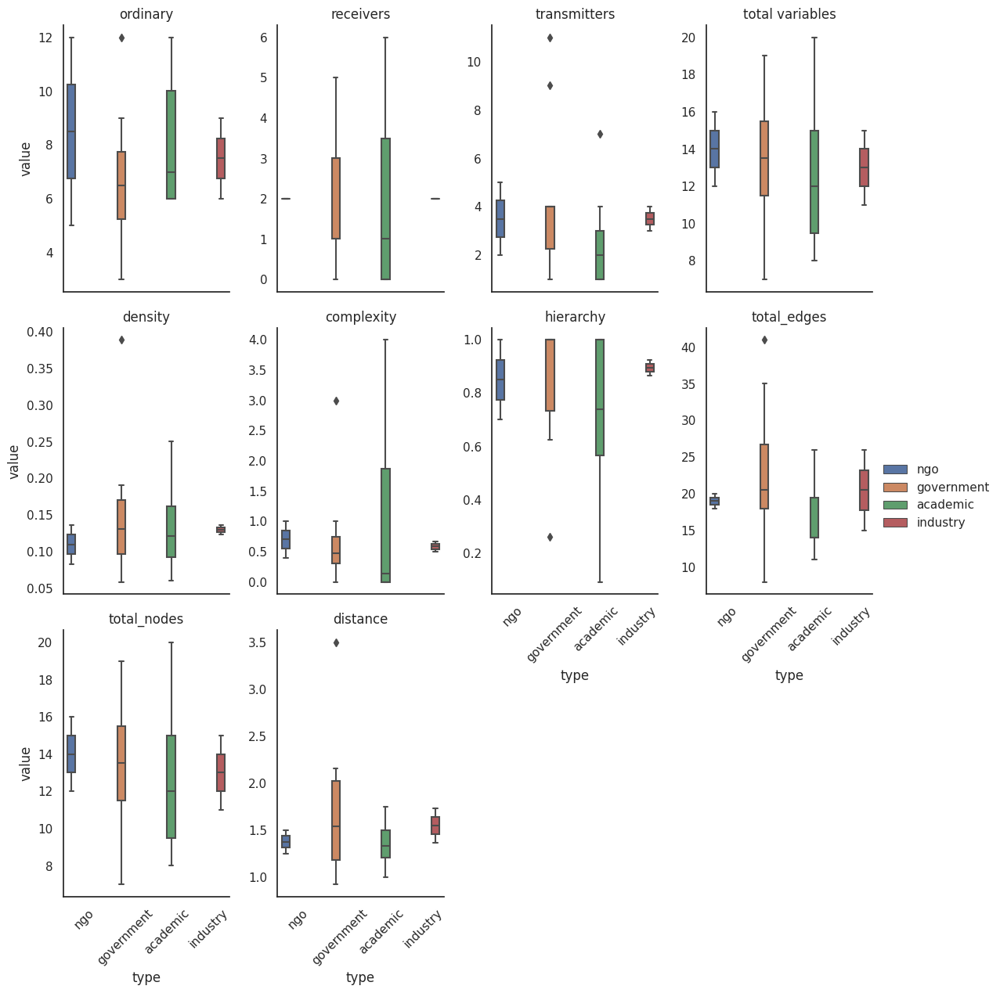

In [ ]:
g = sns.catplot(x="type", y="value",
                hue="type", col="variable",
                data=df_graph_stats_tp, kind="box", orient="v",
                height=4, aspect=.7,sharey=False,col_wrap=4,).add_legend().set_titles("{col_name}")
g.set_xticklabels(labels=df_graph_stats_tp['type'].unique(), rotation=45)
plt.savefig(os.path.join(save_location, "FCM Statistics by Stakeholder Group"), orientation="landscape")

In [ ]:
df_graph_stats_tp.groupby(["variable"])['value'].describe()

,count,mean,std,min,25%,50%,75%,max
variable,,,,,,,,
complexity,21.0,0.838501,1.107119,0.000000,0.142857,0.500000,0.750000,4.000000
density,21.0,0.139517,0.074619,0.058824,0.095833,0.123810,0.163636,0.388889
distance,21.0,1.541453,0.562013,0.923077,1.250000,1.375000,1.733333,3.500000
hierarchy,21.0,0.800629,0.262116,0.090909,0.700000,0.923077,1.000000,1.000000
ordinary,21.0,7.476190,2.581067,3.000000,6.000000,7.000000,9.000000,12.000000
receivers,21.0,2.142857,1.740279,0.000000,1.000000,2.000000,3.000000,6.000000
total variables,21.0,13.238095,3.548306,7.000000,11.000000,13.000000,16.000000,20.000000
total_edges,21.0,20.142857,8.045407,8.000000,14.000000,18.000000,26.000000,41.000000
total_nodes,21.0,13.238095,3.548306,7.000000,11.000000,13.000000,16.000000,20.000000


In [ ]:
df_graph_stats_tp.groupby(["variable"])['value'].skew()

variable
complexity         1.955996
density            2.040184
distance           2.238668
hierarchy         -1.430374
ordinary           0.570129
receivers          0.450652
total variables    0.095067
total_edges        0.985643
total_nodes        0.095067
transmitters       1.526867
Name: value, dtype: float64

In [ ]:
df_graph_stats_tp.groupby(["type","variable"])['value'].describe()

count       mean  ...        75%        max
type       variable                           ...                      
academic   complexity         7.0   1.127551  ...   1.875000   4.000000
           density            7.0   0.134385  ...   0.161851   0.250000
           distance           7.0   1.358009  ...   1.500000   1.750000
           hierarchy          7.0   0.709138  ...   1.000000   1.000000
           ordinary           7.0   8.142857  ...  10.000000  12.000000
           receivers          7.0   2.000000  ...   3.500000   6.000000
           total variables    7.0  12.714286  ...  15.000000  20.000000
           total_edges        7.0  16.857143  ...  19.500000  26.000000
           total_nodes        7.0  12.714286  ...  15.000000  20.000000
           transmitters       7.0   2.571429  ...   3.000000   7.000000
government complexity        10.0   0.714899  ...   0.750000   3.000000
           density           10.0   0.150930  ...   0.170717   0.388889
           distance          10.0   1.701747  ...   2.021978   3.500000
           hierarchy         10.0   0.835950  ...   1.000000   1.000000
           ordinary          10.0   6.800000  ...   7.750000  12.000000
           receivers         10.0   2.300000  ...   3.000000   5.000000
           total variables   10.0  13.500000  ...  15.500000  19.000000
           total_edges       10.0  22.600000  ...  26.750000  41.000000
           total_nodes       10.0  13.500000  ...  15.500000  19.000000
           transmitters      10.0   4.400000  ...   4.000000  11.000000
industry   complexity         2.0   0.583333  ...   0.625000   0.666667
           density            2.0   0.130087  ...   0.133225   0.136364
           distance           2.0   1.548485  ...   1.640909   1.733333
           hierarchy          2.0   0.894872  ...   0.908974   0.923077
           ordinary           2.0   7.500000  ...   8.250000   9.000000
           receivers          2.0   2.000000  ...   2.000000   2.000000
           total variables    2.0  13.000000  ...  14.000000  15.000000
           total_edges        2.0  20.500000  ...  23.250000  26.000000
           total_nodes        2.0  13.000000  ...  14.000000  15.000000
           transmitters       2.0   3.500000  ...   3.750000   4.000000
ngo        complexity         2.0   0.700000  ...   0.850000   1.000000
           density            2.0   0.109848  ...   0.123106   0.136364
           distance           2.0   1.375000  ...   1.437500   1.500000
           hierarchy          2.0   0.850000  ...   0.925000   1.000000
           ordinary           2.0   8.500000  ...  10.250000  12.000000
           receivers          2.0   2.000000  ...   2.000000   2.000000
           total variables    2.0  14.000000  ...  15.000000  16.000000
           total_edges        2.0  19.000000  ...  19.500000  20.000000
           total_nodes        2.0  14.000000  ...  15.000000  16.000000
           transmitters       2.0   3.500000  ...   4.250000   5.000000

[40 rows x 8 columns]

In [ ]:
df_graph_stats_tp.groupby(["type","variable"]).describe()

value             ...        log           
                           count       mean  ...        75%        max
type       variable                          ...                      
academic   complexity        7.0   1.127551  ...   1.875000   4.000000
           density           7.0   0.134385  ...   0.161851   0.250000
           distance          7.0   1.358009  ...   1.500000   1.750000
           hierarchy         7.0   0.709138  ...   1.000000   1.000000
           ordinary          7.0   8.142857  ...  10.000000  12.000000
           receivers         7.0   2.000000  ...   3.500000   6.000000
           total variables   7.0  12.714286  ...  15.000000  20.000000
           total_edges       7.0  16.857143  ...  19.500000  26.000000
           total_nodes       7.0  12.714286  ...  15.000000  20.000000
           transmitters      7.0   2.571429  ...   3.000000   7.000000
government complexity       10.0   0.714899  ...   0.750000   3.000000
           density          10.0   0.150930  ...   0.170717   0.388889
           distance         10.0   1.701747  ...   2.021978   3.500000
           hierarchy        10.0   0.835950  ...   1.000000   1.000000
           ordinary         10.0   6.800000  ...   7.750000  12.000000
           receivers        10.0   2.300000  ...   3.000000   5.000000
           total variables  10.0  13.500000  ...  15.500000  19.000000
           total_edges      10.0  22.600000  ...  26.750000  41.000000
           total_nodes      10.0  13.500000  ...  15.500000  19.000000
           transmitters     10.0   4.400000  ...   4.000000  11.000000
industry   complexity        2.0   0.583333  ...   0.625000   0.666667
           density           2.0   0.130087  ...   0.133225   0.136364
           distance          2.0   1.548485  ...   1.640909   1.733333
           hierarchy         2.0   0.894872  ...   0.908974   0.923077
           ordinary          2.0   7.500000  ...   8.250000   9.000000
           receivers         2.0   2.000000  ...   2.000000   2.000000
           total variables   2.0  13.000000  ...  14.000000  15.000000
           total_edges       2.0  20.500000  ...  23.250000  26.000000
           total_nodes       2.0  13.000000  ...  14.000000  15.000000
           transmitters      2.0   3.500000  ...   3.750000   4.000000
ngo        complexity        2.0   0.700000  ...   0.850000   1.000000
           density           2.0   0.109848  ...   0.123106   0.136364
           distance          2.0   1.375000  ...   1.437500   1.500000
           hierarchy         2.0   0.850000  ...   0.925000   1.000000
           ordinary          2.0   8.500000  ...  10.250000  12.000000
           receivers         2.0   2.000000  ...   2.000000   2.000000
           total variables   2.0  14.000000  ...  15.000000  16.000000
           total_edges       2.0  19.000000  ...  19.500000  20.000000
           total_nodes       2.0  14.000000  ...  15.000000  16.000000
           transmitters      2.0   3.500000  ...   4.250000   5.000000

[40 rows x 16 columns]

# ANOVA

## Samples

In [ ]:
#https://www.pythonfordatascience.org/anova-python/

import scipy.stats as stats
print(df_graph_stats.head(20))

academic_sample = df_graph_stats[df_graph_stats['type'] == 'academic']#.sample(n=7)
government_sample = df_graph_stats[df_graph_stats['type'] == 'government']#.sample(n=7)

    total_nodes  total_edges  distance  ...  complexity  hierarchy        type
0            12           18  1.500000  ...    0.400000   1.000000         ngo
1            14           18  1.285714  ...    1.000000   1.000000  government
2            13           27  2.076923  ...    0.750000   1.000000  government
3            14           26  1.857143  ...    0.250000   0.730769  government
4            20           23  1.150000  ...    3.000000   0.739130    academic
5             8           14  1.750000  ...    0.000000   0.571429    academic
6            11           14  1.272727  ...    4.000000   1.000000    academic
7            16           26  1.625000  ...    0.750000   1.000000    academic
8            14           14  1.000000  ...    0.142857   1.000000    academic
9             8           11  1.375000  ...    0.000000   0.090909    academic
10           16           23  1.437500  ...    0.000000   0.260870  government
11            7            8  1.142857  ...    0.000

In [ ]:
def calcAnova(variable):
  academic_sample = df_graph_stats[df_graph_stats['type'] == 'academic']#.sample(n=7)
  government_sample = df_graph_stats[df_graph_stats['type'] == 'government']
  print('#' * 75)
  print("{}".format(variable))
  shapiro_test = stats.shapiro(df_graph_stats[df_graph_stats['type'].isin(['government', 'academic'])][variable])
  print("Shapiro Test: {}".format(shapiro_test))
  shapiro_test_academic = stats.shapiro(academic_sample[variable])
  print("Academic Shapiro Test: {}".format(shapiro_test_academic))
  shapiro_test_government = stats.shapiro(government_sample[variable])
  print("Government Shapiro Test: {}".format(shapiro_test_government))
  #The test rejects the hypothesis of normality when the p-value is less than or equal to 0.05.
  #Accept Null Hypothesis
 
  print("pvalue={} <= {} equals {}".format(shapiro_test[1],0.05, shapiro_test[1] <= 0.05))
  if shapiro_test[1] > 0.05:
    print("Accept Hypo Null thesis: Normal")
    print("Use ANOVA")
    print(stats.f_oneway(academic_sample[variable], government_sample[variable]))
  # Reject Null Hypothesis
  else:
    print("Rejected Null Hypothesis")
    print("Mann–Whitney Test")
    # variable_log = variable+'_log'
    
    # df_graph_stats[variable_log]= df_graph_stats[variable].apply(lambda x: np.log10(x))
    # shapiro_test = stats.shapiro(df_graph_stats[df_graph_stats['type'].isin(['government', 'academic'])][variable_log])
    # academic_sample[variable_log] = academic_sample[variable].apply(lambda x: np.log10(x))
    # government_sample[variable_log] = government_sample[variable].apply(lambda x: np.log10(x))
    # print("Shapiro Test Log10: {}".format(shapiro_test))

    print(stats.mannwhitneyu(academic_sample[variable], government_sample[variable]))



In [ ]:
cols=['complexity','hierarchy','distance','density','ordinary','transmitters','receivers','total_edges','total_nodes' ]
for i in cols:
  calcAnova(i)


###########################################################################
complexity
Shapiro Test: (0.7138159275054932, 0.00016647660231683403)
Academic Shapiro Test: (0.7373476624488831, 0.009341271594166756)
Government Shapiro Test: (0.7168773412704468, 0.0014114206423982978)
pvalue=0.00016647660231683403 <= 0.05 equals True
Rejected Null Hypothesis
Mann–Whitney Test
MannwhitneyuResult(statistic=31.5, pvalue=0.38309560546840726)
###########################################################################
hierarchy
Shapiro Test: (0.7771285176277161, 0.001002142089419067)
Academic Shapiro Test: (0.8516150712966919, 0.1271468847990036)
Government Shapiro Test: (0.7285563945770264, 0.0019568742718547583)
pvalue=0.001002142089419067 <= 0.05 equals True
Rejected Null Hypothesis
Mann–Whitney Test
MannwhitneyuResult(statistic=26.0, pvalue=0.18454404993925)
###########################################################################
distance
Shapiro Test: (0.8111581802368164, 0.00289719016291

            count       mean       std   min   25%   50%   75%   max
type                                                                
academic      7.0  12.714286  4.347961   8.0   9.5  12.0  15.0  20.0
government   10.0  13.500000  3.628590   7.0  11.5  13.5  15.5  19.0
industry      2.0  13.000000  2.828427  11.0  12.0  13.0  14.0  15.0
ngo           2.0  14.000000  2.828427  12.0  13.0  14.0  15.0  16.0


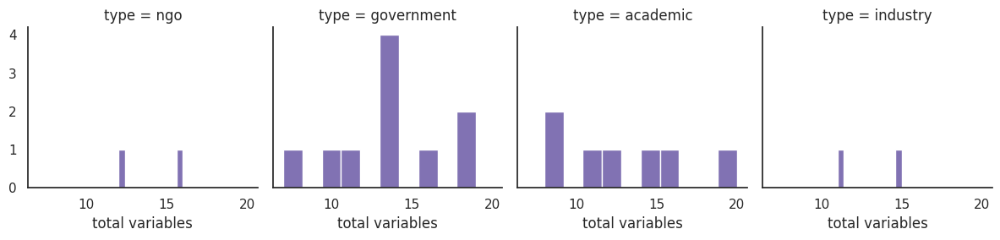

In [ ]:
print(df_graph_stats.groupby('type')["total variables"].describe())
g= sns.FacetGrid(df_graph_stats, col="type")
g = g.map(plt.hist, "total variables", color="m")



## Complexity (Receivers/transmitters) = R/T

> REWRITE IN OWN WORDS

* Large amount of receivers = FCM conciders many outcomes and situtations that result from the system
* Large amount of transmitters = Top down influencers (hierarchical system), flattens where causal arguments are not well elaborated

Complex maps have a large ratio because they define more utility outcomes and less controlling forcing functions. 

            count      mean       std  min       25%       50%    75%       max
type                                                                           
academic      7.0  1.127551  1.667499  0.0  0.000000  0.142857  1.875  4.000000
government   10.0  0.714899  0.864795  0.0  0.298611  0.477273  0.750  3.000000
industry      2.0  0.583333  0.117851  0.5  0.541667  0.583333  0.625  0.666667
ngo           2.0  0.700000  0.424264  0.4  0.550000  0.700000  0.850  1.000000


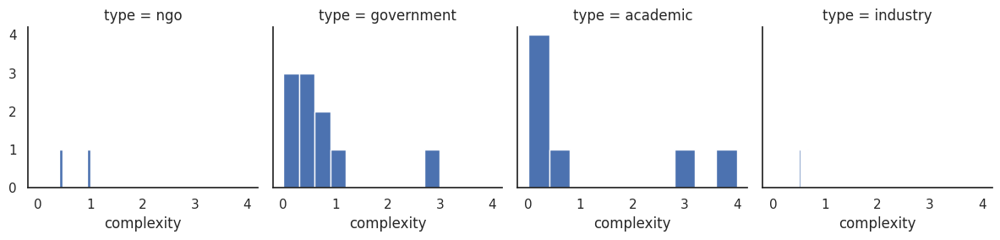

In [ ]:
print(df_graph_stats.groupby('type')["complexity"].describe())
g= sns.FacetGrid(df_graph_stats, col="type")
g = g.map(plt.hist, "complexity", color="b")

## Hierarchy

Graph hierarchy ranges from zero to one graphs with a vaule of one are hierarchical while graphs with a value of zero are democratic (MacDonald, 1983; Özesmi and Özesmi, 2004). The graphs produced by stakeholders during the workshop are hierarchacl, which can be interpreded that stakeholders beleive that stormwater management practices in the Triangle, NC are not easy to modify (Sandell, 1996; Özesmi and Özesmi, 2004). 

            count      mean       std  ...       50%       75%       max
type                                   ...                              
academic      7.0  0.709138  0.336000  ...  0.739130  1.000000  1.000000
government   10.0  0.835950  0.248645  ...  1.000000  1.000000  1.000000
industry      2.0  0.894872  0.039888  ...  0.894872  0.908974  0.923077
ngo           2.0  0.850000  0.212132  ...  0.850000  0.925000  1.000000

[4 rows x 8 columns]


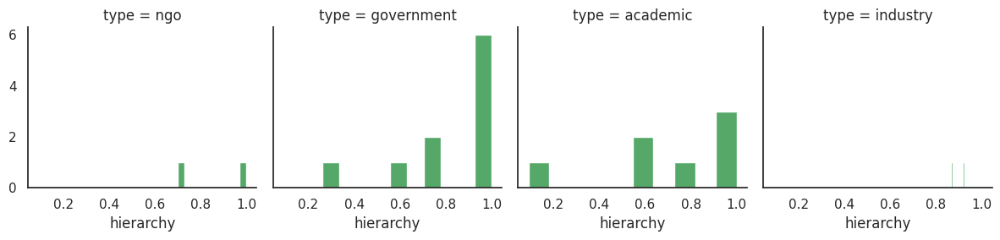

In [ ]:
print(df_graph_stats.groupby('type')["hierarchy"].describe())
g= sns.FacetGrid(df_graph_stats, col="type")
g = g.map(plt.hist, "hierarchy", color="g")

            count      mean       std  ...       50%       75%       max
type                                   ...                              
academic      7.0  0.134385  0.066928  ...  0.121212  0.161851  0.250000
government   10.0  0.150930  0.094029  ...  0.131370  0.170717  0.388889
industry      2.0  0.130087  0.008877  ...  0.130087  0.133225  0.136364
ngo           2.0  0.109848  0.037498  ...  0.109848  0.123106  0.136364

[4 rows x 8 columns]


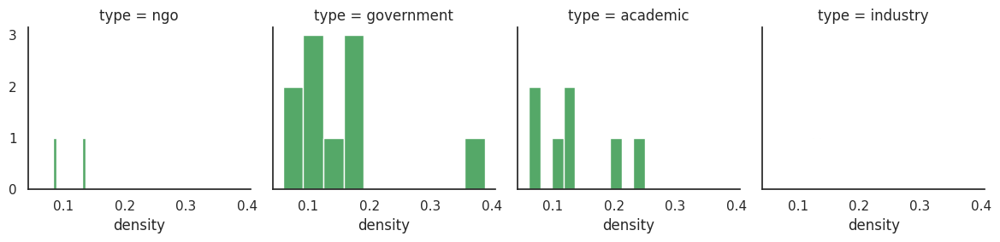

In [ ]:
print(df_graph_stats.groupby('type')["density"].describe())
g= sns.FacetGrid(df_graph_stats, col="type")
g = g.map(plt.hist, "density", color="g")

# Function: remove_orphan_nodes

In [ ]:
def remove_orphan_nodes(df_matrix):
  drop_list = []
  for i in df_matrix.index:
    if df_matrix[i].sum(axis = 0, skipna = True) == 0 and df_matrix.loc[i].sum(axis = 0, skipna = True) == 0:
      drop_list.append(i)
  return df_matrix.drop(columns=drop_list, index=drop_list)

# Function: remove_weak_connections

In [ ]:
def remove_weak_connections(df_matrix, threshold=0.0):
  import statistics 

  drop_list = []
  weight_list = []
  #Get weight and set threashold
  #Set all edges with weights under 0.25 to 0
  for i in df_matrix.index:
    for c in df_matrix.columns:
      weight_list.append(df_matrix.loc[i,c])

  df_weight = pd.DataFrame({'weights': weight_list})
  sns.histplot(df_weight, color="skyblue", kde=False, bins=5, stat='density')
  # statistics.mean(weight_list) + (statistics.stdev(weight_list) * 2)
  _mean = statistics.mean(weight_list)
  print("Mean: {}".format(_mean))
  # print("Geometric Mean: {}".format(statistics.geometric_mean(weight_list)))
  print("Median: {}".format(statistics.median(weight_list)))
  _std = statistics.stdev(weight_list)
  print("Std: {}".format(_std))
  # print("Quantiles: {}".format(statistics.Quantiles(weight_list, n=10)))
  high_threshold= _mean + 3 * _std
  print("High Threshold: {}".format(high_threshold))
  low_threshold = _mean - 3 * _std
  print("Low Threshold: {}".format(low_threshold))
  for i in df_matrix.index:
    for c in df_matrix.columns:
      # zscore = (df_matrix.loc[i,c] - _mean)/_std
      # if abs(zscore) <= 3:
      # if df_matrix.loc[i,c] < low_threshold or df_matrix.loc[i,c] > high_threshold:
      if abs(df_matrix.loc[i,c]) < threshold:
        df_matrix.loc[i,c] = 0
  # Remove Nodes that no longer have any connections
  for i in df_matrix.index:
    if df_matrix[i].sum(axis = 0, skipna = True) == 0 and df_matrix.loc[i].sum(axis = 0, skipna = True) == 0:
      drop_list.append(i)
  return df_matrix.drop(columns=drop_list, index=drop_list)

# Function: Aggregate_mean

In [ ]:
def aggregate_mean(adj_matrices, concepts, zeros="M", verbose=False):
    """Aggregates arithmatic mean of adjacency matrices.
    
    :param adj_matrices: List of FCM adjaceny matrices.
    :param concepts: List of variable names used to label graph adjaceny matrix.
    :param zeros: Determines if zeros are included in arithmatic mean calculation.
    
    :return: np.array of the arithmatic mean of adjacency matrices.
    """
    # adj_matrices = np.array([
    #                          [[2.,2.,0.],[0.,2.,0.],[2.,2.,0.]],
    #                          [[2.,2.,5.],[-2.,2.,-5.],[2.,2.,-5.]],
    #                          [[5.,5.,5.],[5.,5.,-5.],[0.,0.,5.]],
    #                          [[5.,5.,5.],[5.,5.,-5.],[5.,5.,5.]]
    # ]
    # )
    # concepts =["c1", "c2", "c3"]
    # print("Adjecency Matrixs: {}".format(adj_matrices))
    

    from functools import reduce
    from statistics import mean as mean
    n_concepts = len(concepts)
    # print(concepts)
    print("Number of Maps: {}".format(len(adj_matrices)))
    print("Number of Concepts: {}".format(n_concepts))

    count = np.zeros((n_concepts,n_concepts))
    # print("Zeros Matrix: {}".format(count))



    adj_ag = np.zeros((n_concepts,n_concepts))
    # print(adj_ag)
    #Create matrix of the sums of all adjecency matricies
    adj = (reduce((lambda x, y: x + y), adj_matrices))
    # print("Sum Matrix: {}".format(adj))
    adj_copy = np.copy(adj)   


    
    if zeros == "M":
      if verbose:
        print("Calculating Mean")
      for row in range (n_concepts):
          for col in range (n_concepts):
              a = [ind[row,col] for ind in adj_matrices]
              adj_ag[row,col] = mean(a)
    elif zeros == 'WM':
      if verbose:
        print("Calculating Weighted Mean")
      weighted_weight = np.zeros((n_concepts,n_concepts))
      for fcm in adj_matrices:
        for row in range (n_concepts):
          for col in range (n_concepts):
            if fcm[row,col] != 0:
              count[row,col] +=1

      # print("Count Matrix: {}".format(count))
      for row in range (n_concepts):
        for col in range (n_concepts):
            n_maps = len(adj_matrices) # Number of maps
            w = count[row,col]
            s = adj_copy[row,col] # Sum Matrix
            adj_ag[row,col] = (s * w)/ n_maps
            # adj_ag[row,col] = adj_copy[row,col]/len(adj_matrices)

      # np.average()
    else:
        #Creates a variable frequency matrix. 
        for fcm in adj_matrices:
            for row in range (n_concepts):
                for col in range (n_concepts):
                    if fcm[row,col] != 0:
                        count[row,col] +=1

        #Calculates the mean of all matrices by not including zero values.
        for row in range (n_concepts):
            for col in range (n_concepts):
                if count[row,col] == 0:
                    adj_ag[row,col] = 0
                else:
                    adj_ag[row,col] = adj_copy[row,col]/count[row,col]
    # print("Agg Matrix: {}".format(adj_ag))
    return adj_ag
    

# Aggregated Mean FCM (no zeros) Figure

Number of Maps: 21
Number of Concepts: 126
[(0, 4, {'weight': 2.2666666666666666}), (0, 6, {'weight': 0.01904761904761905}), (0, 9, {'weight': -0.014761904761904763}), (0, 10, {'weight': 1.8000000000000003}), (0, 21, {'weight': 0.024285714285714285}), (0, 26, {'weight': 0.006190476190476191}), (0, 29, {'weight': 0.013809523809523808}), (0, 37, {'weight': 0.008571428571428568}), (0, 39, {'weight': 0.018571428571428572}), (0, 41, {'weight': -0.024285714285714285}), (0, 50, {'weight': 0.029523809523809525}), (0, 51, {'weight': -0.006190476190476191}), (0, 52, {'weight': -0.011428571428571429}), (0, 55, {'weight': 0.02523809523809524}), (0, 56, {'weight': 0.023809523809523808}), (0, 57, {'weight': 0.015714285714285715}), (0, 58, {'weight': 0.02238095238095238}), (0, 66, {'weight': 0.0380952380952381}), (0, 82, {'weight': -0.029523809523809525}), (0, 111, {'weight': 0.03}), (0, 112, {'weight': -0.02666666666666667}), (0, 113, {'weight': -0.011428571428571429}), (1, 3, {'weight': -0.03428571

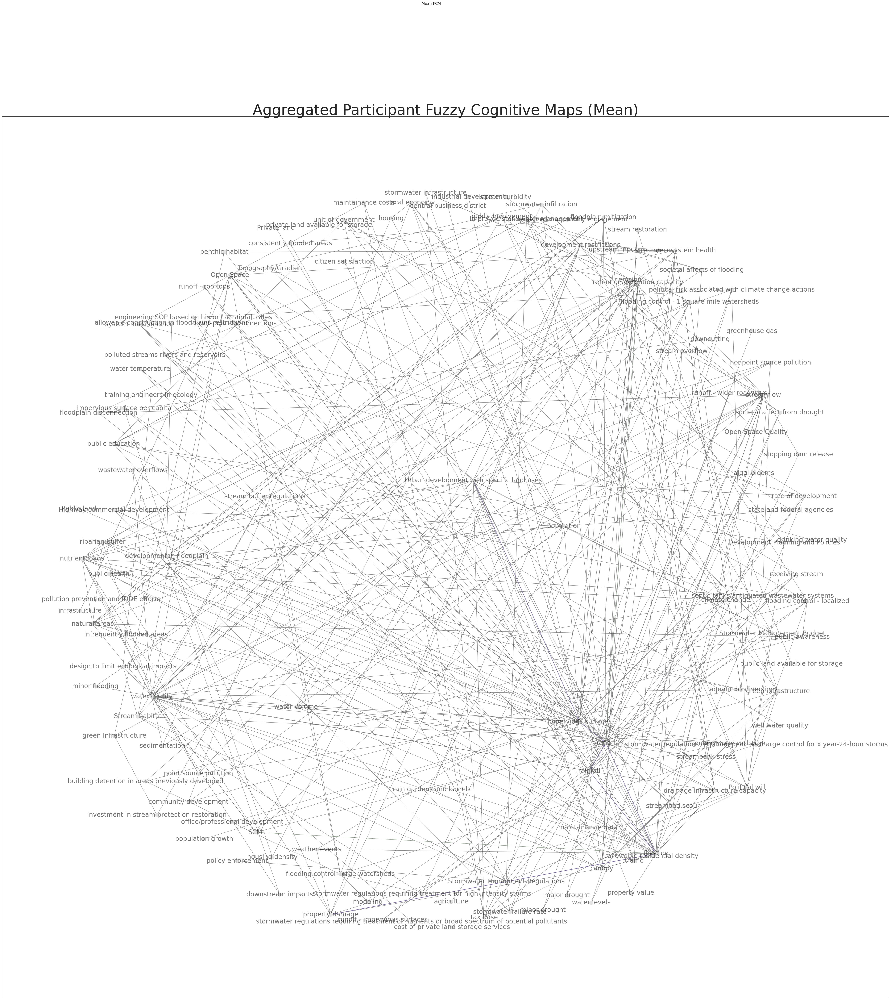

In [ ]:
column_headers = df_concepts['code'].unique() #test_column_headers
      
Adj_aggregated_FCM = aggregate_mean(All_ADJs, column_headers, zeros='M')
fig, ax = plt.subplots(figsize=(60,60))
ax.set_title("Aggregated Participant Fuzzy Cognitive Maps (Mean)", fontsize=55)
df_agg_mean = pd.DataFrame(Adj_aggregated_FCM, index=column_headers, columns=column_headers)
df_agg_mean.to_csv(path_or_buf=os.path.join(save_location, "complete_mean_stakeholders_combined_fcm.csv"), index=True)
plt.suptitle('Mean FCM', fontsize=14)


stats= generate_map(Adj_aggregated_FCM, column_headers,ax)
print(stats)
plt.savefig(os.path.join(save_location, "allFCMsMeans.png"))

## Condensed Aggregate



Number of Maps: 21
Number of Concepts: 126
key (source_nod): 27, value (new_nod): 0, label: water temperature, gLabel: water temperature
key (source_nod): 124, value (new_nod): 1, label: water levels, gLabel: water levels
key (source_nod): 29, value (new_nod): 2, label: receiving stream, gLabel: receiving stream
key (source_nod): 43, value (new_nod): 3, label: Private land, gLabel: Private land
key (source_nod): 44, value (new_nod): 4, label: Public land, gLabel: Public land
key (source_nod): 66, value (new_nod): 5, label: algal blooms, gLabel: algal blooms
key (source_nod): 98, value (new_nod): 6, label: Stream habitat, gLabel: Stream habitat
key (source_nod): 103, value (new_nod): 7, label: flooding control - 1 square mile watersheds, gLabel: flooding control - 1 square mile watersheds
key (source_nod): 104, value (new_nod): 8, label: flooding control- large watersheds, gLabel: flooding control- large watersheds
key (source_nod): 122, value (new_nod): 9, label: property value, gLabel

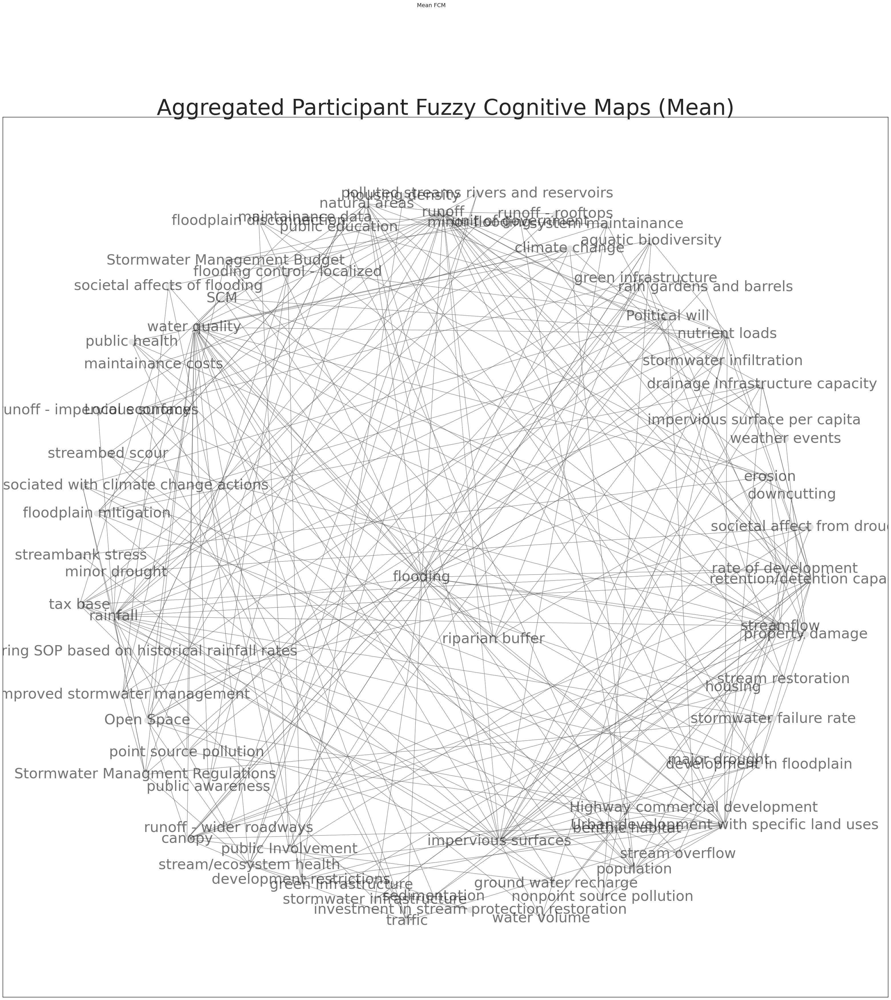

In [ ]:
column_headers = df_concepts['code'].unique() #test_column_headers
      
Adj_aggregated_FCM = aggregate_mean(All_ADJs, column_headers, zeros="M")
fig, ax = plt.subplots(figsize=(40,40))
ax.set_title("Aggregated Participant Fuzzy Cognitive Maps (Mean)", fontsize=55)
df_agg_mean = pd.DataFrame(Adj_aggregated_FCM, index=column_headers, columns=column_headers)
plt.suptitle('Mean FCM', fontsize=14)

stats= generate_condensed_map(Adj_aggregated_FCM, column_headers,ax)
print(stats)
plt.savefig(os.path.join(save_location, "allFCMsMeans.png"))
 


# Function: CombineAdjecencyMatrix

In [ ]:
def combineAdjacencyMatrix(filtered_concepts,filter=""):
    """
    Combines individual FCMs into a single FCM with all values
    :param filtered_concepts
    :param filter: String (academic, government, ngo, industry, None)
    """
    All_ADJs =[]
    all_data_frames = pd.DataFrame(columns=filtered_concepts, index=filtered_concepts).fillna(0)
    for root, dirs, files in os.walk(data_location, topdown=False):
        for name in files:
            if "allFCMs" not in name and filter in name and name != ".DS_Store":
                file_location = os.path.join(root, name)
                participant_organization = name.split("_")[-1].split('.')[0]
                df = pd.read_excel(file_location,index_col=0).fillna(0)

                df.columns = df.columns.map(concept_map)
                df.index = df.index.map(concept_map)
                # print("FCMs", "%sFCM - %s - %d" % (name, participant_organization, len(All_ADJs)))
                # print(df.shape)
                take_not_zero = lambda s1, s2: s1 if s1.sum() != 0 else s2
                df_copy = all_data_frames.combine(df, take_not_zero, fill_value=0)

                # take_larger = lambda s1, s2: s1 if s1.sum() > s2.sum() else s2
                # df_copy = all_data_frames.combine(df, take_larger, fill_value=0, overwrite=True)
                All_ADJs.append(df_copy.loc[filtered_concepts,filtered_concepts].values)

    return dict(graph_stats=pd.DataFrame(df_graph_stats_data), all_adj=All_ADJs) 

## Agg Mean of all FCMs filtered Concepts > 1 occurance

Number of Maps: 21
Number of Concepts: 43
Mean: 0.0012562775245306343
Median: 0.0
Std: 0.016770690713944388
High Threshold: 0.0515683496663638
Low Threshold: -0.04905579461730253
[(0, 5, {'weight': -0.023809523809523808}), (0, 8, {'weight': -0.01904761904761905}), (0, 9, {'weight': 0.15714285714285714}), (0, 15, {'weight': -0.018095238095238095}), (0, 17, {'weight': 0.06523809523809523}), (0, 18, {'weight': -0.018571428571428572}), (0, 28, {'weight': -0.018571428571428572}), (0, 34, {'weight': 0.01904761904761905}), (0, 42, {'weight': -0.0380952380952381}), (1, 0, {'weight': 0.08857142857142856}), (1, 3, {'weight': 0.29095238095238096}), (1, 5, {'weight': -0.023809523809523808}), (1, 6, {'weight': -0.02}), (1, 8, {'weight': -0.03428571428571429}), (1, 11, {'weight': -0.007619047619047619}), (1, 12, {'weight': 0.03571428571428571}), (1, 15, {'weight': -0.029523809523809525}), (1, 21, {'weight': 0.04904761904761905}), (1, 34, {'weight': -0.029047619047619048}), (1, 40, {'weight': 0.04761

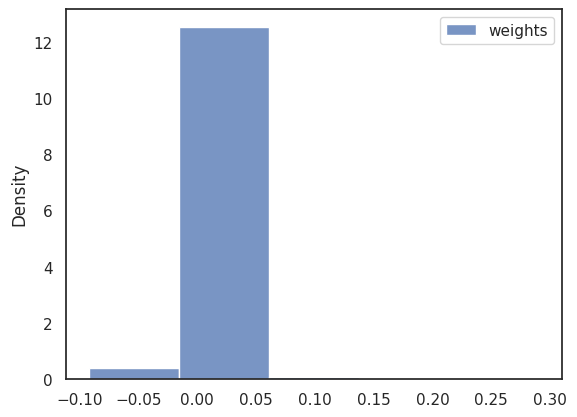

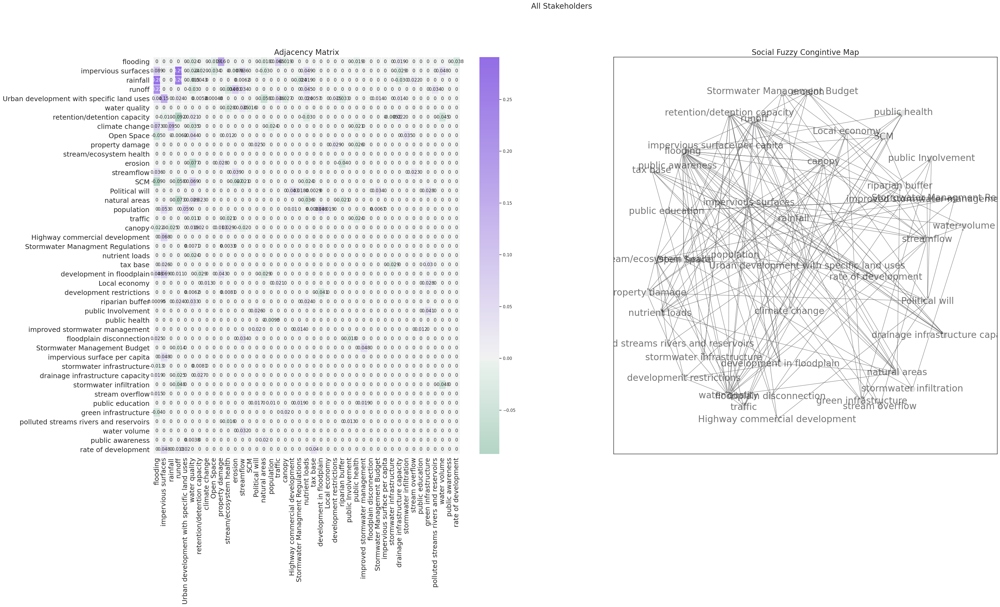

In [122]:
# filtered_concepts = df_concepts['code'].unique()
df_counts = df_concepts['code'].value_counts()
filtered_concepts = df_counts[df_counts > 1].index
all_fcms = combineAdjacencyMatrix(filtered_concepts, "")
Adj_aggregated_FCM = aggregate_mean(all_fcms["all_adj"], filtered_concepts, zeros="M")

df_agg_mean= pd.DataFrame(Adj_aggregated_FCM, index=filtered_concepts, columns=filtered_concepts)
df_agg_mean_reduced = remove_weak_connections(df_agg_mean, threshold=0.0) #0.045
df_agg_mean_reduced.to_csv(path_or_buf=os.path.join(save_location, "mean_stakeholders_combined_fcm_filtered_lt_1.csv"), index=True)

fig, (ax, ax1) = plt.subplots(1,2,figsize=(40,20))#w, h
plt.suptitle('All Stakeholders', fontsize=20)
ax.set_title("Adjacency Matrix", fontsize=20)
ax.set_xticklabels(ax.get_xmajorticklabels(), fontsize = 18)
ax.set_yticklabels(ax.get_ymajorticklabels(), fontsize = 18)
sns.heatmap(df_agg_mean_reduced.fillna(0), annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
ax1.set_title("Social Fuzzy Congintive Map", fontsize=20)
fig.subplots_adjust(bottom=0.15)
fcm_stats = generate_map(df_agg_mean_reduced.to_numpy(), df_agg_mean_reduced.index,ax1)
print(fcm_stats)
plt.savefig(os.path.join(save_location, "mean_fcm_no_weak_connections.png"))


In [135]:
# print(fcm_stats['new_centrality'])
df_all_fcm_centrality = pd.DataFrame(fcm_stats['new_centrality']).sort_values(["centrality","out-degree"], ascending=False)

df_all_fcm_centrality.head()

,variable,in-degree,out-degree,centrality
0,flooding,1.064286,0.377619,1.441905
3,runoff,0.936667,0.479048,1.415714
1,impervious surfaces,0.470952,0.656190,1.127143
2,rainfall,0.120000,0.660952,0.780952
5,water quality,0.470476,0.078095,0.548571


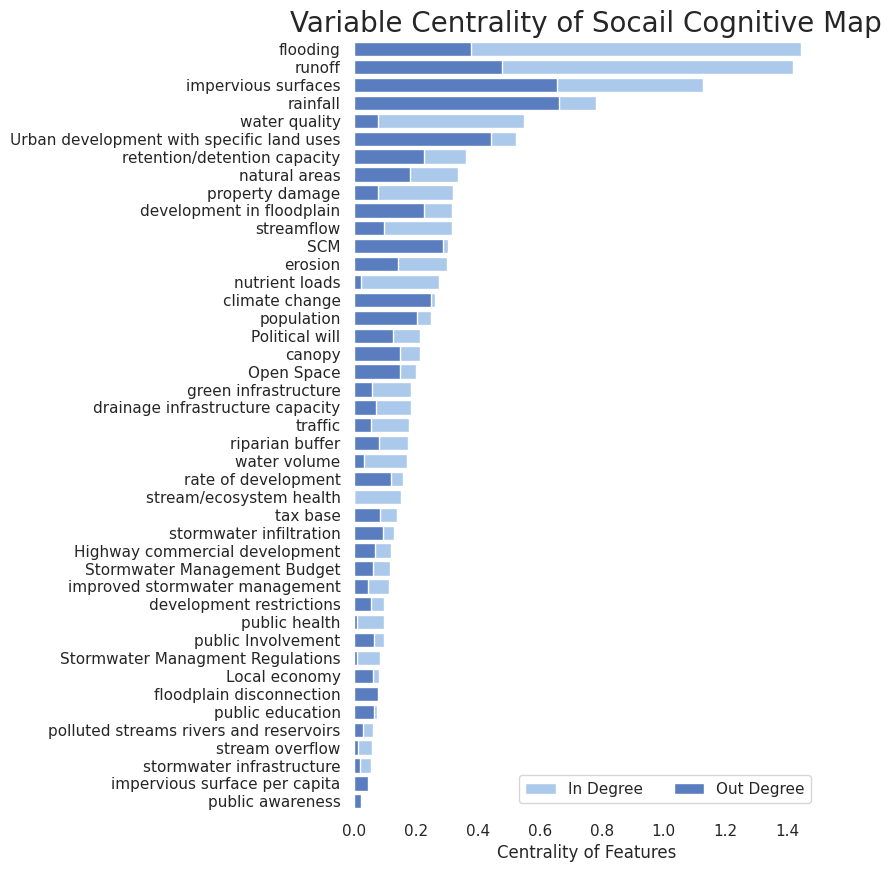

In [140]:
f, ax = plt.subplots(figsize=(6, 10))
# Plot the total crashes
sns.set_color_codes("pastel")

ax.set_title("Variable Centrality of Socail Cognitive Map", fontsize=20)

sns.barplot(x="centrality", y="variable", data=df_all_fcm_centrality, label="In Degree", color="b")
sns.set_color_codes("muted")
sns.barplot(x="out-degree", y="variable", data=df_all_fcm_centrality, label="Out Degree", color="b")

ax.legend(ncol=2, loc="lower right", frameon=True)
ax.set(xlim=(0, 1.5), ylabel="",
       xlabel="Centrality of Features")
sns.despine(left=True, bottom=True)
plt.savefig(os.path.join(save_location, "mean_fcm_centrality.png"), bbox_inches="tight")


# Government Stakeholder Mean FCM

In [104]:
df_gov_concepts = df_concepts[df_concepts["group"] == 'government']
df_counts = df_gov_concepts['code'].value_counts()
filtered_concepts_gov = df_counts[df_counts > 1].index #df_counts.index # df_counts[df_counts >=2].index
df_graph_stats_gov = combineAdjacencyMatrix(filtered_concepts_gov, "government")


## Aggregate Government Component Count

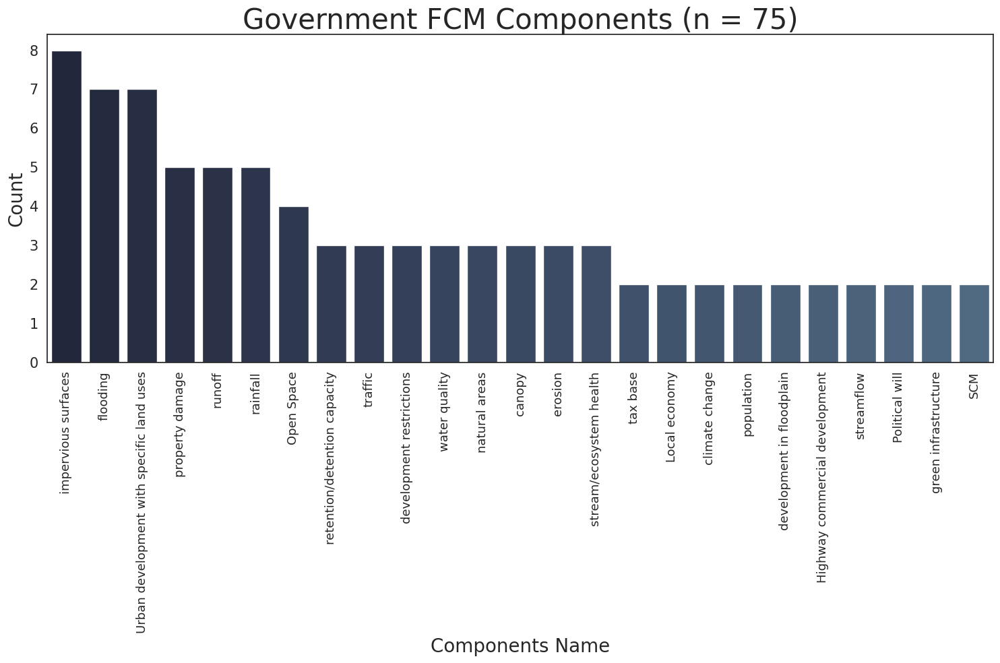

In [106]:
components_count = len(df_gov_concepts['code'].unique())
fig,ax= plt.subplots(figsize=(15, 10))
pal = sns.cubehelix_palette(56, rot=-.25, light=.7, reverse=True)
sns.countplot(x="code", data=df_gov_concepts,ax=ax, order = filtered_concepts_gov, dodge=False, palette=pal, orient='h')

plt.xticks(rotation=90)
plt.ylabel('Count', size = 20)
plt.xlabel('Components Name', size = 20)
plt.yticks(size = 15)
plt.xticks(size = 13)
ax.set_title(("Government FCM Components (n = %d)" % components_count), fontsize=30)
plt.tight_layout()
plt.savefig(os.path.join(save_location, "combined_model_varibales_government.png"))

# plt.savefig(os.path.join(save_location, "FCM Transmitter Components"))

## Government Stakeholder Mean FCM

Number of Maps: 10
Number of Concepts: 25
Mean: 0.0028352
Median: 0.0
Std: 0.032136927238111804
High Threshold: 0.09924598171433541
Low Threshold: -0.09357558171433542
[(0, 1, {'weight': 0.136}), (0, 4, {'weight': 0.287}), (0, 6, {'weight': -0.072}), (0, 7, {'weight': -0.041999999999999996}), (0, 10, {'weight': -0.05}), (0, 11, {'weight': -0.062}), (0, 21, {'weight': 0.041999999999999996}), (1, 3, {'weight': 0.279}), (1, 8, {'weight': 0.104}), (1, 10, {'weight': -0.05}), (1, 12, {'weight': -0.039}), (2, 0, {'weight': 0.29200000000000004}), (2, 1, {'weight': 0.08299999999999999}), (2, 4, {'weight': 0.051000000000000004}), (2, 6, {'weight': 0.051000000000000004}), (2, 7, {'weight': 0.011}), (2, 8, {'weight': 0.076}), (2, 9, {'weight': 0.031}), (2, 11, {'weight': -0.121}), (2, 12, {'weight': -0.05600000000000001}), (2, 15, {'weight': 0.012}), (3, 9, {'weight': 0.061}), (3, 22, {'weight': 0.053000000000000005}), (4, 1, {'weight': 0.119}), (4, 10, {'weight': -0.062}), (4, 13, {'weight': 0.0

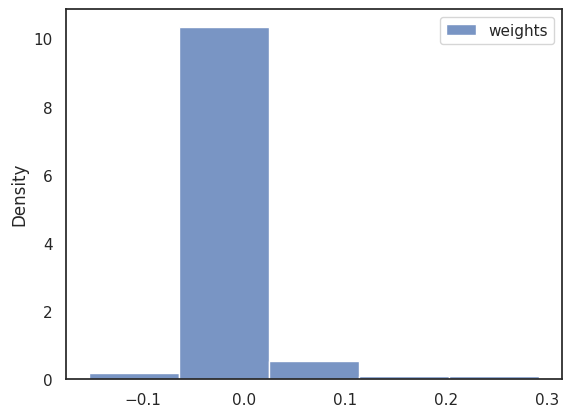

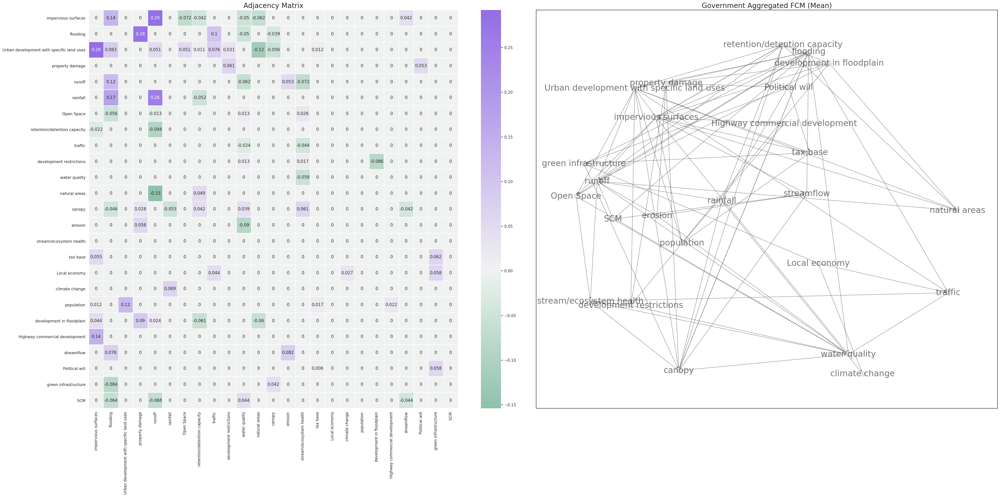

In [107]:
Adj_aggregated_FCM_gov = aggregate_mean(df_graph_stats_gov["all_adj"], filtered_concepts_gov,zeros="M")
df_agg_mean = pd.DataFrame(Adj_aggregated_FCM_gov, index=filtered_concepts_gov, columns=filtered_concepts_gov)
df_agg_mean_reduced = remove_weak_connections(df_agg_mean, threshold=0.0)

df_agg_mean.to_csv(path_or_buf=os.path.join(save_location, "mean_of_government_stakeholders_combined_fcm_dirty.csv"), index=True)

# df_agg_mean_clean = remove_orphan_nodes(df_agg_mean)
df_agg_mean_reduced.to_csv(path_or_buf=os.path.join(save_location, "mean_of_government_stakeholders_combined_fcm.csv"), index=True)

fig, (ax, ax1) = plt.subplots(1,2,figsize=(40,20))
# plt.suptitle('Mean FCM', fontsize=14)
ax.set_title("Adjacency Matrix", fontsize=20)

sns.heatmap(df_agg_mean_reduced.fillna(0), annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
ax1.set_title("Government Aggregated FCM (Mean)", fontsize=20)
gov_stats = generate_map(df_agg_mean_reduced.to_numpy(), df_agg_mean_reduced.index,ax1)
print(gov_stats)
plt.tight_layout()
plt.savefig(os.path.join(save_location, "FCM-Government-Mean.png"))



# Academic Stakeholder Mean FCM

In [108]:
df_academic_concepts = df_concepts[df_concepts["group"] == 'academic']
df_counts = df_academic_concepts['concept'].value_counts()
filtered_concepts_academic = df_counts[df_counts > 1].index # df_counts.index # df_counts[df_counts >= 2].index
df_graph_stats_academic = combineAdjacencyMatrix(filtered_concepts_academic, "academic")

## Aggregate Academic Component Count

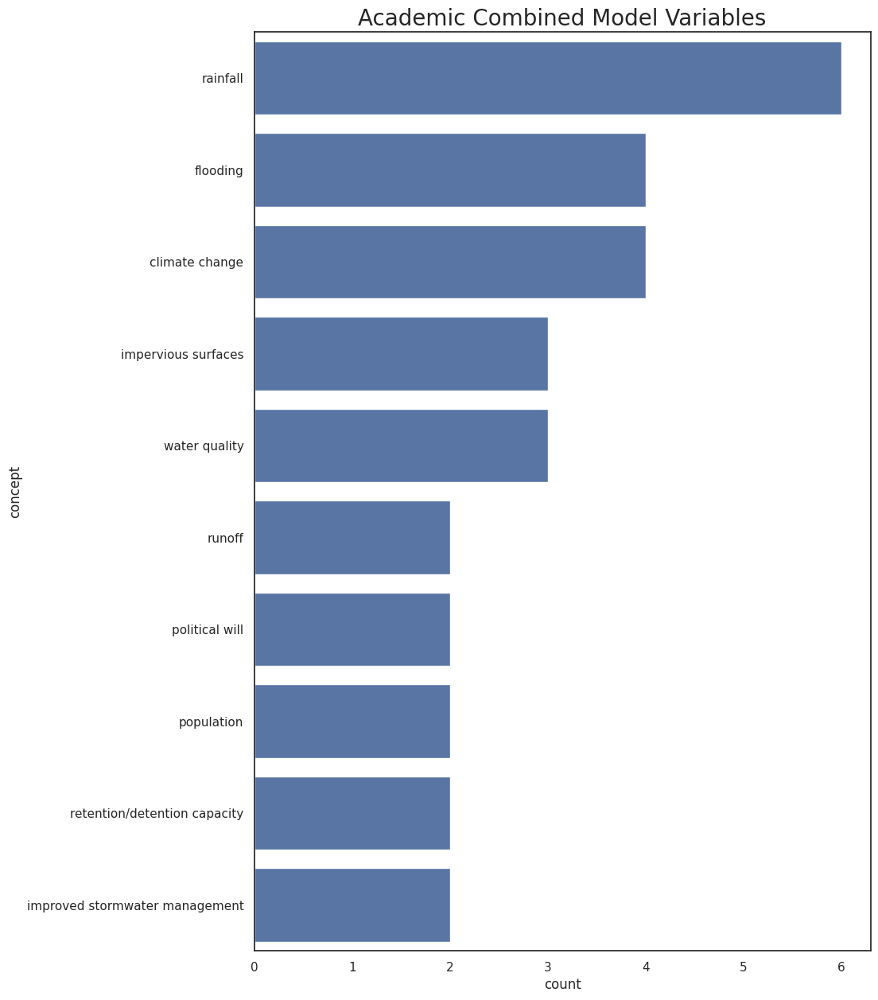

In [110]:
fig,ax= plt.subplots(figsize=(10, 15))
sns.countplot(y="concept", data=df_academic_concepts,ax=ax, order = filtered_concepts_academic, color="b")
ax.set_title(("Academic Combined Model Variables"), fontsize=20)
plt.savefig(os.path.join(save_location, "combined_model_varibales_academic.png"))

## Academic Mean FCM

Number of Maps: 7
Number of Concepts: 10
Mean: 0.01247142857142857
Median: 0.0
Std: 0.06060093995065171
High Threshold: 0.1942742484233837
Low Threshold: -0.16933139128052654
[(0, 1, {'weight': 0.32571428571428573}), (0, 4, {'weight': -0.04428571428571428}), (0, 5, {'weight': 0.08714285714285715}), (0, 7, {'weight': 0.23857142857142857}), (2, 0, {'weight': 0.1857142857142857}), (2, 1, {'weight': 0.22}), (2, 4, {'weight': -0.10428571428571429}), (2, 6, {'weight': -0.07285714285714286}), (3, 7, {'weight': 0.14285714285714285}), (5, 4, {'weight': 0.06285714285714286}), (5, 7, {'weight': -0.14285714285714285}), (6, 3, {'weight': 0.14285714285714285}), (7, 1, {'weight': 0.2057142857142857})]
                              centrality
rainfall                        0.792857
flooding                        0.751429
runoff                          0.444286
impervious surfaces             0.285714
climate change                  0.228571
population                      0.070000
retention/detenti

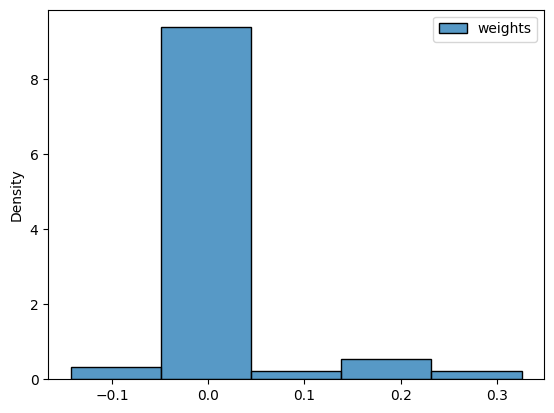

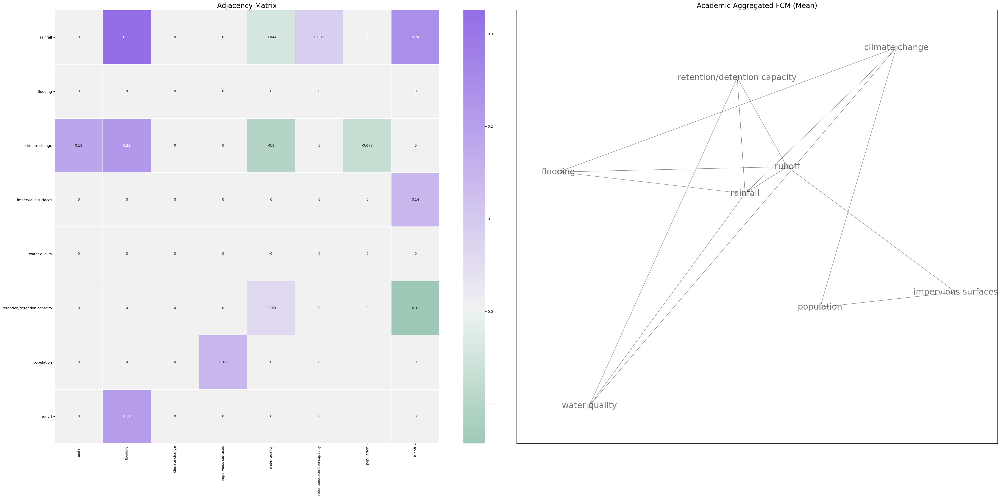

In [ ]:
Adj_aggregated_FCM_academic = aggregate_mean(df_graph_stats_academic["all_adj"], filtered_concepts_academic,zeros="M")
df_agg_mean = pd.DataFrame(Adj_aggregated_FCM_academic, index=filtered_concepts_academic, columns=filtered_concepts_academic)
df_agg_mean_reduced = remove_weak_connections(df_agg_mean, threshold=0.0)

df_agg_mean.to_csv(path_or_buf=os.path.join(save_location, "mean_of_academic_stakeholders_combined_fcm_dirty.csv"), index=True)

# df_agg_mean_clean = remove_orphan_nodes(df_agg_mean)
df_agg_mean_reduced.to_csv(path_or_buf=os.path.join(save_location, "mean_of_academic_stakeholders_combined_fcm.csv"), index=True)

fig, (ax, ax1) = plt.subplots(1,2,figsize=(40,20))
# plt.suptitle('Mean FCM', fontsize=14)
ax.set_title("Adjacency Matrix", fontsize=20)

sns.heatmap(df_agg_mean_reduced.fillna(0), annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
ax1.set_title("Academic Aggregated FCM (Mean)", fontsize=20)
gov_stats = generate_map(df_agg_mean_reduced.to_numpy(), df_agg_mean_reduced.index,ax1)
print(gov_stats)
plt.tight_layout()
plt.savefig(os.path.join(save_location, "FCM-Academic-Mean.png"))


## Academic Stakeholder Mean (w/zeros) FCM

Number of Maps: 7
Number of Concepts: 69
[(0, 1, {'weight': 0.7599999999999999}), (0, 4, {'weight': -0.31}), (0, 5, {'weight': 0.61}), (0, 9, {'weight': 0.835}), (0, 10, {'weight': -0.24}), (0, 21, {'weight': -0.24}), (0, 25, {'weight': 0.62}), (0, 32, {'weight': 0.53}), (0, 33, {'weight': 0.39}), (0, 34, {'weight': 0.5}), (0, 35, {'weight': 0.8}), (0, 43, {'weight': -0.13}), (0, 57, {'weight': -0.56}), (0, 58, {'weight': 0.13}), (0, 64, {'weight': 0.33}), (0, 65, {'weight': 0.47}), (0, 67, {'weight': 0.63}), (1, 44, {'weight': -0.8}), (1, 47, {'weight': 0.31}), (1, 63, {'weight': -0.38}), (2, 0, {'weight': 0.6499999999999999}), (2, 1, {'weight': 0.77}), (2, 4, {'weight': -0.73}), (2, 8, {'weight': -0.51}), (2, 52, {'weight': -0.44}), (3, 9, {'weight': 1.0}), (3, 16, {'weight': -0.74}), (4, 36, {'weight': 0.22}), (4, 39, {'weight': 0.33}), (4, 58, {'weight': 0.73}), (5, 4, {'weight': 0.44}), (5, 9, {'weight': -1.0}), (5, 13, {'weight': -0.11}), (5, 26, {'weight': -0.56}), (7, 40, {'wei

{'central_components': ['rainfall'],
 'complexity': 1.25,
 'density': 0.016410912190963342,
 'distance': 1.1159420289855073,
 'hierarchy': 0.7922077922077921,
 'ordinary': 51,
 'receiver_components': ['water volume',
  'consistently flooded areas',
  'algal blooms',
  'housing',
  'downstream impacts',
  'engineering SOP based on historical rainfall rates',
  'societal affects of flooding',
  'societal affect from drought',
  'streamflow',
  'stream overflow'],
 'receivers': 10,
 'total variables': 69,
 'total_edges': 77,
 'total_nodes': 69,
 'transmitters': 8,
 'transmitters_components': ['climate change',
  'greenhouse gas',
  'upstream inputs',
  'community development',
  'private land available for storage',
  'allowable residential density',
  'stormwater infiltration',
  'public land available for storage'],
 'weights': [0.7599999999999999,
  -0.31,
  0.61,
  0.835,
  -0.24,
  -0.24,
  0.62,
  0.53,
  0.39,
  0.5,
  0.8,
  -0.13,
  -0.56,
  0.13,
  0.33,
  0.47,
  0.63,
  -0.8,


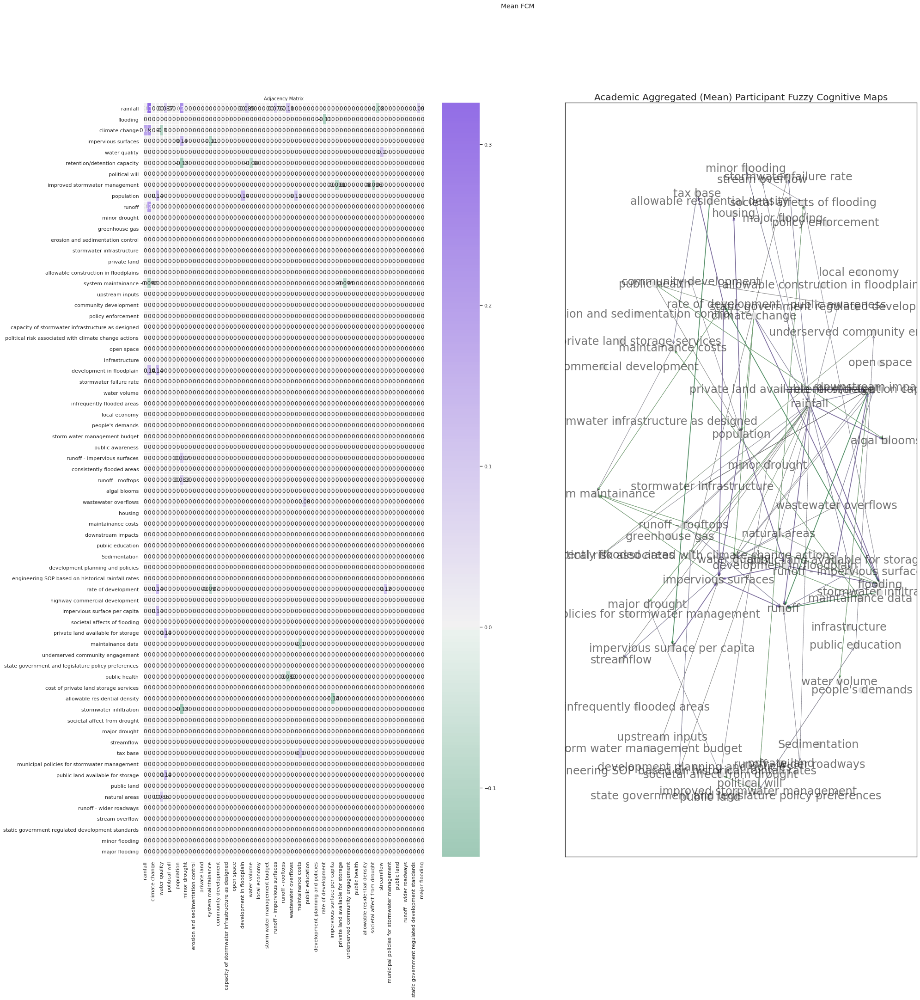

In [ ]:
Adj_aggregated_FCM_academic_zero = aggregate_mean(df_graph_stats_academic["all_adj"], filtered_concepts_academic,zeros=True)
df_agg_mean = pd.DataFrame(Adj_aggregated_FCM_academic, index=filtered_concepts_academic, columns=filtered_concepts_academic)
fig, (ax, ax1) = plt.subplots(1,2,figsize=(30,30))
plt.suptitle('Mean FCM', fontsize=14)
ax.set_title("Adjacency Matrix", fontsize=10)

sns.heatmap(df_agg_mean.fillna(0), annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
ax1.set_title("Academic Aggregated (Mean) Participant Fuzzy Cognitive Maps", fontsize=20)

generate_map(Adj_aggregated_FCM_academic_zero, filtered_concepts_academic,ax1)

[(0, 1, {'weight': 0.32571428571428573}), (0, 5, {'weight': 0.08714285714285715}), (0, 9, {'weight': 0.23857142857142857}), (0, 25, {'weight': 0.08857142857142856}), (0, 32, {'weight': 0.07571428571428572}), (0, 35, {'weight': 0.1142857142857143}), (0, 57, {'weight': -0.08}), (0, 67, {'weight': 0.09}), (1, 44, {'weight': -0.1142857142857143}), (2, 0, {'weight': 0.1857142857142857}), (2, 1, {'weight': 0.22}), (2, 4, {'weight': -0.10428571428571429}), (3, 9, {'weight': 0.14285714285714285}), (3, 16, {'weight': -0.10571428571428572}), (4, 58, {'weight': 0.10428571428571429}), (5, 9, {'weight': -0.14285714285714285}), (5, 26, {'weight': -0.08}), (7, 47, {'weight': -0.09142857142857143}), (7, 56, {'weight': -0.09571428571428572}), (8, 3, {'weight': 0.14285714285714285}), (8, 24, {'weight': 0.14285714285714285}), (8, 37, {'weight': 0.11142857142857143}), (9, 1, {'weight': 0.2057142857142857}), (16, 1, {'weight': -0.09571428571428572}), (16, 49, {'weight': -0.09285714285714286}), (24, 1, {'we

Text(0.5, 1.0, 'Academic Aggregated (Mean) Participant Fuzzy Cognitive Maps')

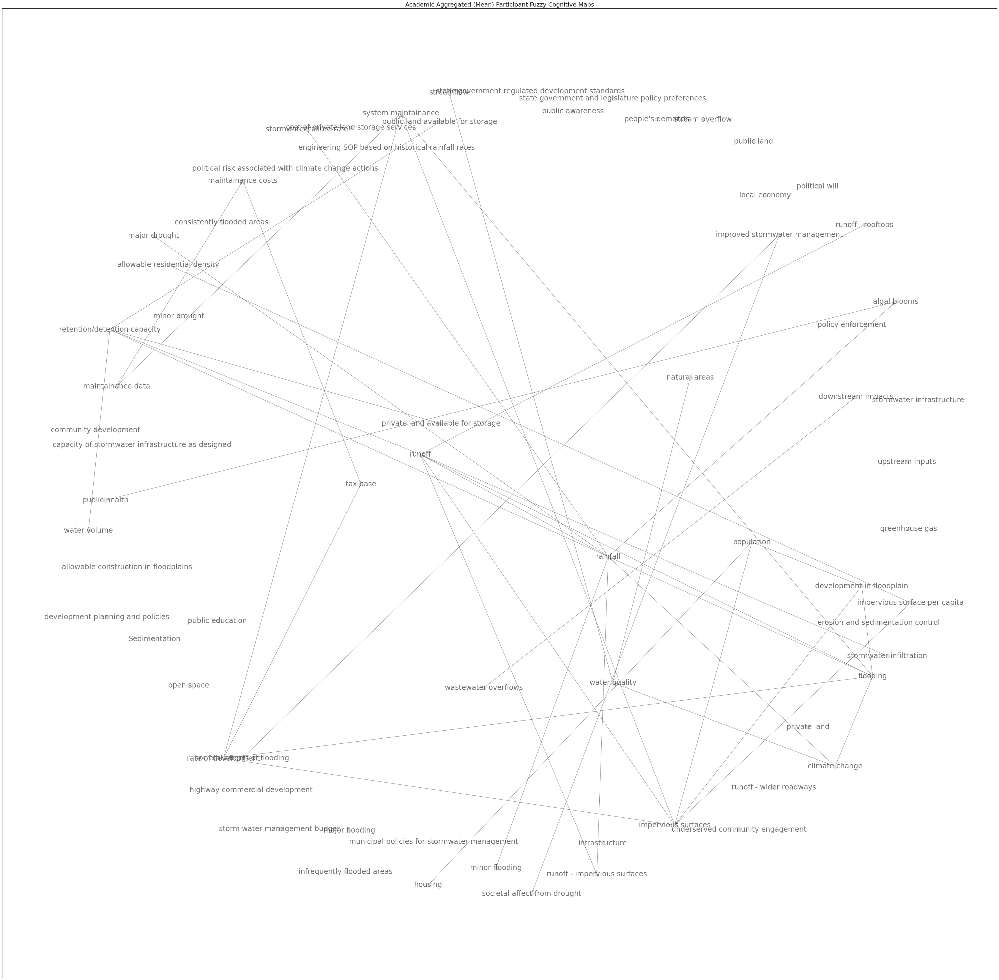

In [ ]:
fig, ax = plt.subplots(figsize=(60,60))
generate_map(Adj_aggregated_FCM_academic, filtered_concepts_academic,ax1)
ax.set_title("Academic Aggregated (Mean) Participant Fuzzy Cognitive Maps", fontsize=20)


Data indicates that goverment and academic stakeholder groups have differing concerns when it comes to stormwater management. Academic models tend to focus on the effects of climate change with 12 refernces to rainfall, 10 to climate change and flooding, while government stakeholders were more concerned with development mentioning impervious surface 16 times, flooding and urban development 14 times, and runoff, property damage and rainfall 10 times, and climate change is only refered to in 4 models.

The academic models also had a lower proportion of variables mentioned in more than 2 models with 10 total models, while the goverment models contain 20 variables.

In [ ]:
from statistics import mean

gov_concepts = filtered_concepts_gov.values
academic_concepts = filtered_concepts_academic.values

#Create Set of all stakeholder concepts
cat_concepts = set()
# lambda x: cat_concepts(x), filtered_concepts_academic.values
for academic_concept in filtered_concepts_academic.values:
    cat_concepts.add(academic_concept)
for gov_concept in filtered_concepts_gov.values:
    cat_concepts.add(gov_concept)

matrix_size = len(cat_concepts)
df_matrix = pd.DataFrame(np.zeros(shape=(matrix_size,matrix_size)), columns=cat_concepts, index=cat_concepts)

def addValueToMatrix(f, t, v):
    df_matrix.loc[f, t] = v

for concept_from in cat_concepts:
    keep_concept = False
    for concept_to in cat_concepts:
        addValueToMatrix(concept_from, concept_to, 0)
        values_to_average = []
#         print("Concept From: %s, Concept To: %s" % (concept_from, concept_to))
        try:
            gov_concept_from_index = gov_concepts.tolist().index(concept_from)
            try:
                gov_concept_to_index = gov_concepts.tolist().index(concept_to)
                gov_concept_value = Adj_aggregated_FCM_gov.item((gov_concept_from_index,gov_concept_to_index))
                if gov_concept_value != 0:
                    values_to_average.append(gov_concept_value)
                    
            except ValueError:
                pass
        except ValueError:
            pass
            
        try:
            academic_concept_from_index = academic_concepts.tolist().index(concept_from)
            try:
                academic_concept_to_index = academic_concepts.tolist().index(concept_to)
                academic_concept_value = Adj_aggregated_FCM_academic.item((academic_concept_from_index,academic_concept_to_index))
                if gov_concept_value != 0:
                    values_to_average.append(academic_concept_value)
                    
            except ValueError:
                pass
        except ValueError:
            pass
        
        if len(values_to_average) > 0:
            #Add the average value to the matrix
            addValueToMatrix(concept_from, concept_to, mean(values_to_average))
            keep_concept = True
        

df_matrix = remove_orphan_nodes(df_matrix)
# df_matrix = df_matrix.drop(columns=drop_list, index=drop_list)
        
df_matrix.to_csv(path_or_buf="./mean_of_stakeholders_combined_fcm.csv", index=True)
df_matrix.info()
            
            
# df_matrix.head(22)

# print(cat_concepts)
#Iterate through each stakeholder matrix to identify index of concept value
# for concept in cat_concepts:
#     filtered_concepts_gov.values.inde
#     for gfcm in Adj_aggregated_FCM_academic:
#         print(gfcm)
#     print(filtered_concepts_gov.values.index(concept))
#Set value in new matrix, if undefined set to zero


<class 'pandas.core.frame.DataFrame'>
Index: 74 entries, flooding control - localized to water quality
Data columns (total 74 columns):
 #   Column                                                                                              Non-Null Count  Dtype  
---  ------                                                                                              --------------  -----  
 0   flooding control - localized                                                                        74 non-null     float64
 1   development restrictions                                                                            74 non-null     float64
 2   central business district                                                                           74 non-null     float64
 3   stormwater regulations requiring peak discharge control for x year-24-hour storms                   74 non-null     float64
 4   erosion                                                                              

                                             centrality
impervious surfaces                              2.5885
runoff                                           2.5005
rainfall                                         2.1205
flooding                                         1.5515
water quality                                    1.0250
Urban development (and specific land uses)       0.9800
population                                       0.7515
minor flooding                                   0.6300
development in floodplain                        0.6240
property damage                                  0.6070
public Involvement                               0.5860
runoff - rooftops                                0.5800
Open Space                                       0.5685
societal affects of flooding                     0.5000
climate change                                   0.4490
green infrastructure                             0.4110
system maintainance                             

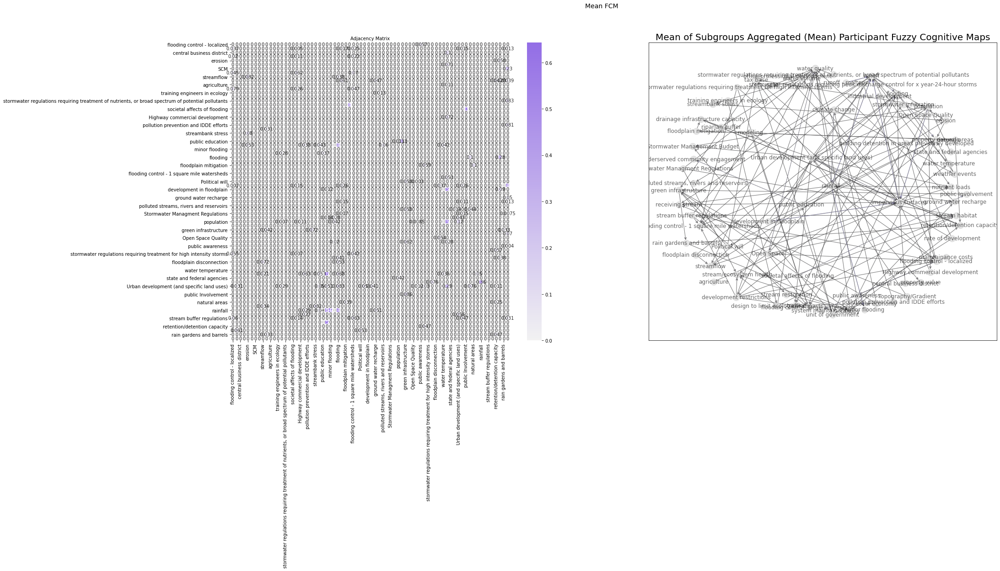

In [ ]:
fig, (ax, ax1) = plt.subplots(1,2,figsize=(30,12))
plt.suptitle('Mean FCM', fontsize=14)
ax.set_title("Adjacency Matrix", fontsize=10)

sns.heatmap(df_matrix, annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
ax1.set_title("Mean of Subgroups Aggregated (Mean) Participant Fuzzy Cognitive Maps", fontsize=20)
generate_map(df_matrix.to_numpy(), df_matrix.index,ax1)
plt.savefig('./FCMs/FCM-Combined-Mean')

### FCM Concepts -> Geospatial Simulation/Model 

> Send back to stakeholders for other modeling suggestions

- Water Quality: Kims project?
- Urban Development: FUTURES
- Natural Areas: FUTURES
- Rainfall: 
- Runoff: SIMWE
- Erosion: SIMWE
- Population: FUTURES 
- Flooding: HAND
- Impervious Surfaces: FUTURES
- Property Damage:
- Retention/Detention Capacity:
- Climate Change:
- Traffic (Transportation):

### References

Özesmi, U., & Özesmi, S. L. (2004). Ecological models based on people’s knowledge: a multi-step fuzzy cognitive mapping approach. Ecological Modelling, 176(1), 43–64. https://doi.org/10.1016/j.ecolmodel.2003.10.027


## Scenarios

In [ ]:
!git clone https://github.com/tomorrownow/PyFCM.git

# Survey123

In [ ]:

import matplotlib.pyplot as plt; plt.rcdefaults()
import matplotlib.pyplot as plt
import seaborn as sns
import os
import numpy as np
os.environ['PATH'] += ":/root/.local/bin"

!pip install geopandas
import geopandas as gpd

!pip install esri2gpd
from arcgis2geojson import arcgis2geojson

!pip install libpysal
import libpysal as lps

# !pip install spaghetti
# import spaghetti
!pip install mplleaflet



     |████████████████████████████████| 1.0MB 13.0MB/s 
     |████████████████████████████████| 6.5MB 43.9MB/s 
     |████████████████████████████████| 15.3MB 237kB/s 
  Created wheel for esri2gpd: filename=esri2gpd-1.0.7-cp37-none-any.whl size=3704 sha256=29e683f738f28cf99b105891b42b5b8f94a7261c4a4b3f0eff15c1e0828cdb95
  Stored in directory: /root/.cache/pip/wheels/5f/f2/e6/1a6ab2e117077f0eefe6132481857d54ae3948dc6c3644ddcb
Successfully built esri2gpd
     |████████████████████████████████| 2.4MB 9.4MB/s 
  Created wheel for mplleaflet: filename=mplleaflet-0.0.5-cp37-none-any.whl size=28556 sha256=329919b25d96d4faaf39ca4826e7ae80922d5171c3ff120cda76efb17ba246c8
  Stored in directory: /root/.cache/pip/wheels/bf/fd/0b/0513de62c339c4a56e2234aa42a5d06e6660a4446fdae7b796
Successfully built mplleaflet


In [ ]:
featureService = "https://services1.arcgis.com/aT1T0pU1ZdpuDk1t/arcgis/rest/services/survey123_571499fe84ac4125abe48b793b9970a3_stakeholder/FeatureServer/0/query"
# # defining a params dict for the parameters to be sent to the API 
PARAMS = {
    'f':'json',
    'returnGeometry': 'true',
    'inSR': 102100,
    'outFields':'*',
    'outSR': 3857, #3358, #3358 NC NAD83, 3857 Web Mercator
    'where':"CreationDate>=DATE '2019-04-12' AND CreationDate<=DATE '2019-04-13'"
} 
# sending get request and saving the response as response object 
import requests
r = requests.get(url = featureService, params = PARAMS) 

# extracting data in json format 
data = r.json() 
geojson = [arcgis2geojson(f) for f in data["features"]]
df_survey = gpd.GeoDataFrame.from_features(geojson, crs={"init": "epsg:3857"})

df_survey.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 31 entries, 0 to 30
Data columns (total 25 columns):
 #   Column                                 Non-Null Count  Dtype   
---  ------                                 --------------  -----   
 0   geometry                               31 non-null     geometry
 1   ObjectId                               31 non-null     int64   
 2   globalid                               31 non-null     object  
 3   CreationDate                           31 non-null     int64   
 4   Creator                                31 non-null     object  
 5   EditDate                               31 non-null     int64   
 6   Editor                                 31 non-null     object  
 7   why_is_this_location_a_problem         31 non-null     object  
 8   when_will_this_problem_exist_          31 non-null     object  
 9   how_serious_is_this_issue              0 non-null      object  
 10  what_is_the_greatest_barrier_to        31 non-null     o

/usr/local/lib/python3.7/dist-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


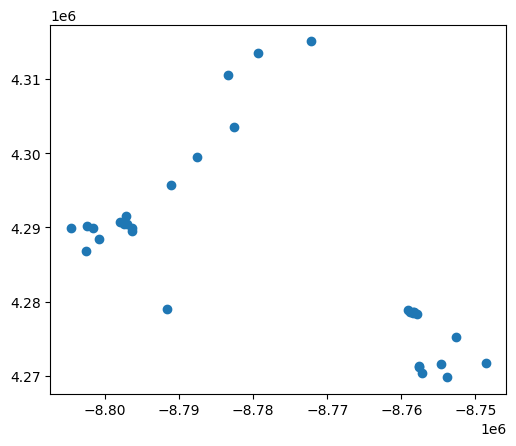

In [ ]:
ax = df_survey.plot()



In [ ]:
df_survey[[
           'CreationDate',
           'why_is_this_location_a_problem',
           'what_is_the_greatest_barrier_to',
           'what_actions_can_be_taken_to_fi',
           'how_challenging_is_this_problem',
           'what_type_of_organization_are_y',
           'when_will_this_problem_exist_',
           'field_19', #Probably Stormwater professional question
           'field_21', # Drive Spatial Scale Question
           'field_22', # Impact Spatial Scale Question
           'how_long',
           'how_often',
           'how_serious_is_this_problem',
           'what_would_the_purpose_of_the_g',
           'what_type_of_game_style_could_b'
          ]].head(5)

df_survey.rename(columns={
    'field_19':'Do you consider yourself a stormwater professional?',
    'field_21':'At what spatial scale does the driver of this problem occur?',
    'field_22':'At what spatial scale does the impact of this problem occur?',
    }, inplace=True)
  

In [ ]:
df_survey.head()

,geometry,ObjectId,globalid,CreationDate,Creator,EditDate,Editor,why_is_this_location_a_problem,when_will_this_problem_exist_,how_serious_is_this_issue,what_is_the_greatest_barrier_to,what_actions_can_be_taken_to_fi,what_type_of_game_style_could_b,what_type_of_organization_are_y,what_type_of_organization_are_y_other,are_you_a_stormwater_profession,Do you consider yourself a stormwater professional?,how_challenging_is_this_problem,At what spatial scale does the driver of this problem occur?,At what spatial scale does the impact of this problem occur?,what_would_the_purpose_of_the_g,field_19_other,how_often,how_long,how_serious_is_this_problem
0,POINT (-8800866.622 4288479.595),37,829b25c7-46ca-4f37-80ca-9c8979b3ff7f,1555090265508,,1555090265508,,This area has undersized stormwater drainage s...,_both,None,Engaging NCDOT to upgrade the infrastructure i...,"Improve infrastructure, model upstream hydrolo...",play_based_eg_sim_city,Government,None,None,no,medium,neighborhood,neighborhood,Training_and_Simulation,None,year,day,somewhat_serious
1,POINT (-8796404.937 4289898.117),38,b7719ecb-57b8-4f7d-801a-a4c167f8d360,1555092479441,,1555092479441,,Confluence of two major streams/drainage basin...,_both,None,Established neighborhoods in this location are...,"Upstream retention/retrofit, community underst...",game_based_eg_pac_man,Government,None,None,no,hard,city,city,"Education,Inform_Policy,Training_and_Simulation",None,year,month,somewhat_serious
2,POINT (-8796400.484 4289590.205),39,47e7237b-0e4c-4f98-8ddd-5ca8ecac2dfe,1555098595808,,1555098595808,,It might not be a problem; it's just that it f...,_both,None,The road is in the wrong place,Block the road,game_based_eg_pac_man,Academia,None,None,no,easy,neighborhood,neighborhood,Inform_Policy,None,month,day,somewhat_unserious
3,POINT (-8758286.917 4278560.607),40,3374edda-92e5-460f-88e7-0ef2ed559b4e,1555098631921,opala_NCSU,1555098631921,opala_NCSU,Flooding after every heavy rain event.,_both,None,I am not sure.,I think that the tributaries feeding into the ...,play_based_eg_sim_city,Academia,None,None,no,medium,neighborhood,city,"Education,Training_and_Simulation",None,year,week,somewhat_serious
4,POINT (-8758469.481 4278489.201),41,3e20e3cc-1e44-49f1-86c8-9a2ddce4e9e8,1555098645546,,1555098645546,,Too much development and impervious surfaces i...,_both,None,Existing development patterns and car-dependen...,Remove housing and smaller scale commercial fr...,game_based_eg_pac_man,"Academia,Government,Other",Citizen,None,no,hard,city,city,"Education,Inform_Policy",None,year,week,serious


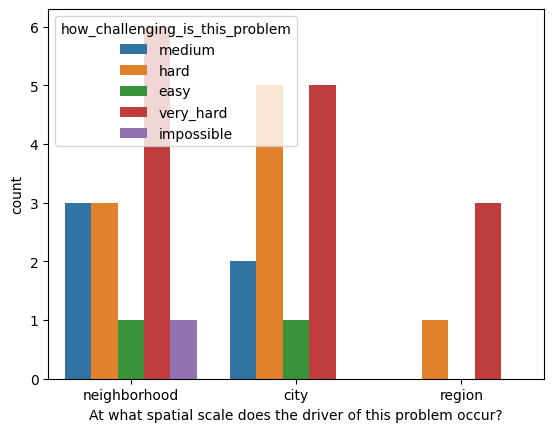

In [ ]:
# fig, (ax1, ax2) = plt.subplots(ncols=2)
sns.countplot(x='At what spatial scale does the driver of this problem occur?',
              hue='how_challenging_is_this_problem',
              data=df_survey, orient='h')


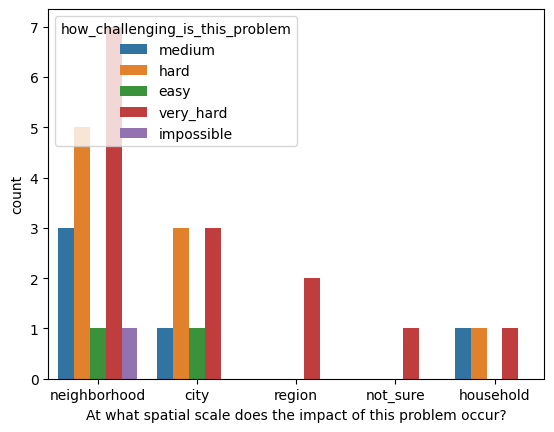

In [ ]:
sns.countplot(x='At what spatial scale does the impact of this problem occur?', hue='how_challenging_is_this_problem',data=df_survey)


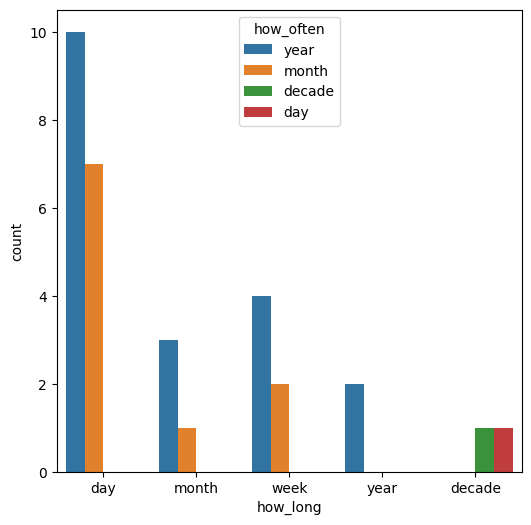

In [ ]:
import matplotlib.pyplot as plt

# Initialize the matplotlib figure
f, ax = plt.subplots(figsize=(6, 6))
sns.countplot(x="how_long", hue="how_often", data=df_survey)



In [ ]:
# time_map = {"day": 0, "week":7, "month": 31,"year": 365, "decade": 365 *10}
time_map = {"day": 0, "week":1, "month": 2,"year": 3, "decade": 4}
df_survey['how_long_scaled'] = df_survey['how_long'].map(time_map)
df_survey['how_often_scaled'] = df_survey['how_often'].map(time_map)

import numpy as np
extent_map = {"household": 0, "neighborhood":1, "city": 2,"region": 3, 'global': 4, 'not_sure': 5}
# extent_map = {"household": 1, "neighborhood":10, "city": 100,"region": 1000, 'global': 10000, 'not_sure': 2}

df_survey['driver_extent_scaled'] = df_survey['At what spatial scale does the driver of this problem occur?'].map(extent_map)
df_survey['impact_extent_scaled'] = df_survey['At what spatial scale does the impact of this problem occur?'].map(extent_map)

likert_scale = {'unserious': -2, 'somewhat_unserious': -1, 'neutral': 0, 'somewhat_serious': 1, 'serious': 2}	
df_survey['serious_scaled'] = df_survey['how_serious_is_this_problem'].map(likert_scale)


challenge_scale = {'solved': 0, 'very': 1, 'easy': 2, 'medium': 3, 'hard': 4, 'very_hard': 5, 'impossible': 6}
df_survey['challenge_scaled'] = df_survey['how_challenging_is_this_problem'].map(challenge_scale)



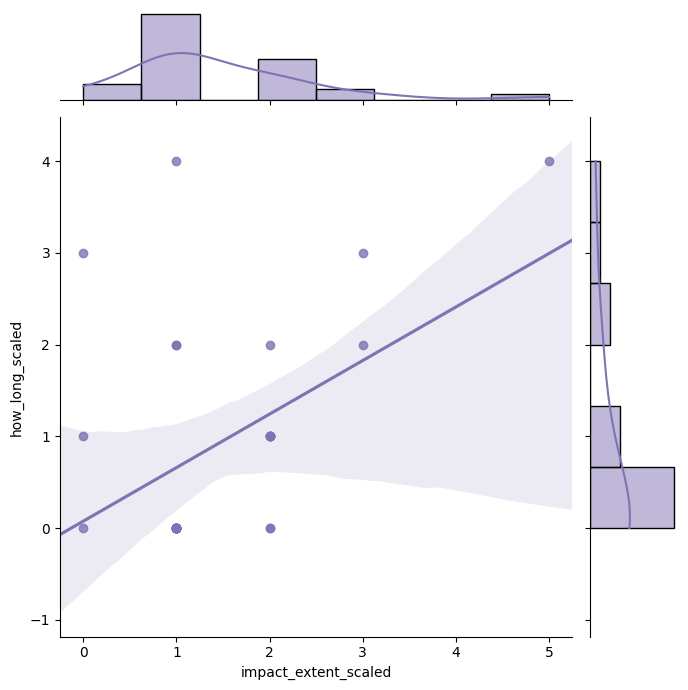

In [ ]:
sns.jointplot(x="impact_extent_scaled", y="how_long_scaled", data=df_survey,
                  kind="reg", truncate=False,
                  color="m", height=7)

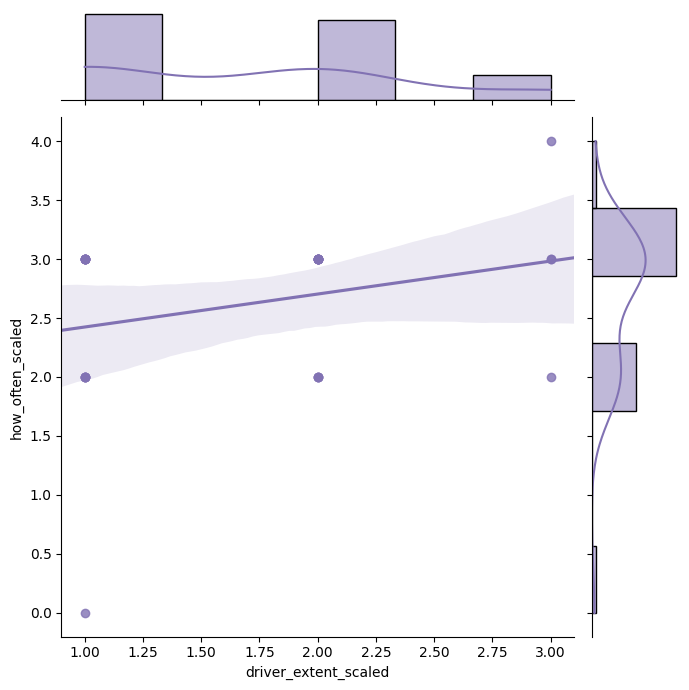

In [ ]:
sns.jointplot(x="driver_extent_scaled", y="how_often_scaled", data=df_survey,
                  kind="reg", truncate=False,
                  color="m", height=7)

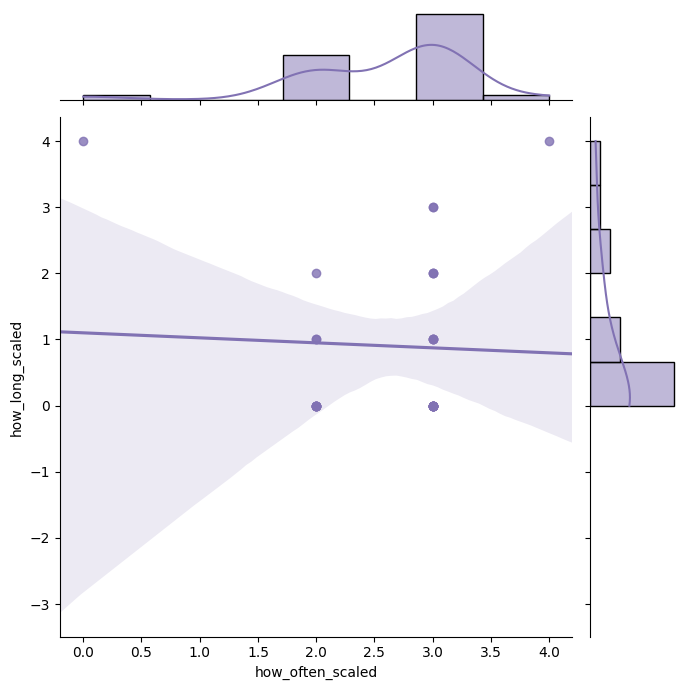

In [ ]:
sns.jointplot(x="how_often_scaled", y="how_long_scaled", data=df_survey,
                  kind="reg", truncate=False,
                  color="m", height=7)


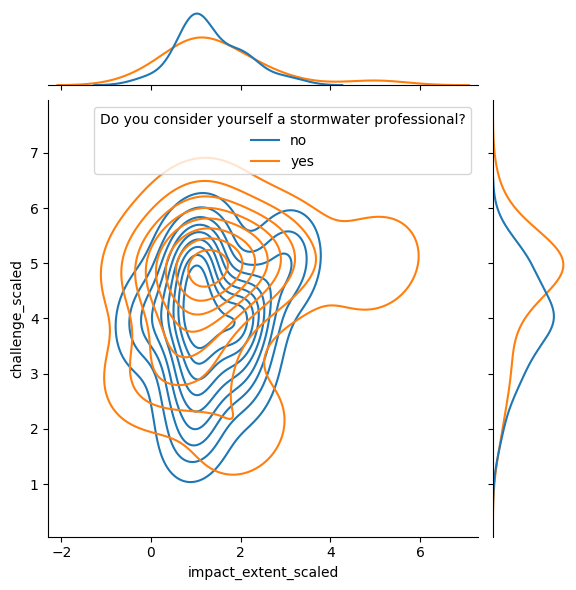

In [ ]:
sns.jointplot(data=df_survey, 
              x="impact_extent_scaled", 
              y="challenge_scaled", 
              kind="kde",
              hue="Do you consider yourself a stormwater professional?")



# sns.jointplot(y="driver_extent_scaled", x="impact_extent_scaled", data=df_survey,
#                   kind="reg", truncate=False,
#                   color="m", height=7)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1078: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1078: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


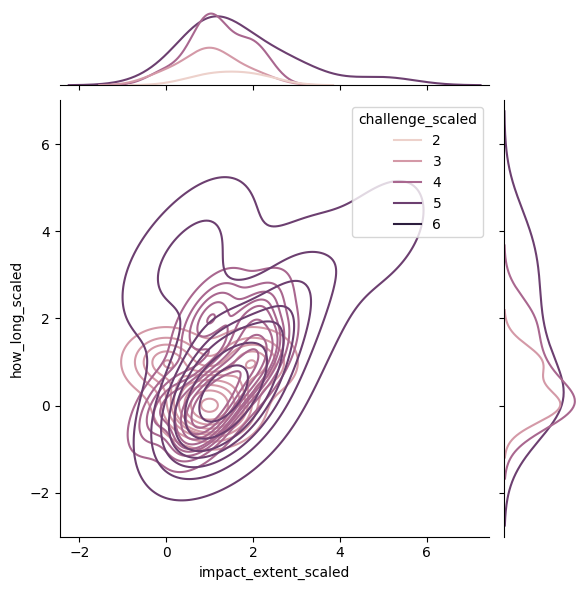

In [ ]:
sns.jointplot(data=df_survey, y="how_long_scaled", 
              x="impact_extent_scaled", kind="kde", 
              hue="challenge_scaled")


LinAlgError: ignored

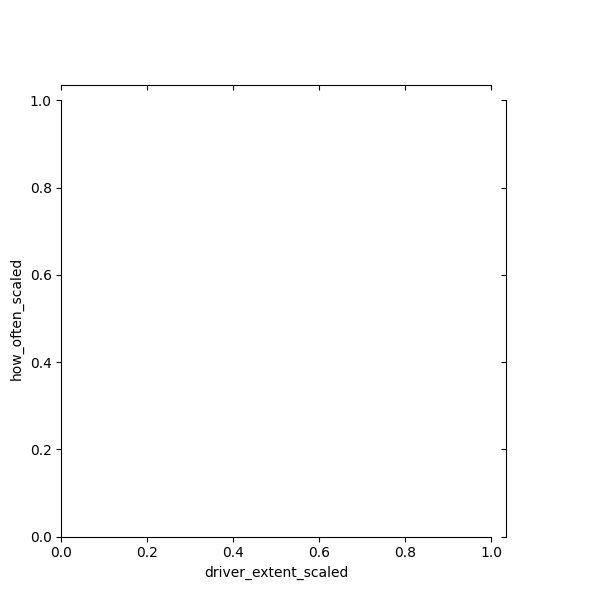

In [ ]:
# sns.jointplot(data=df_survey, 
#               y="how_often_scaled", 
#               x="driver_extent_scaled", 
#               kind="kde", 
#               hue="challenge_scaled")

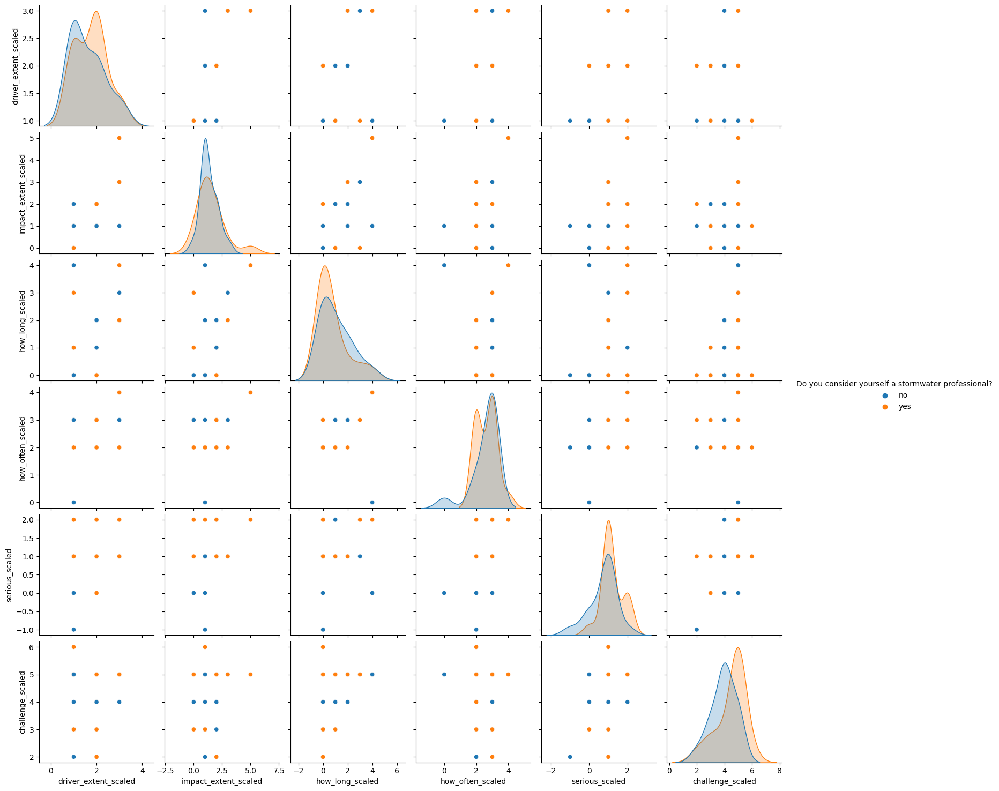

In [ ]:
sns.pairplot(df_survey[[
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']], hue="Do you consider yourself a stormwater professional?")


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning

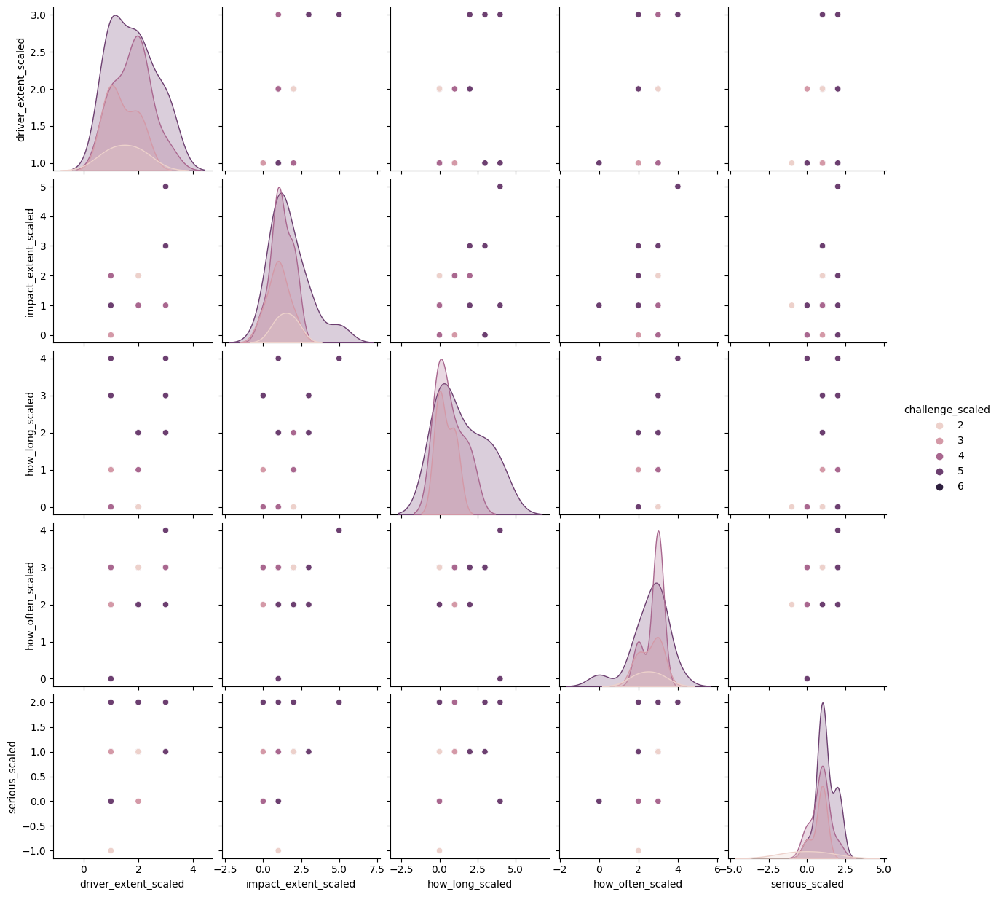

In [ ]:
sns.pairplot(df_survey[[
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']], 
             hue="challenge_scaled")


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


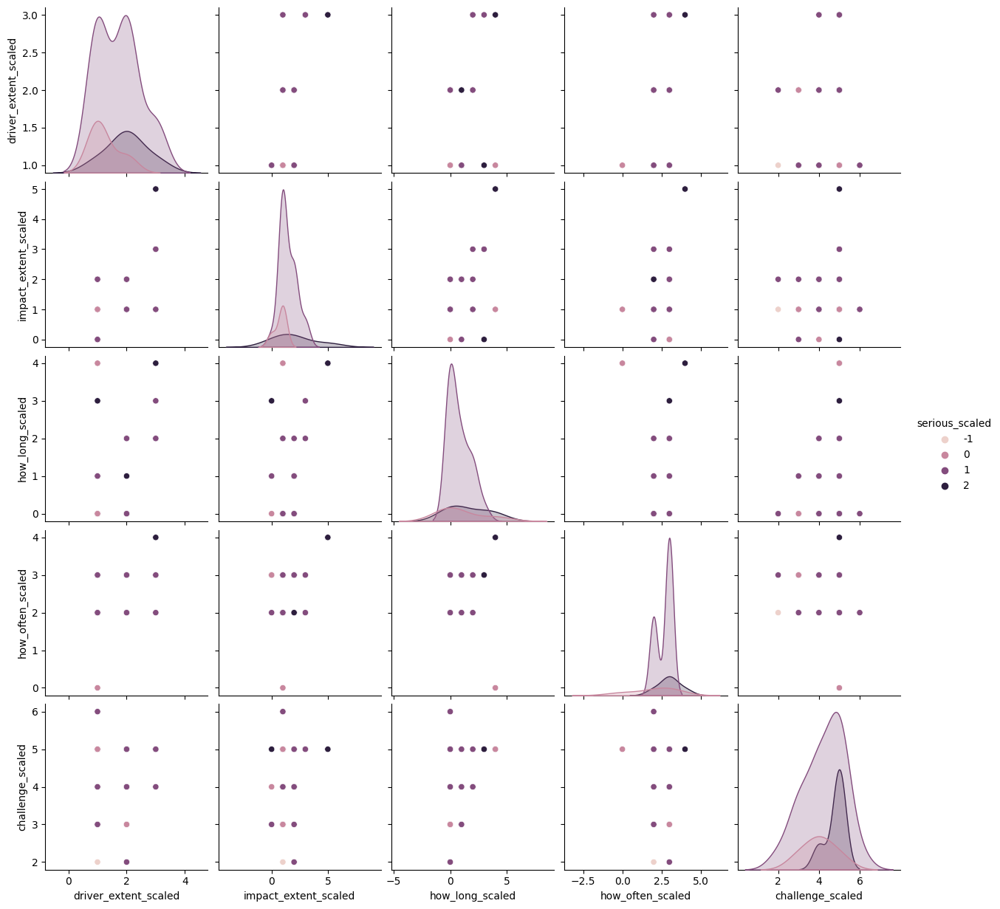

In [ ]:
sns.pairplot(df_survey[[
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']], 
             hue="serious_scaled")

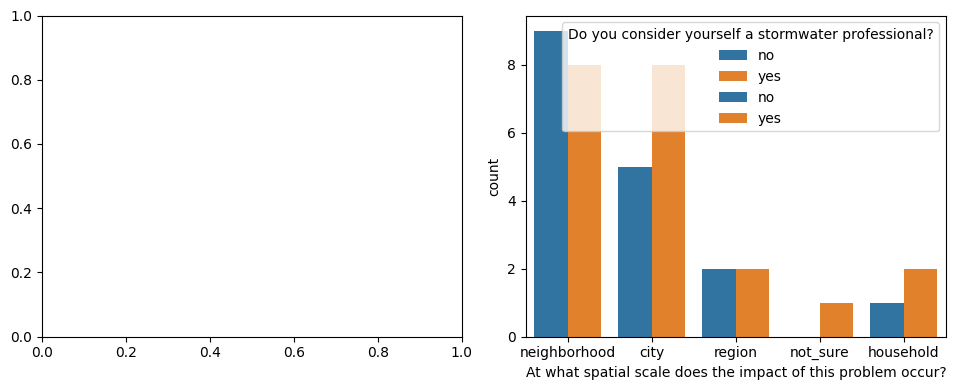

In [ ]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(10,4)) 

ax1 = sns.countplot(x='At what spatial scale does the driver of this problem occur?',
              hue='Do you consider yourself a stormwater professional?',
              data=df_survey)

ax2 = sns.countplot(x='At what spatial scale does the impact of this problem occur?',
              hue='Do you consider yourself a stormwater professional?',
              data=df_survey)

plt.tight_layout()

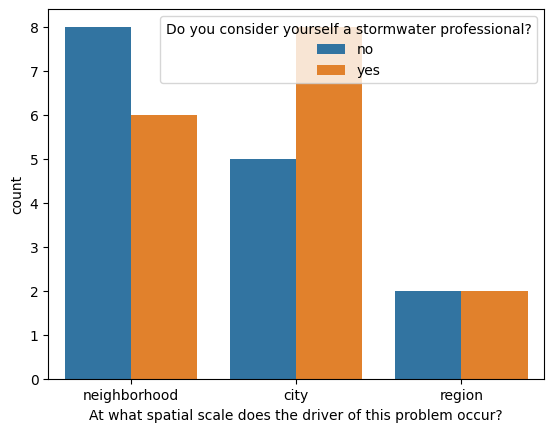

In [ ]:
sns.countplot(x='At what spatial scale does the driver of this problem occur?',
              hue='Do you consider yourself a stormwater professional?',
              data=df_survey)



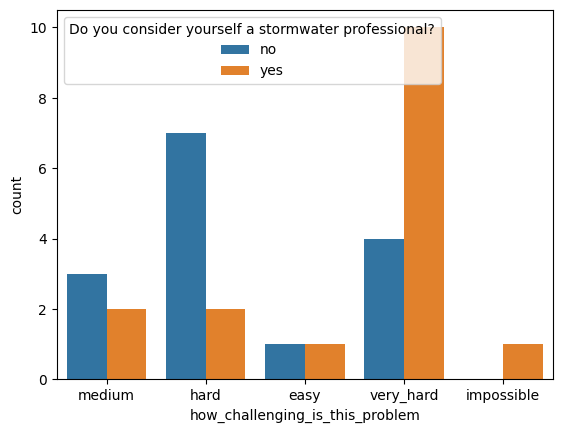

In [ ]:

sns.countplot(x='how_challenging_is_this_problem',
              hue='Do you consider yourself a stormwater professional?',
              data=df_survey)


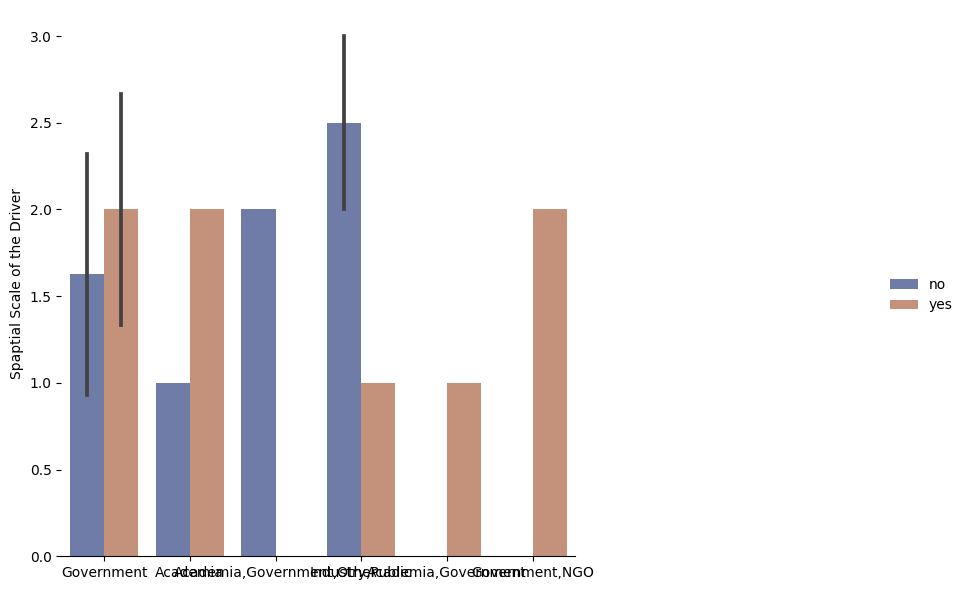

In [ ]:
df_survey_cleaned = df_survey[[
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']]

# Initialize a grid of plots with an Axes for each walk
# sns.FacetGrid(df_survey_cleaned, col="Do you consider yourself a stormwater professional?", hue="Do you consider yourself a stormwater professional?", palette="tab20c")
g = sns.catplot(
    data=df_survey_cleaned, kind="bar",
    x="what_type_of_organization_are_y", y="driver_extent_scaled", hue="Do you consider yourself a stormwater professional?",
    ci="sd", palette="dark", alpha=.6, height=6
)
g.despine(left=True)
g.set_axis_labels("", "Spaptial Scale of the Driver")
g.legend.set_title("")

In [ ]:
import scipy.stats as stats
import statsmodels as sm
df_expert = df_survey_cleaned[df_survey_cleaned['Do you consider yourself a stormwater professional?'] == 'yes']['challenge_scaled']
print("Expert Mean: {}, Count: {}".format(df_expert.mean(), df_expert.count()))
df_genpub = df_survey_cleaned[df_survey_cleaned['Do you consider yourself a stormwater professional?'] == 'no']['challenge_scaled']
print("Gen Pub Mean: {}, Count: {}".format(df_genpub.mean(), df_genpub.count()))
stats.weightstats.ztest(x1=df_expert,x2=df_genpub)

Expert Mean: 4.5, Count: 16
Gen Pub Mean: 3.933333333333333, Count: 15


AttributeError: ignored

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning

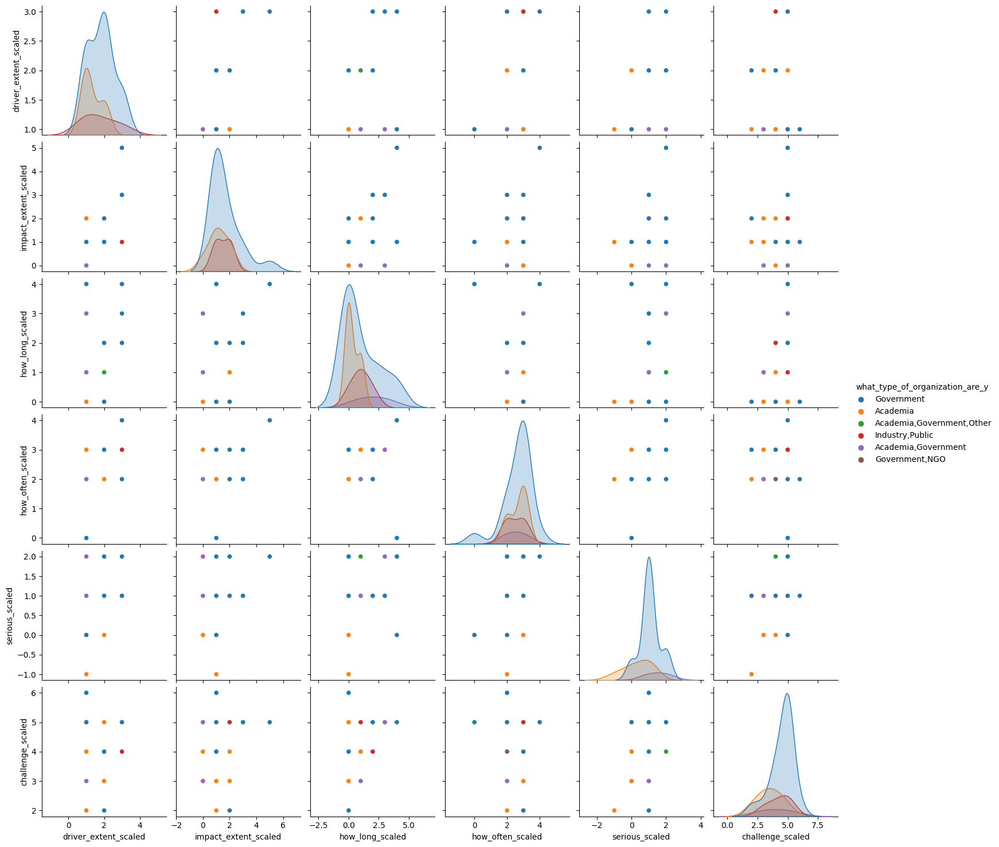

In [ ]:
sns.pairplot(df_survey[[
                            'driver_extent_scaled',
                            'impact_extent_scaled',
                            'how_long_scaled', 
                            'how_often_scaled',
                            'serious_scaled',
                            'challenge_scaled',
                            'what_type_of_organization_are_y',
                            'Do you consider yourself a stormwater professional?']], hue="what_type_of_organization_are_y")

## Create Wordcloud

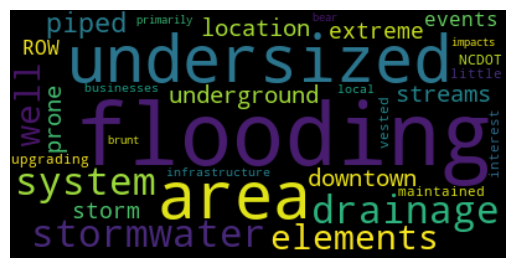

In [ ]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

# Start with one review:
text = df_survey['why_is_this_location_a_problem'][0]

# Create and generate a word cloud image:
wordcloud = WordCloud().generate(text)

# Display the generated image:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# wordcloud.to_file("img/first_review.png")


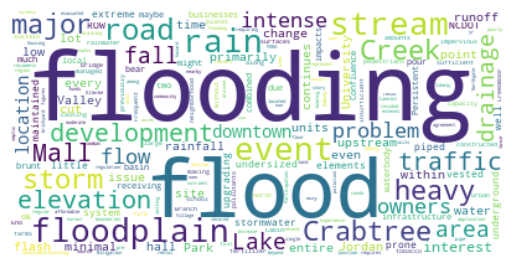

In [ ]:
problem_text = " ".join(review for review in df_survey['why_is_this_location_a_problem'])
# barrier_text = " ".join(review for review in df_survey['what_is_the_greatest_barrier_to'])
# solution_text = " ".join(review for review in df_survey['what_actions_can_be_taken_to_fi'])
# problem_text = problem_text.replace("flood", "flooding")
import re
# problem_text = re.sub(r'\bflood\b', 'flooding', problem_text)
# Create stopword list:
# stopwords = set(STOPWORDS)
# stopwords.update(["drink", "now", "wine", "flavor", "flavors"])

# Generate a word cloud image
problem_wordcloud = WordCloud(background_color="white").generate(problem_text)
# barrier_wordcloud = WordCloud(background_color="white").generate(barrier_text)
# solution_wordcloud = WordCloud(background_color="white").generate(solution_text)

# Display the generated image:
# the matplotlib way:
plt.imshow(problem_wordcloud, interpolation='bilinear')
# plt.imshow(barrier_wordcloud, interpolation='bilinear')
# plt.imshow(solution_wordcloud, interpolation='bilinear')

plt.axis("off")
plt.show()


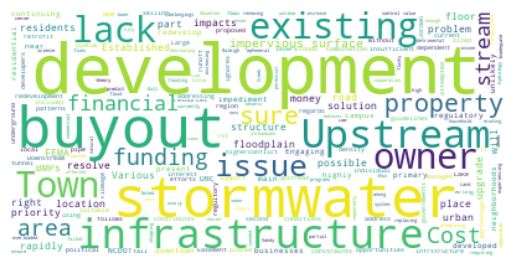

In [ ]:
problem_text = " ".join(review for review in df_survey['why_is_this_location_a_problem'])
barrier_text = " ".join(review for review in df_survey['what_is_the_greatest_barrier_to'])
solution_text = " ".join(review for review in df_survey['what_actions_can_be_taken_to_fi'])

# Create stopword list:
# stopwords = set(STOPWORDS)
# stopwords.update(["drink", "now", "wine", "flavor", "flavors"])
barrier_text = re.sub(r'\bflood\b', 'flooding', problem_text)
# Generate a word cloud image
# problem_wordcloud = WordCloud(background_color="white").generate(problem_text)
barrier_wordcloud = WordCloud(background_color="white").generate(barrier_text)
# solution_wordcloud = WordCloud(background_color="white").generate(solution_text)

# Display the generated image:
# the matplotlib way:
# plt.imshow(problem_wordcloud, interpolation='bilinear')
plt.imshow(barrier_wordcloud, interpolation='bilinear')
# plt.imshow(solution_wordcloud, interpolation='bilinear')

plt.axis("off")
plt.show()


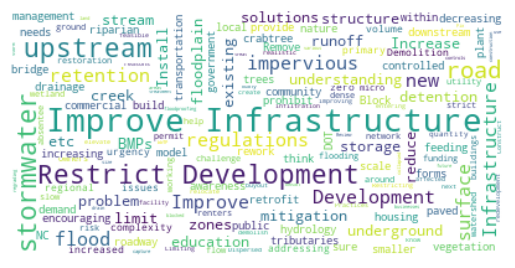

In [ ]:
solution_text = " ".join(review for review in df_survey['what_actions_can_be_taken_to_fi'])

# Generate a word cloud image
solution_wordcloud = WordCloud(background_color="white").generate(solution_text)

# Display the generated image:
# the matplotlib way:

plt.imshow(solution_wordcloud, interpolation='bilinear')

plt.axis("off")
plt.show()


# FCM from spatial Point

# Function: generate_spatial_fcm

In [ ]:
def generate_spatial_fcm(text, ofcm):
  wordcloud = WordCloud(background_color="white").generate(text)
  filtered_concepts = ofcm.index
  print("Total Original Original Concepts: {}".format(len(filtered_concepts)))
  # Display the generated image:
  # the matplotlib way:
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis("off")
  plt.show()
  special_words = ["urban development", "development", "rainfall"]
  spatial_drop_list = []
  for c in filtered_concepts:
    # concept_map
    text_count = text.count(c)
    
    
    # text_count = re.findall(c, text) 
    print("{}: {}".format(c, text_count))
    if text_count == 0:
      # Check mapped variations of word to see if they work
      for key, value in concept_map.items():  # for name, age in dictionary.iteritems():  (for Python 2.x)
        if value == c:
          text_count += text.count(key)
          print("Mapped {} to {}: {}".format(key, c, text_count))

    if text_count == 0:
      spatial_drop_list.append(c)

  print(spatial_drop_list)
  df_agg_mean_spatial = ofcm.drop(columns=spatial_drop_list, index=spatial_drop_list)

  
# df_agg_mean_reduced= pd.DataFrame(Adj_aggregated_FCM, index=filtered_concepts, columns=filtered_concepts)
# df_agg_mean_reduced = remove_weak_connections(df_agg_mean, threshold=0.0) #0.045
# df_agg_mean_reduced.to_csv(path_or_buf=os.path.join(save_location, "mean_stakeholders_combined_fcm_filtered_lt_1.csv"), index=True)

  fig, (ax, ax1) = plt.subplots(1,2,figsize=(40,20))#w, h
  plt.suptitle('Spatial', fontsize=20)
  ax.set_title("Adjacency Matrix", fontsize=20)
  ax.set_xticklabels(ax.get_xmajorticklabels(), fontsize = 18)
  ax.set_yticklabels(ax.get_ymajorticklabels(), fontsize = 18)
  sns.heatmap(df_agg_mean_spatial.fillna(0), annot=True, linewidths=.5, ax=ax, center=0,cmap=cmap)
  ax1.set_title("Social Spatial Fuzzy Congintive Map", fontsize=20)
  fig.subplots_adjust(bottom=0.15)
  fcm_stats = generate_map(df_agg_mean_spatial.to_numpy(), df_agg_mean_spatial.index,ax1)
  print(fcm_stats)



### Using filtered variables

Total Original Original Concepts: 43


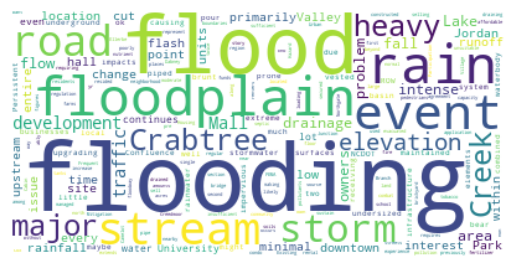

flooding: 9
impervious surfaces: 1
rainfall: 2
runoff: 2
Urban development with specific land uses: 0
Mapped urban development to Urban development with specific land uses: 0
Mapped development to Urban development with specific land uses: 4
Mapped urbanization to Urban development with specific land uses: 4
water quality: 1
property damage: 0
Mapped property damage to property damage: 0
Open Space: 0
Mapped open space to Open Space: 0
Mapped pervious area to Open Space: 0
Mapped urban parks/greenspace to Open Space: 0
Mapped land conservation areas to Open Space: 0
Mapped land preservation to Open Space: 0
climate change: 0
Mapped climate change to climate change: 0
retention/detention capacity: 0
Mapped retention/detention capacity to retention/detention capacity: 0
Mapped capacity of stormwater infrastructure as designed to retention/detention capacity: 0
erosion: 1
stream/ecosystem health: 0
Mapped macroinvertebrates to stream/ecosystem health: 0
Mapped ecosystem health to stream/e

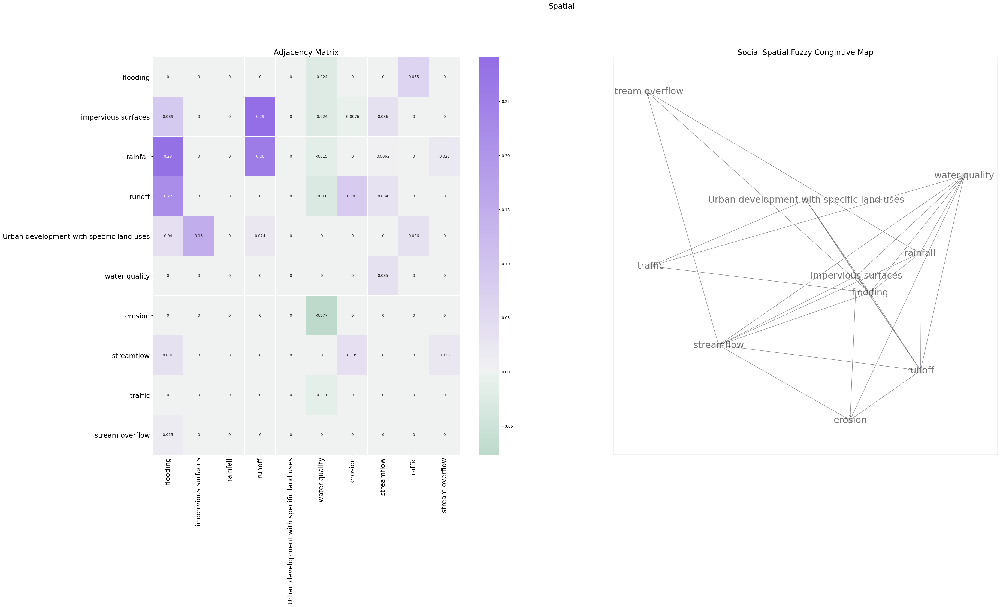

In [ ]:
generate_spatial_fcm(problem_text,df_agg_mean_original)

Total Original Original Concepts: 43


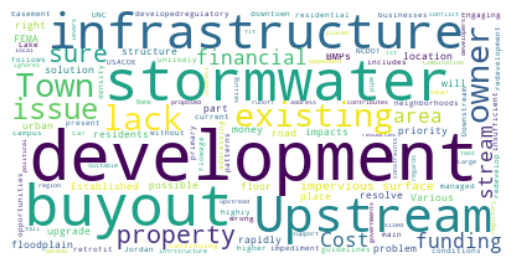

flooding: 1
impervious surfaces: 0
Mapped impervious surfaces to impervious surfaces: 0
rainfall: 0
Mapped rainfall to rainfall: 0
runoff: 1
Urban development with specific land uses: 0
Mapped urban development to Urban development with specific land uses: 1
Mapped development to Urban development with specific land uses: 8
Mapped urbanization to Urban development with specific land uses: 8
water quality: 0
Mapped water quality to water quality: 0
property damage: 0
Mapped property damage to property damage: 0
Open Space: 0
Mapped open space to Open Space: 0
Mapped pervious area to Open Space: 0
Mapped urban parks/greenspace to Open Space: 0
Mapped land conservation areas to Open Space: 0
Mapped land preservation to Open Space: 0
climate change: 0
Mapped climate change to climate change: 0
retention/detention capacity: 0
Mapped retention/detention capacity to retention/detention capacity: 0
Mapped capacity of stormwater infrastructure as designed to retention/detention capacity: 0
eros

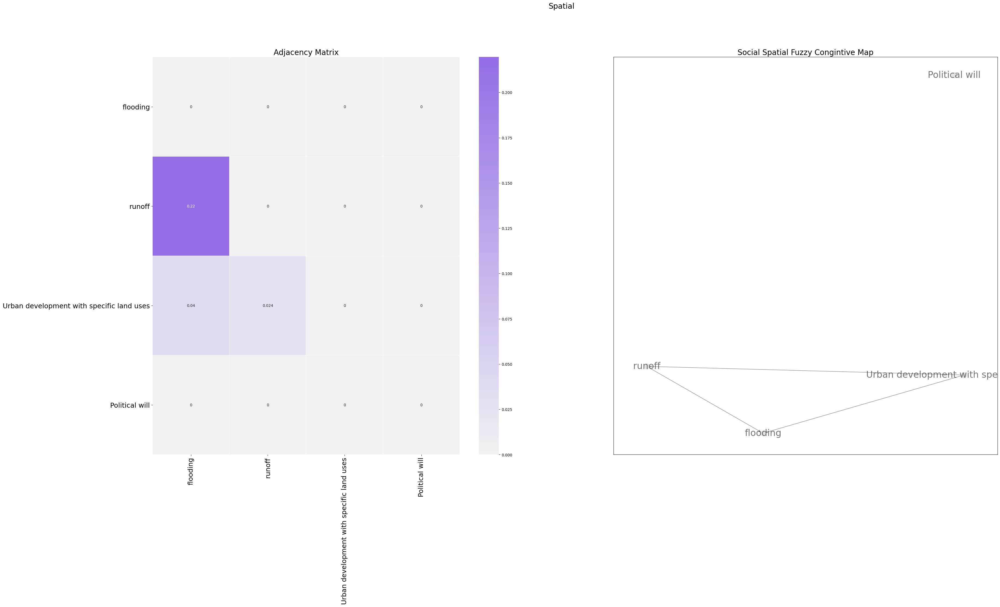

In [ ]:
generate_spatial_fcm(barrier_text,df_agg_mean_original)

Total Original Original Concepts: 43


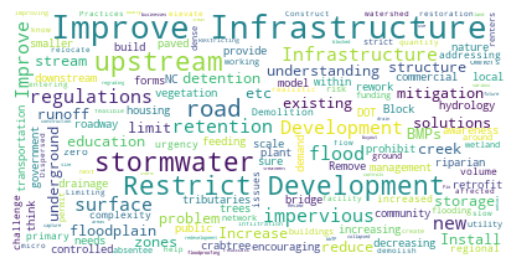

flooding: 1
impervious surfaces: 0
Mapped impervious surfaces to impervious surfaces: 0
rainfall: 0
Mapped rainfall to rainfall: 0
runoff: 2
Urban development with specific land uses: 0
Mapped urban development to Urban development with specific land uses: 0
Mapped development to Urban development with specific land uses: 4
Mapped urbanization to Urban development with specific land uses: 4
water quality: 0
Mapped water quality to water quality: 0
property damage: 0
Mapped property damage to property damage: 0
Open Space: 0
Mapped open space to Open Space: 0
Mapped pervious area to Open Space: 0
Mapped urban parks/greenspace to Open Space: 0
Mapped land conservation areas to Open Space: 0
Mapped land preservation to Open Space: 0
climate change: 0
Mapped climate change to climate change: 0
retention/detention capacity: 0
Mapped retention/detention capacity to retention/detention capacity: 0
Mapped capacity of stormwater infrastructure as designed to retention/detention capacity: 0
eros

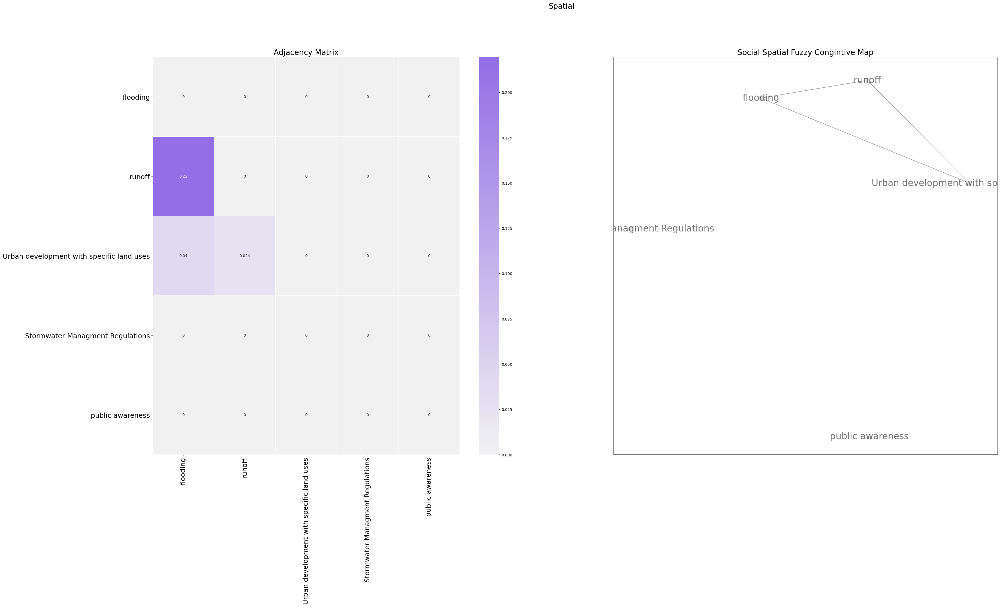

In [ ]:
generate_spatial_fcm(solution_text,df_agg_mean_original)

### Using All Variables

Total Original Original Concepts: 126


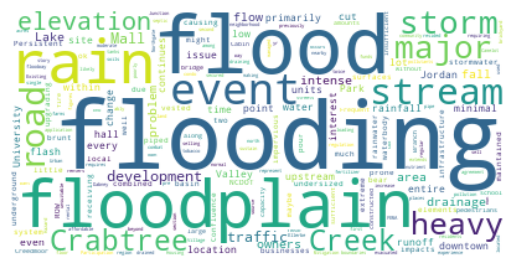

rainfall: 2
impervious surfaces: 1
riparian buffer: 0
Mapped riparian buffer to riparian buffer: 0
Open Space: 0
Mapped open space to Open Space: 0
Mapped pervious area to Open Space: 0
Mapped urban parks/greenspace to Open Space: 0
Mapped land conservation areas to Open Space: 0
Mapped land preservation to Open Space: 0
flooding: 9
SCM: 0
Mapped SCMs to SCM: 0
Mapped best management practices to SCM: 0
Mapped treatment acres of stormwater wet/dry ponds or BMPs to SCM: 0
Mapped dispersed stormwater practices to SCM: 0
Mapped erosion and sedimentation control to SCM: 0
nutrient loads: 0
Mapped nutrient loads to nutrient loads: 0
population growth: 0
Mapped population growth to population growth: 0
Urban development with specific land uses: 0
Mapped urban development to Urban development with specific land uses: 0
Mapped development to Urban development with specific land uses: 4
Mapped urbanization to Urban development with specific land uses: 4
water quality: 1
runoff: 2
property damag

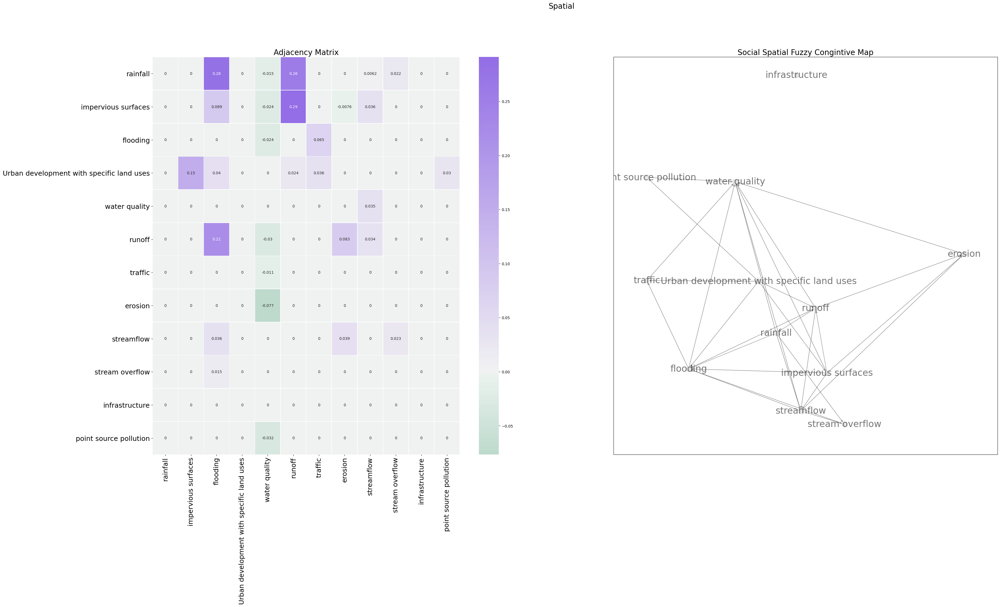

In [ ]:
generate_spatial_fcm(problem_text,df_agg_mean)

Total Original Original Concepts: 126


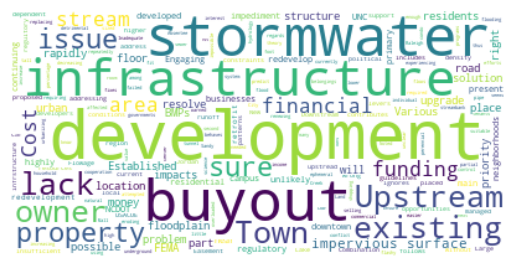

rainfall: 0
Mapped rainfall to rainfall: 0
impervious surfaces: 0
Mapped impervious surfaces to impervious surfaces: 0
riparian buffer: 0
Mapped riparian buffer to riparian buffer: 0
Open Space: 0
Mapped open space to Open Space: 0
Mapped pervious area to Open Space: 0
Mapped urban parks/greenspace to Open Space: 0
Mapped land conservation areas to Open Space: 0
Mapped land preservation to Open Space: 0
flooding: 1
SCM: 0
Mapped SCMs to SCM: 0
Mapped best management practices to SCM: 0
Mapped treatment acres of stormwater wet/dry ponds or BMPs to SCM: 0
Mapped dispersed stormwater practices to SCM: 0
Mapped erosion and sedimentation control to SCM: 0
nutrient loads: 0
Mapped nutrient loads to nutrient loads: 0
population growth: 0
Mapped population growth to population growth: 0
Urban development with specific land uses: 0
Mapped urban development to Urban development with specific land uses: 1
Mapped development to Urban development with specific land uses: 8
Mapped urbanization to Ur

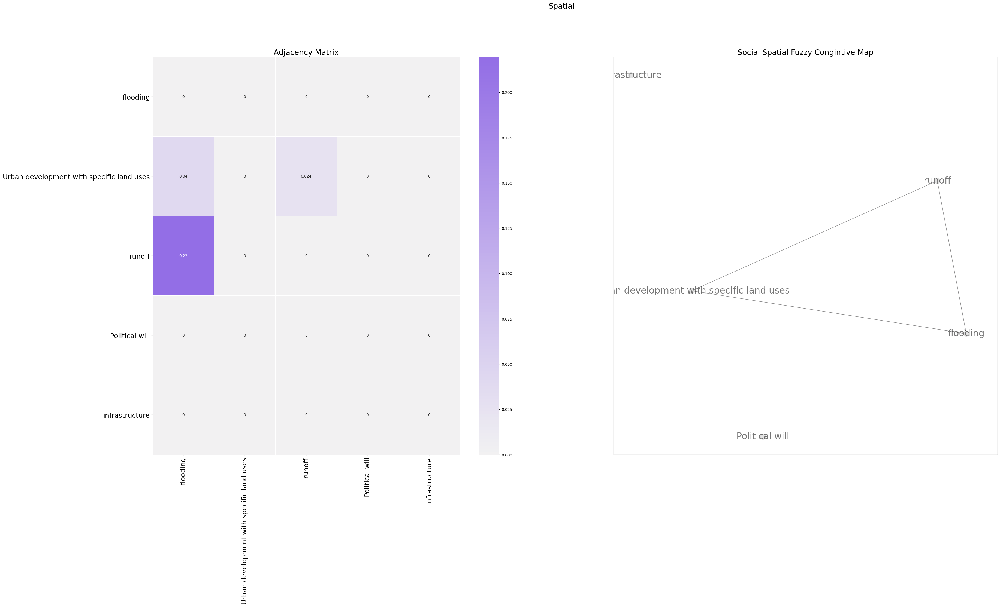

In [ ]:

generate_spatial_fcm(barrier_text,df_agg_mean)

Total Original Original Concepts: 126


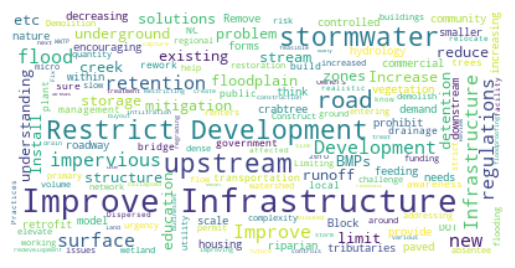

rainfall: 0
Mapped rainfall to rainfall: 0
impervious surfaces: 0
Mapped impervious surfaces to impervious surfaces: 0
riparian buffer: 0
Mapped riparian buffer to riparian buffer: 0
Open Space: 0
Mapped open space to Open Space: 0
Mapped pervious area to Open Space: 0
Mapped urban parks/greenspace to Open Space: 0
Mapped land conservation areas to Open Space: 0
Mapped land preservation to Open Space: 0
flooding: 1
SCM: 0
Mapped SCMs to SCM: 0
Mapped best management practices to SCM: 0
Mapped treatment acres of stormwater wet/dry ponds or BMPs to SCM: 0
Mapped dispersed stormwater practices to SCM: 0
Mapped erosion and sedimentation control to SCM: 0
nutrient loads: 0
Mapped nutrient loads to nutrient loads: 0
population growth: 0
Mapped population growth to population growth: 0
Urban development with specific land uses: 0
Mapped urban development to Urban development with specific land uses: 0
Mapped development to Urban development with specific land uses: 4
Mapped urbanization to Ur

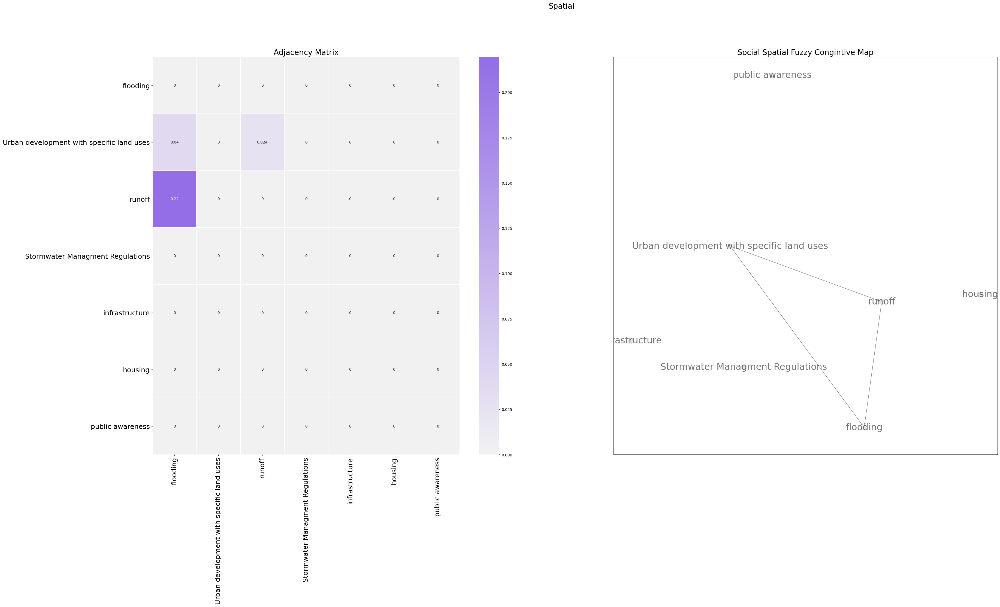

In [ ]:
generate_spatial_fcm(solution_text,df_agg_mean)

Total Original Original Concepts: 126


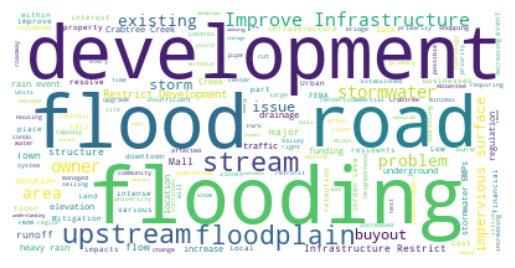

rainfall: 2
impervious surfaces: 1
riparian buffer: 0
Mapped riparian buffer to riparian buffer: 0
Open Space: 0
Mapped open space to Open Space: 0
Mapped pervious area to Open Space: 0
Mapped urban parks/greenspace to Open Space: 0
Mapped land conservation areas to Open Space: 0
Mapped land preservation to Open Space: 0
flooding: 11
SCM: 0
Mapped SCMs to SCM: 0
Mapped best management practices to SCM: 0
Mapped treatment acres of stormwater wet/dry ponds or BMPs to SCM: 0
Mapped dispersed stormwater practices to SCM: 0
Mapped erosion and sedimentation control to SCM: 0
nutrient loads: 0
Mapped nutrient loads to nutrient loads: 0
population growth: 0
Mapped population growth to population growth: 0
Urban development with specific land uses: 0
Mapped urban development to Urban development with specific land uses: 1
Mapped development to Urban development with specific land uses: 16
Mapped urbanization to Urban development with specific land uses: 16
water quality: 1
runoff: 5
property da

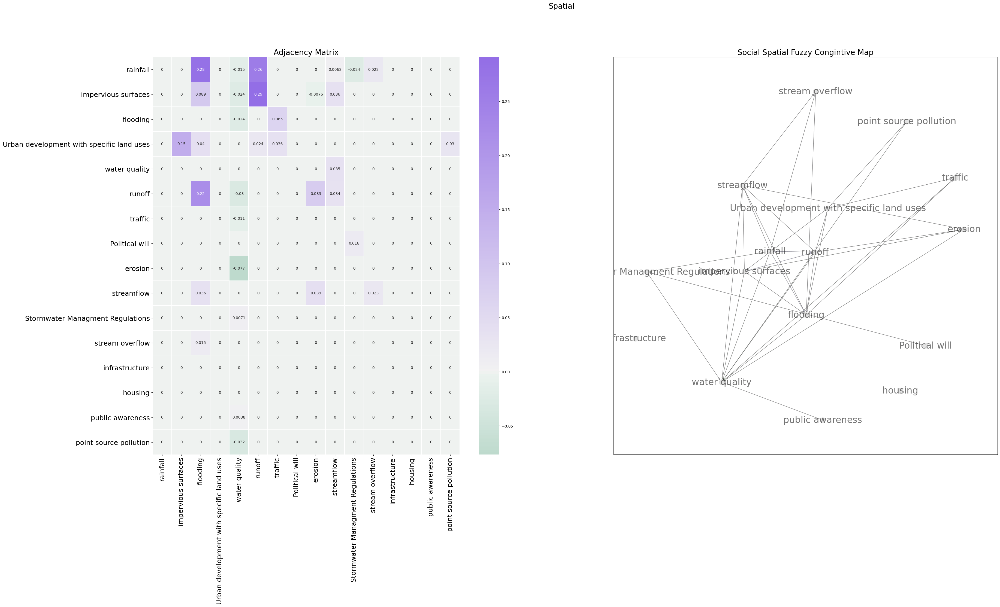

In [ ]:
problem_barrier_solution_text = problem_text + " " + barrier_text + " " + solution_text
generate_spatial_fcm(problem_barrier_solution_text,df_agg_mean)

In [ ]:
%%bash
MINICONDA_INSTALLER_SCRIPT=Miniconda3-4.5.4-Linux-x86_64.sh
MINICONDA_PREFIX=/usr/local
wget https://repo.continuum.io/miniconda/$MINICONDA_INSTALLER_SCRIPT
chmod +x $MINICONDA_INSTALLER_SCRIPT
./$MINICONDA_INSTALLER_SCRIPT -b -f -p $MINICONDA_PREFIX

In [ ]:
%%bash
conda install --channel defaults conda python=3.6 --yes
conda update --channel defaults --all --yes

In [ ]:
import sys
_ = (sys.path
        .append("/usr/local/lib/python3.6/site-packages"))

In [ ]:
!conda install geoplot -c conda-forge --yes

In [ ]:
!conda install spaghetti -c conda-forge --yes

In [ ]:
# ntw = spaghetti.Network(in_data="/content/drive/Shared drives/WRRI_FallsJordan/data files/Flowlines/NHDplus_flowlines_piedmont.shp")
import geoplot as gplt
import geoplot.crs as gcrs
import mplleaflet
# extent = gpd.GeoSeries(df_survey['geometry']).convex_hull.
                      
# gplt.kdeplot(df_survey,extent=extent, cmap='viridis', projection=gcrs.WebMercator(), figsize=(12, 12),shade=True)
# gplt.pointplot(df_survey, s=1, color='black', ax=ax)
# gplt.webmap(df_survey, ax=ax, zoom=14,projection=gcrs.WebMercator())
# plt.title('Stakeholder Defined Stormwater Problem Locations, April 2019', fontsize=18)

# fig = plt.gcf()
# plt.savefig("boston-airbnb-kde.png", bbox_inches='tight', pad_inches=0.1)

**bold text**###### 

In [ ]:
!pip install keplergl

In [ ]:
df_survey.crs
df_survey_web = gpd.GeoSeries(df_survey['geometry']).to_crs(epsg="4326")
df_survey_web.crs

In [ ]:
minx, miny, maxx, maxy = df_survey_web.geometry.total_bounds
print(minx, miny, maxx, maxy)

In [ ]:
from scipy import ndimage

import matplotlib.pylab as pylab
import matplotlib.pyplot as plt
import geoplot as gplt
import geoplot.crs as gcrs
import mplleaflet

def heatmap(d, bins=(100,100), smoothing=1.3, cmap='mako'):
    def getx(pt):
        return pt.coords[0][0]

    def gety(pt):
        return pt.coords[0][1]

   
    
    # print(extent)
    minx, miny, maxx, maxy = df_survey_web.geometry.total_bounds
    extent = [minx, miny, maxx, maxy]
    ax = gplt.kdeplot(d,extent=extent, figsize=(12, 12),shade=True,projection=gcrs.WebMercator(),levels=100, cmap="mako",shade_lowest=False,gridsize=200, cut=3)
    gplt.pointplot(d, s=1, color='black', ax=ax)
    gplt.webmap(df_survey,extent=extent, zoom=13, ax=ax)
    plt.title('Stakeholder Defined Stormwater Problem Locations, April 2019', fontsize=18)

    fig = plt.gcf()
    plt.savefig("stormwater-heatmap-kde.png", bbox_inches='tight', pad_inches=0.1)

    # x = list(d.geometry.apply(getx))
    # y = list(d.geometry.apply(gety))

    # heatmap, xedges, yedges = np.histogram2d(y, x, bins=bins)
    # extent = [yedges[0],yedges[-1], xedges[-1],xedges[0]]
    # logheatmap = np.log(heatmap)
    # logheatmap[np.isneginf(logheatmap)] = 0
    # logheatmap = ndimage.filters.gaussian_filter(logheatmap, smoothing, mode='nearest')
    
    # plt.imshow(logheatmap, cmap=cmap, extent=extent)
    # plt.colorbar()
    # plt.gca().invert_yaxis()
    # plt.savefig("stormwater-heatmap-kde.png", bbox_inches='tight', pad_inches=0.1)
    # plt.show()

heatmap(df_survey_web, bins=50, smoothing=1.5)


In [ ]:
ax = heatmap(df_survey, bins=50, smoothing=1.5)
df_survey.plot(ax=ax)
# gplt.pointplot(df_survey, s=1, color='black', ax=ax)
# gplt.webmap(df_survey, ax=ax, zoom=14,projection=gcrs.WebMercator())
plt.title('Stakeholder Defined Stormwater Problem Locations, April 2019', fontsize=18)

fig = plt.gcf()

# PhraseNet

In [ ]:
#https://www.cg.tuwien.ac.at/courses/InfoVis/HallOfFame/2011/Gruppe08/Homepage/code/phrase-nets.zip

!wget https://www.cg.tuwien.ac.at/courses/InfoVis/HallOfFame/2011/Gruppe08/Homepage/code/phrase-nets.zip && unzip phrase-nets.zip


--2020-09-22 15:28:00--  https://www.cg.tuwien.ac.at/courses/InfoVis/HallOfFame/2011/Gruppe08/Homepage/code/phrase-nets.zip
Resolving www.cg.tuwien.ac.at (www.cg.tuwien.ac.at)... 128.130.118.6
Connecting to www.cg.tuwien.ac.at (www.cg.tuwien.ac.at)|128.130.118.6|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 671702 (656K) [application/zip]
Saving to: ‘phrase-nets.zip’

phrase-nets.zip     100%[===================>] 655.96K   468KB/s    in 1.4s    

2020-09-22 15:28:03 (468 KB/s) - ‘phrase-nets.zip’ saved [671702/671702]

Archive:  phrase-nets.zip
   creating: lib/
  inflating: lib/mdsj.jar            
  inflating: lib/jsoup.jar           
  inflating: lib/cli.jar             
  inflating: lib/processing.jar      
  inflating: lib/cue.language.jar    
  inflating: phrase-nets.jar         
  inflating: pride.txt               
  inflating: run.bat                 
  inflating: run.sh                  


In [ ]:
!./run.sh

Starting phrase-nets visualization tool ...
Exception in thread "main" java.awt.HeadlessException: 
No X11 DISPLAY variable was set, but this program performed an operation which requires it.
	at java.desktop/java.awt.GraphicsEnvironment.checkHeadless(GraphicsEnvironment.java:208)
	at java.desktop/java.awt.Window.<init>(Window.java:548)
	at java.desktop/java.awt.Frame.<init>(Frame.java:423)
	at java.desktop/java.awt.Frame.<init>(Frame.java:388)
	at pn.awt.Window.<init>(Unknown Source)
	at pn.Main.main(Unknown Source)


In [ ]:
from google.colab import files

for root, dirs, filez in os.walk("./FCMs", topdown=False):
    for name in filez:
      if "Mean" in name:
        files.download("%s%s" % ("./FCMs/", name))

In [ ]:
files.download("./mean_of_stakeholders_combined_fcm.csv")


In [ ]:
files.download("./combined_model_varibales_academic.png")
files.download("./combined_model_varibales_government.png")

AttributeError: ignored